In [1]:
#!pip install pandas seaborn scikit-learn lmfit mahotas imread
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from Functions.functions import TE_MSD,Michalet,set_size,pool_data
from sklearn.cluster import KMeans
import matplotlib as mpl
import seaborn as sns
import random

%matplotlib inline
%reload_ext autoreload

# Experimental condition
dt = 0.05

# Initial filtering
minframe=10
maxframe=40
rsquared_threshold=-1000

# Small $R_S$

In [2]:
files = ["Data/SM1_INI/tracks135.csv","Data/SM2_INI/tracks135.csv","Data/SM3_INI/tracks135.csv","Data/SM4_INI/tracks135.csv","Data/SM5_INI/tracks135.csv","Data/SM6_INI/tracks135.csv","Data/SM8_INI/tracks135.csv","Data/SM9_INI/tracks135.csv","Data/SM11_INI/tracks135.csv","Data/SM12_INI/tracks135.csv","Data/SM13_INI/tracks135.csv","Data/SM14_INI/tracks135.csv"]
df135 = pool_data(files,dt,minframe,maxframe,rsquared_threshold,fit_option=5)

Parameters for the MSD analysis: dt =  0.05
Initial filters: minframe =  10 , maxframe =  40 , R2 threshold =  -1000
Fit option:  5
Reading filenames in  ['Data/SM1_INI/tracks135.csv', 'Data/SM2_INI/tracks135.csv', 'Data/SM3_INI/tracks135.csv', 'Data/SM4_INI/tracks135.csv', 'Data/SM5_INI/tracks135.csv', 'Data/SM6_INI/tracks135.csv', 'Data/SM8_INI/tracks135.csv', 'Data/SM9_INI/tracks135.csv', 'Data/SM11_INI/tracks135.csv', 'Data/SM12_INI/tracks135.csv', 'Data/SM13_INI/tracks135.csv', 'Data/SM14_INI/tracks135.csv'] ...
Analysis for Data/SM1_INI/tracks135.csv ...
32  tracks were kept out of  5455 . Done.
Analysis for Data/SM2_INI/tracks135.csv ...
61  tracks were kept out of  3511 . Done.
Analysis for Data/SM3_INI/tracks135.csv ...
152  tracks were kept out of  7675 . Done.
Analysis for Data/SM4_INI/tracks135.csv ...
71  tracks were kept out of  4380 . Done.
Analysis for Data/SM5_INI/tracks135.csv ...
28  tracks were kept out of  2289 . Done.
Analysis for Data/SM6_INI/tracks135.csv ...
12

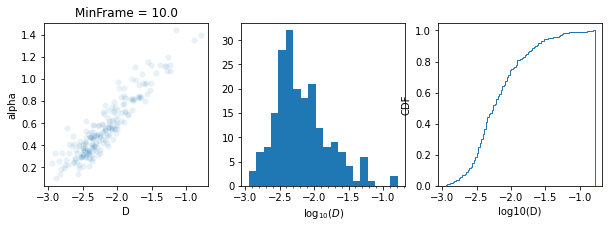

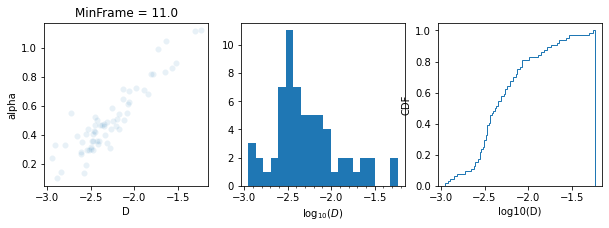

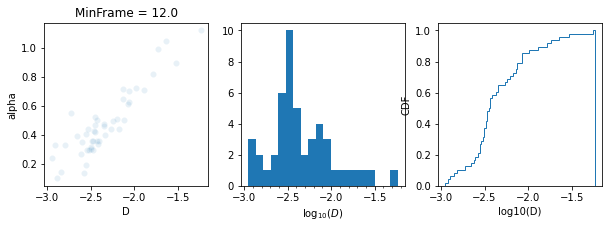

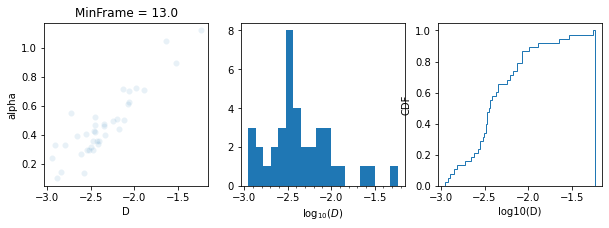

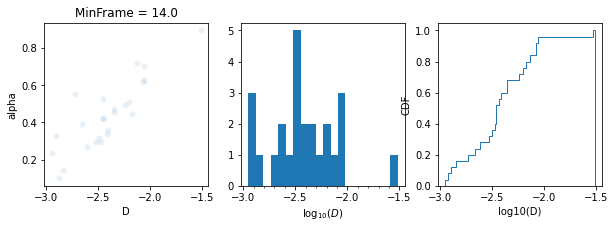

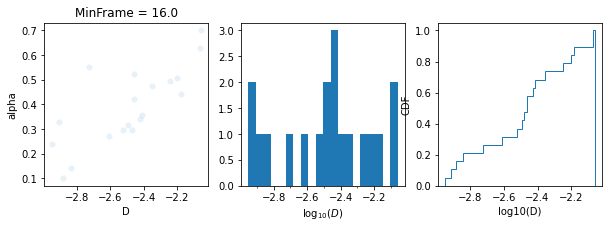

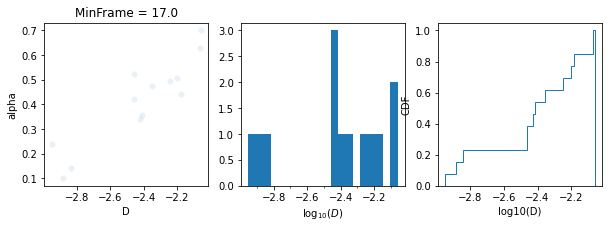

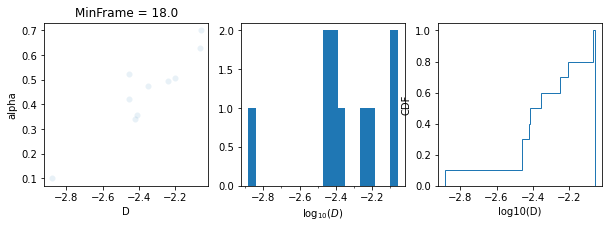

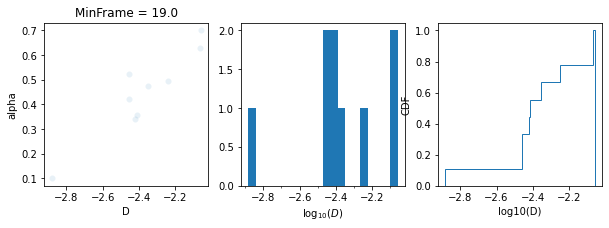

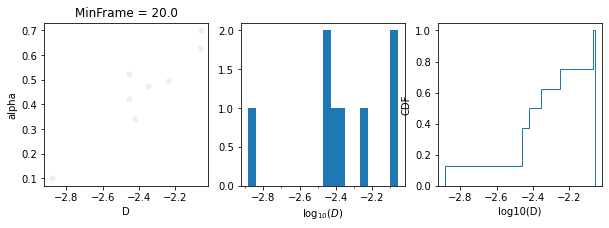

In [3]:
N = np.linspace(minframe,20,10)
for n in N:
    temp1 = df135[(df135['N']>=n) & (df135['R2']>0.5)]
    fig, ax = plt.subplots(1,3,figsize=(10,3))
    
    sns.scatterplot(x='D',y='alpha',data=temp1,ax=ax[0],alpha=0.1)
    ax[0].set_title('MinFrame = '+str(round(n)))
    
    ax[1].hist(temp1['D'],bins=20)
    ax[1].xaxis.set_minor_locator(plt.MultipleLocator(0.1))
    ax[1].set_xlabel(r'log$_{10}(D)$')
    
    ax[2].hist(temp1['D'],bins=100,density=True, histtype='step',cumulative=True)
    ax[2].set_ylabel('CDF')
    ax[2].set_xlabel('log10(D)')

    plt.show()

In [4]:
df135 = df135[(df135['N']>=10) & (df135['R2']>0.5)]
df135.reset_index()
display(df135)

,alpha,D,c,R2,N,x,y,MSD,Filename,spotIDs
1,0.842989,-1.899716,0.423857,0.801625,10,"[47.123999999999995, 47.153999999999996, 47.22...","[19.299, 19.269000000000002, 19.365, 19.366, 1...","[0.004320222222222457, 0.007701000000000515, 0...",Data/SM1_INI/tracks135.csv,"[150550, 151849, 155770, 157035, 158307, 15964..."
4,0.583570,-2.207949,0.233381,0.954245,10,"[56.761, 56.833, 56.766999999999996, 56.708, 5...","[38.580999999999996, 38.556999999999995, 38.57...","[0.00433411111111086, 0.006820374999999739, 0....",Data/SM1_INI/tracks135.csv,"[180948, 184878, 183566, 186129, 187490, 18873..."
11,0.336108,-2.460187,0.144662,0.646272,11,"[58.46, 58.408, 58.375, 58.356, 58.407, 58.433...","[43.176, 43.208999999999996, 43.227, 43.28, 43...","[0.004631399999999633, 0.007248222222222087, 0...",Data/SM1_INI/tracks135.csv,"[308030, 304348, 306800, 305588, 309301, 31174..."
13,0.270986,-2.609380,0.089573,0.672397,16,"[60.053000000000004, 60.093999999999994, 60.04...","[6.882999999999999, 6.939, 6.99, 6.983, 7.044,...","[0.004663800000000143, 0.004608999999999941, 0...",Data/SM1_INI/tracks135.csv,"[314639, 316972, 313451, 315800, 318213, 32060..."
14,0.371496,-2.479818,0.117661,0.613661,10,"[30.066, 30.064, 30.08, 30.119, 30.002, 30.05,...","[6.737, 6.729, 6.747999999999999, 6.78, 6.784,...","[0.005000666666666731, 0.004282874999999966, 0...",Data/SM1_INI/tracks135.csv,"[320601, 319406, 325549, 321873, 323312, 32310..."
...,...,...,...,...,...,...,...,...,...,...
861,0.219144,-2.753316,0.251958,0.782930,10,"[62.148, 62.093999999999994, 62.175, 62.148999...","[51.166000000000004, 51.108000000000004, 51.12...","[0.003525111111111346, 0.0047053750000002215, ...",Data/SM14_INI/tracks135.csv,"[6948513, 6950112, 6951777, 6956460, 6953476, ..."
864,0.473403,-2.242025,0.314301,0.648567,10,"[59.408, 59.31100000000001, 59.181000000000004...","[52.34, 52.324, 52.331, 52.321000000000005, 52...","[0.005376777777777537, 0.008877374999999799, 0...",Data/SM14_INI/tracks135.csv,"[6999939, 7008314, 7006668, 7009929, 7016470, ..."
869,0.458457,-2.350581,0.188765,0.879621,15,"[56.997, 56.956, 56.971000000000004, 57.006, 5...","[6.141, 6.115, 6.153, 6.06, 6.105, 6.172999999...","[0.004940357142857167, 0.005869692307692259, 0...",Data/SM14_INI/tracks135.csv,"[7085250, 7086908, 7088543, 7093441, 7090186, ..."
874,0.572325,-2.273584,0.240572,0.897317,11,"[62.902, 62.891999999999996, 62.85899999999999...","[50.464, 50.483999999999995, 50.543, 50.493, 5...","[0.0037873999999998745, 0.005985222222222454, ...",Data/SM14_INI/tracks135.csv,"[7279093, 7285556, 7282361, 7280763, 7287164, ..."


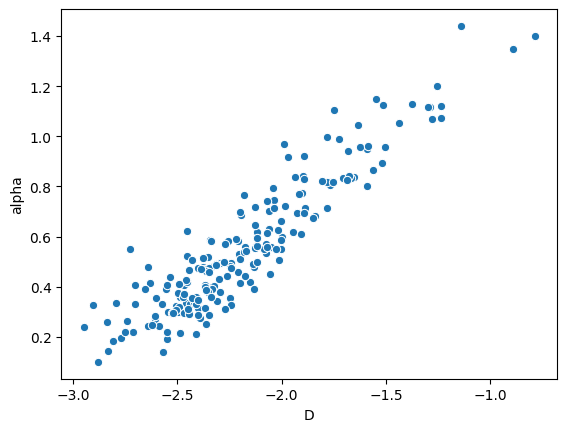

202


In [5]:
mpl.rcParams.update(mpl.rcParamsDefault)
sns.scatterplot(x='D',y='alpha',data=df135)
plt.show()

MSD0 = list(df135['MSD'].values)
print(len(MSD0))

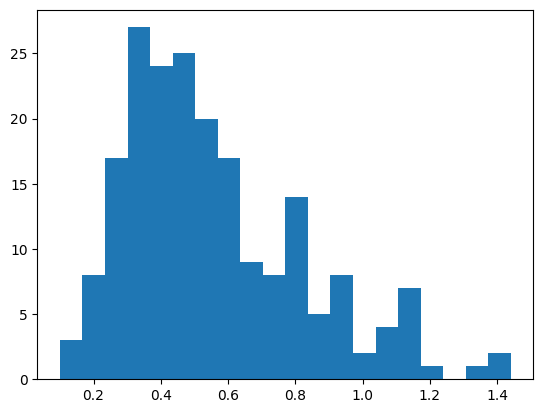

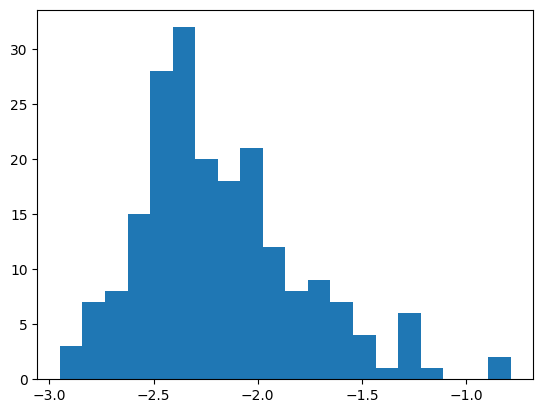

position in list =  0  index in df =  1


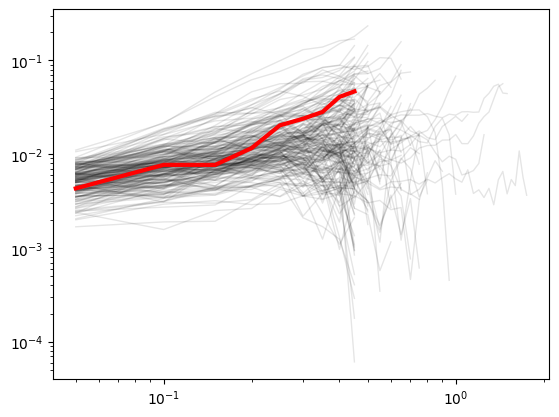

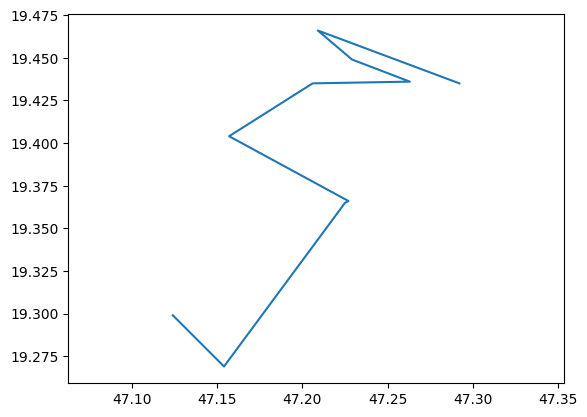

position in list =  1  index in df =  4


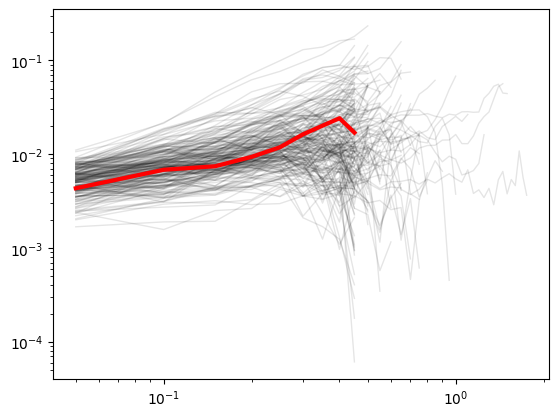

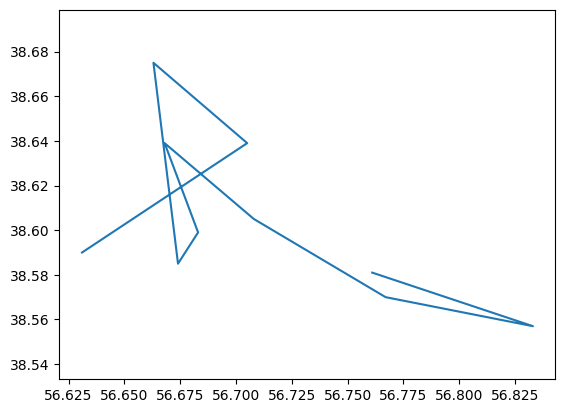

position in list =  2  index in df =  11


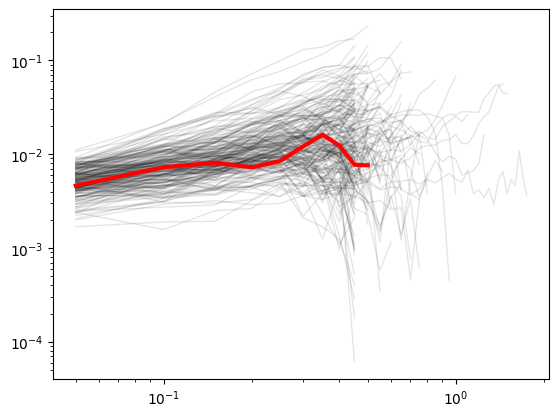

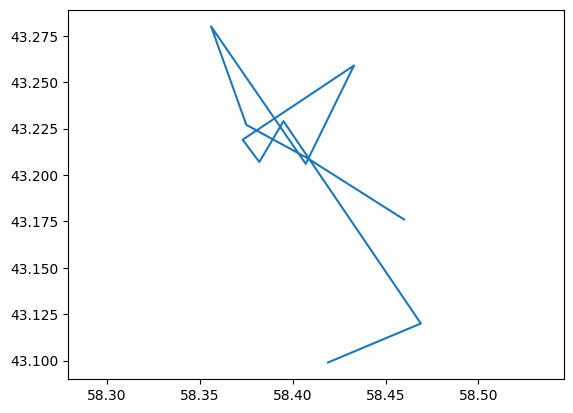

position in list =  3  index in df =  13


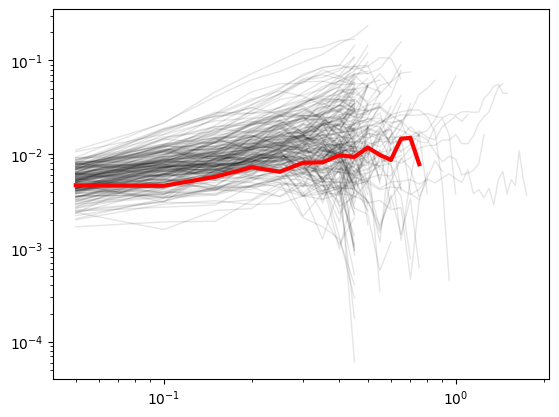

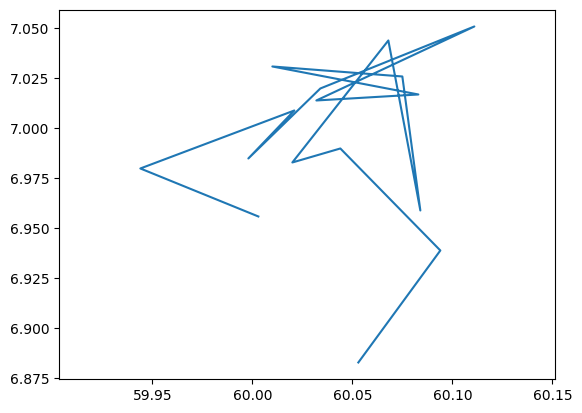

position in list =  4  index in df =  14


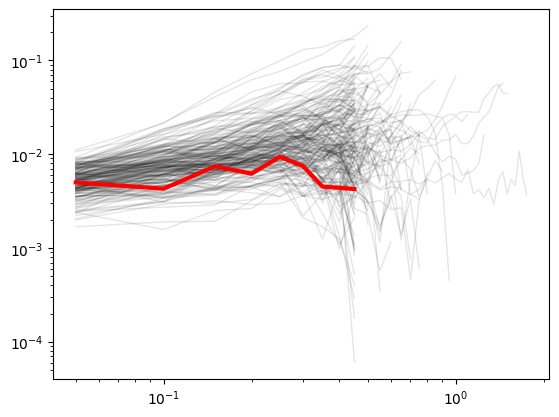

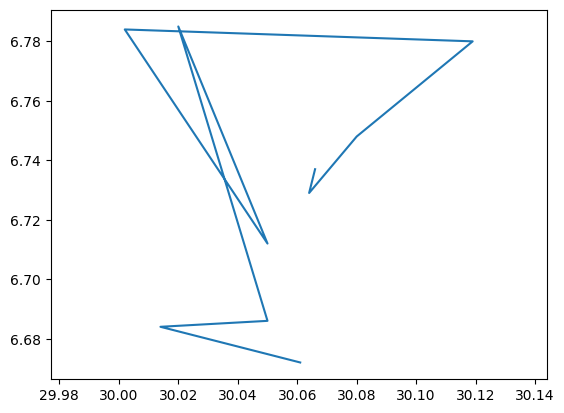

position in list =  5  index in df =  15


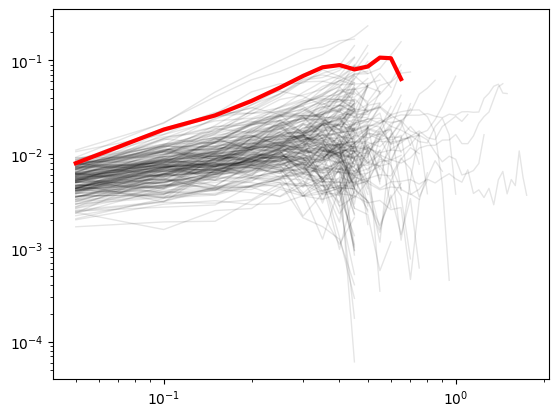

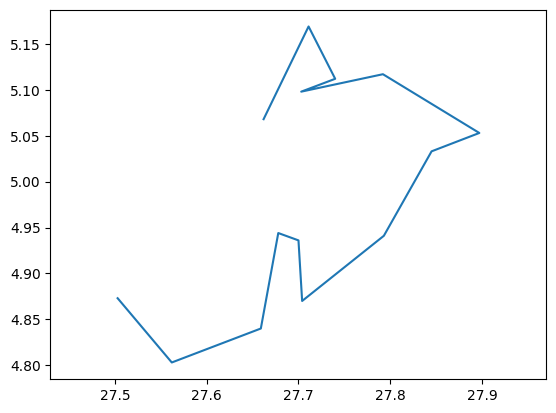

position in list =  6  index in df =  19


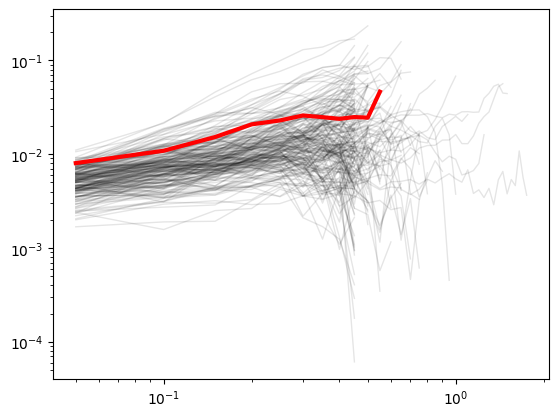

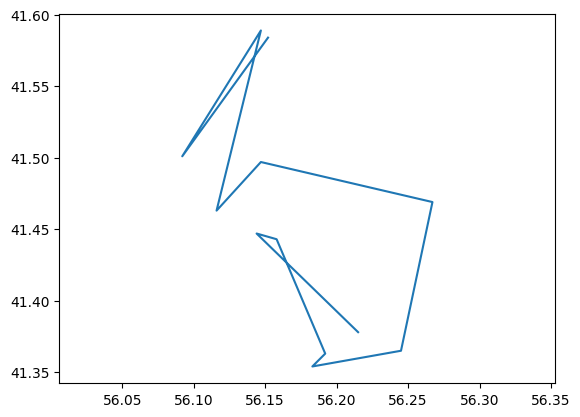

position in list =  7  index in df =  26


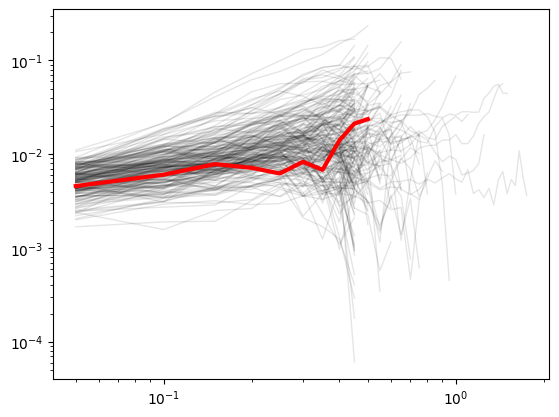

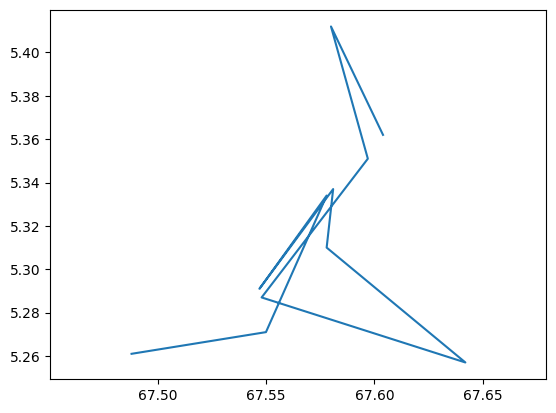

position in list =  8  index in df =  36


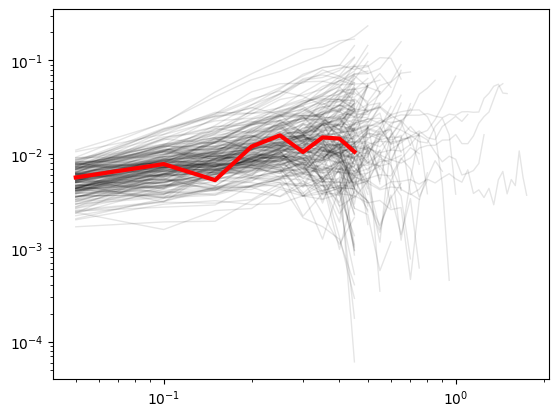

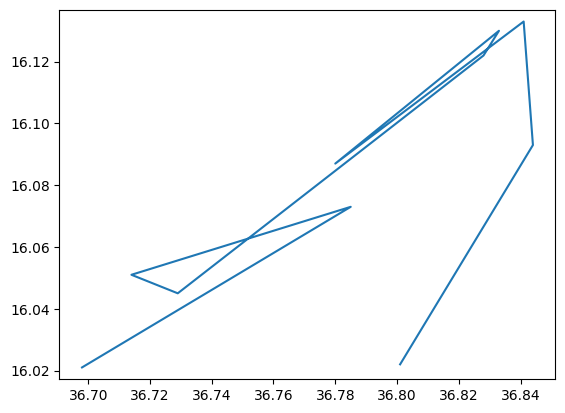

position in list =  9  index in df =  38


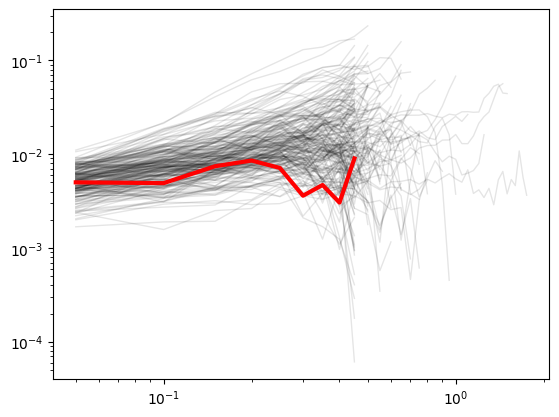

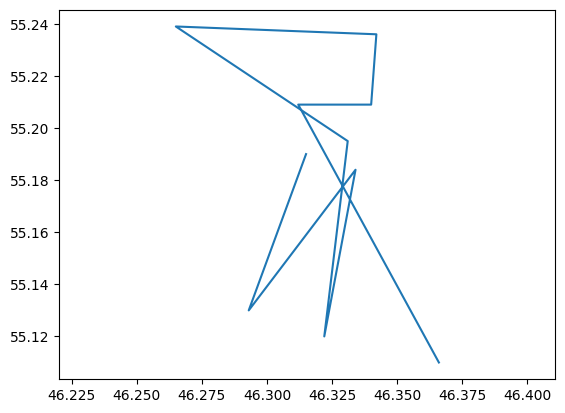

position in list =  10  index in df =  39


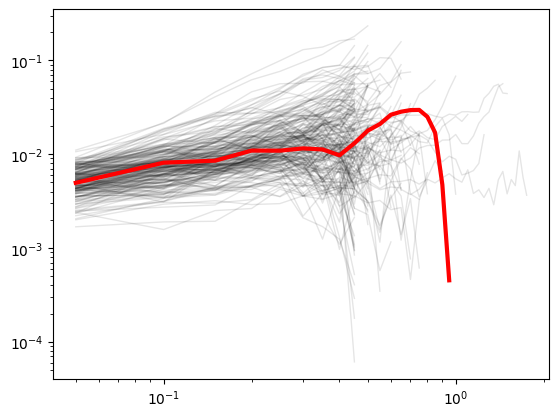

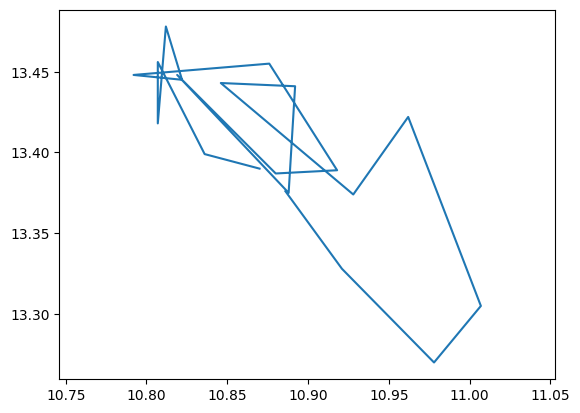

position in list =  11  index in df =  50


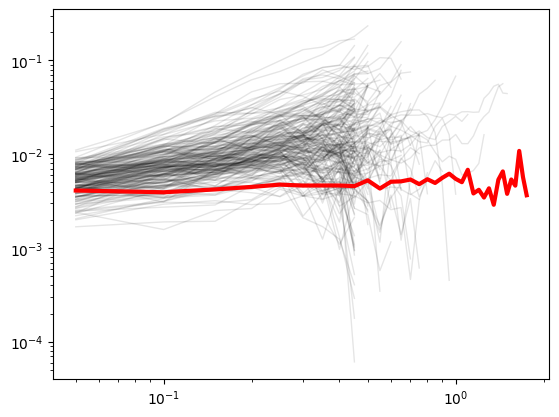

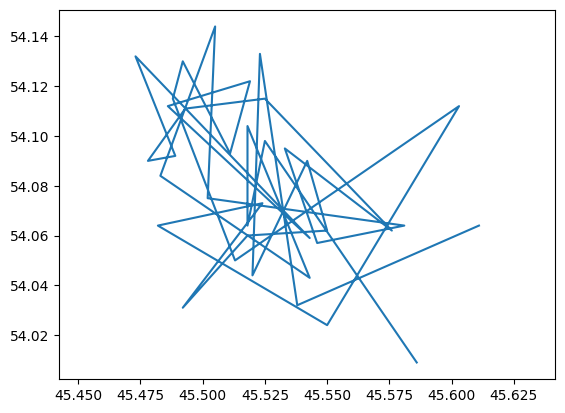

position in list =  12  index in df =  73


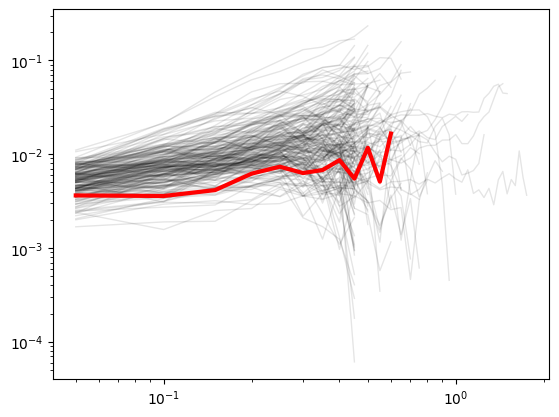

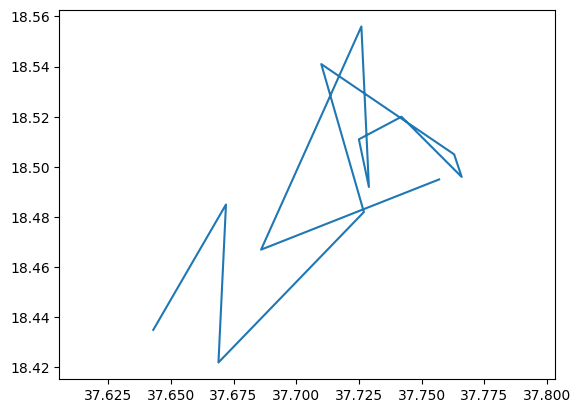

position in list =  13  index in df =  78


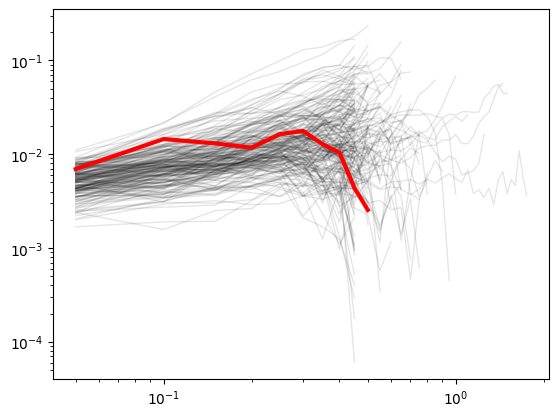

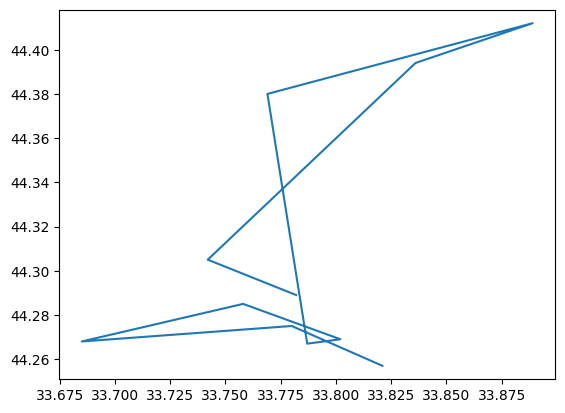

position in list =  14  index in df =  83


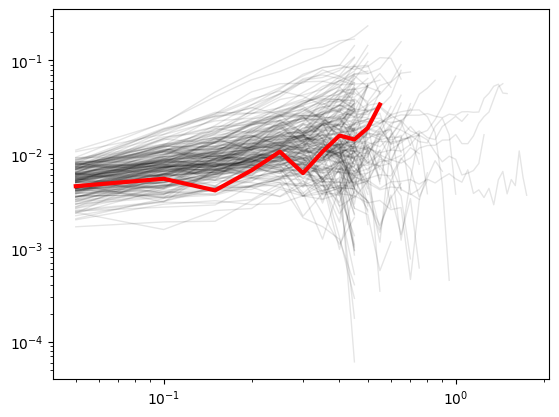

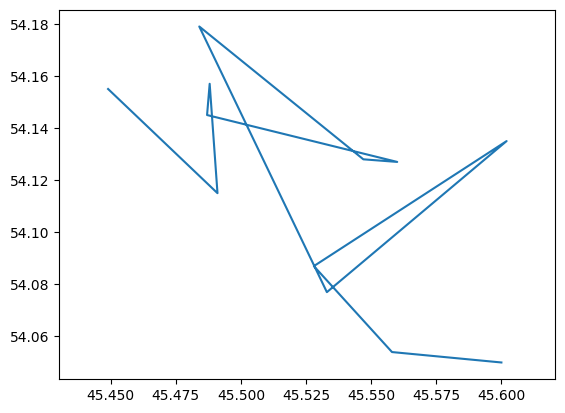

position in list =  15  index in df =  85


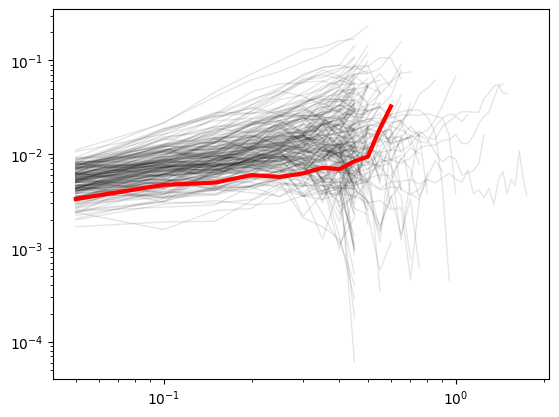

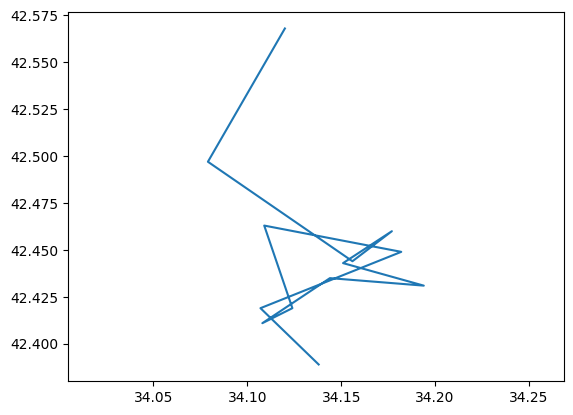

position in list =  16  index in df =  92


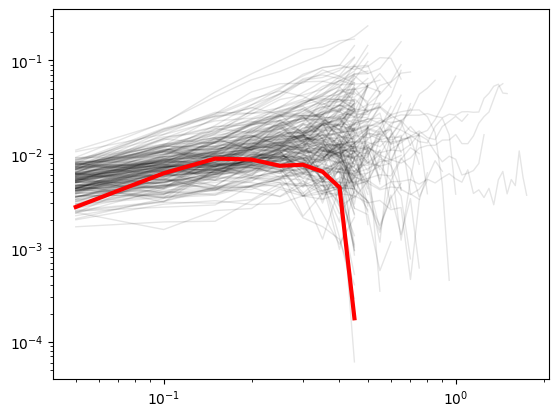

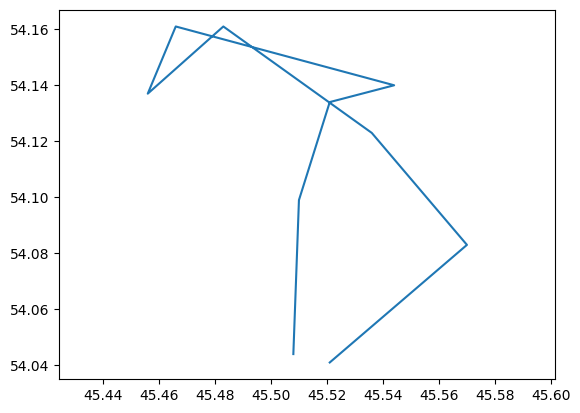

position in list =  17  index in df =  93


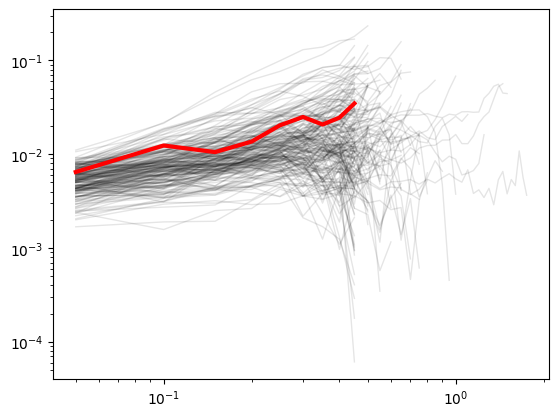

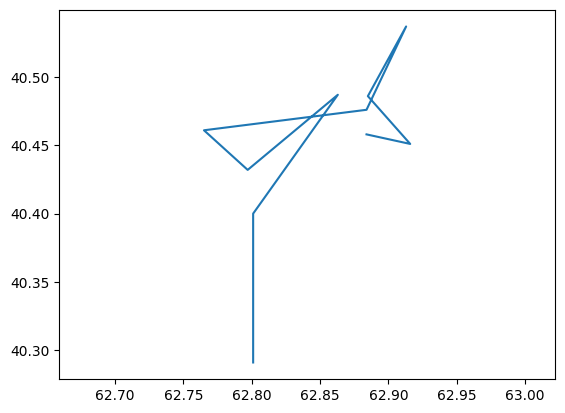

position in list =  18  index in df =  95


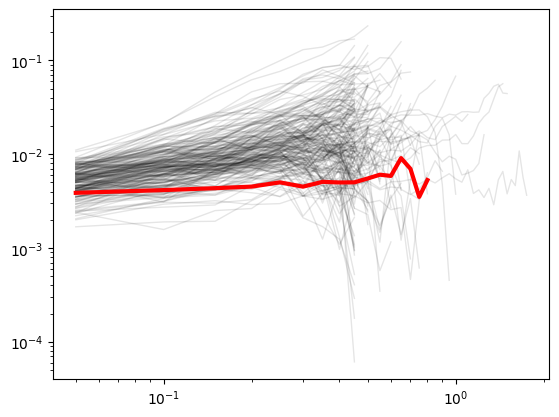

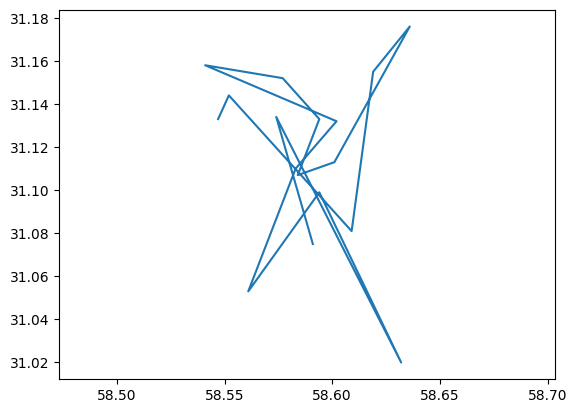

position in list =  19  index in df =  98


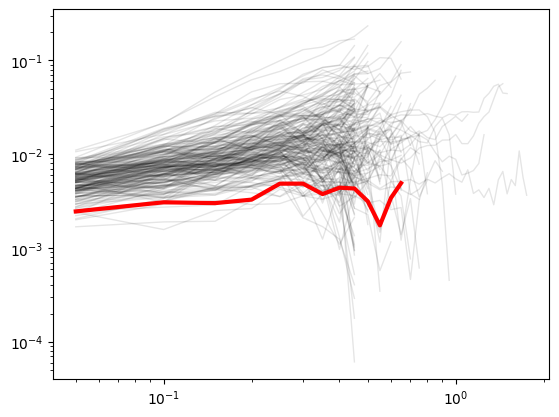

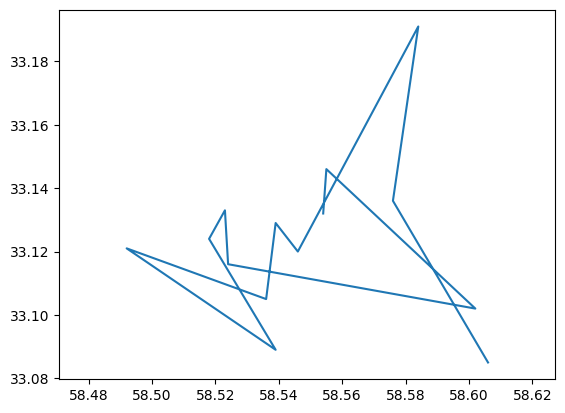

position in list =  20  index in df =  100


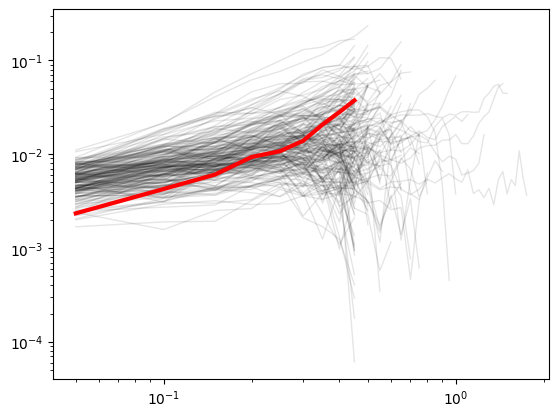

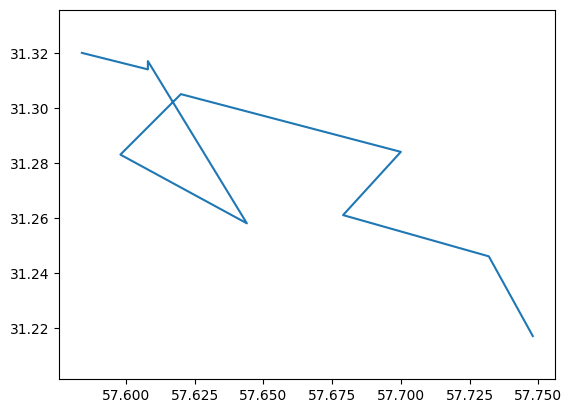

position in list =  21  index in df =  102


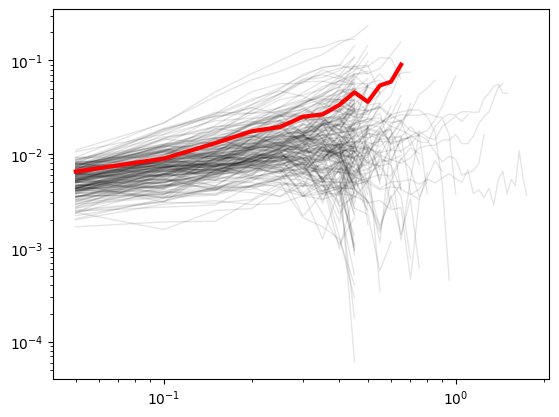

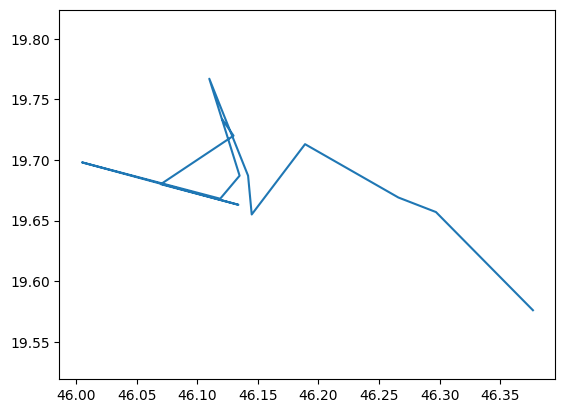

position in list =  22  index in df =  104


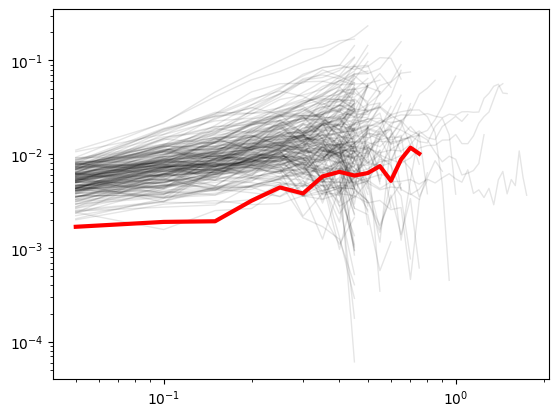

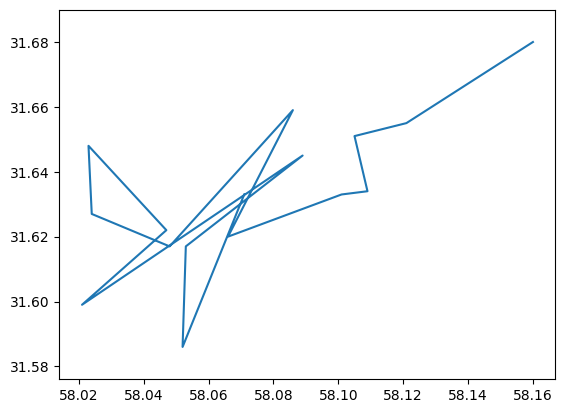

position in list =  23  index in df =  106


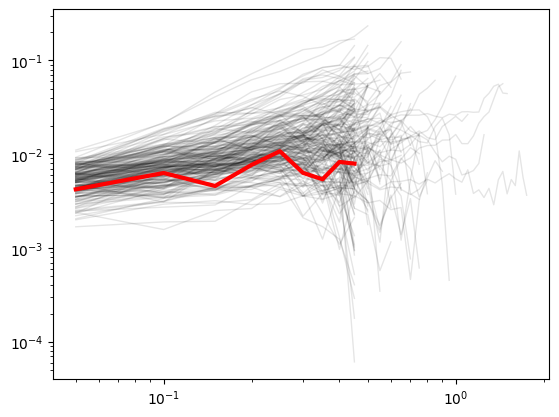

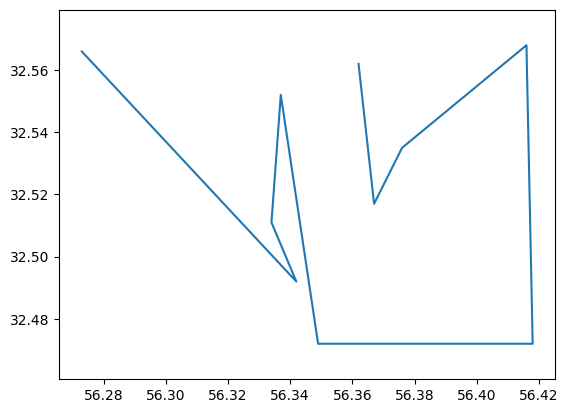

position in list =  24  index in df =  109


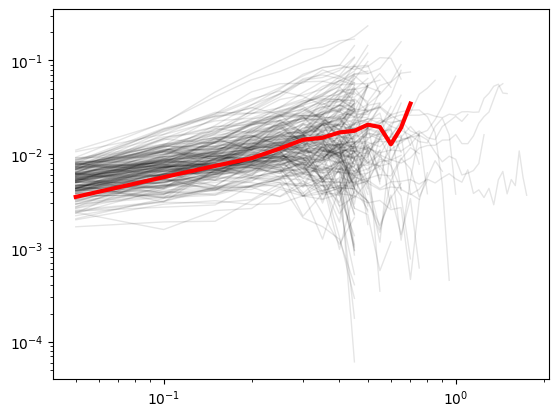

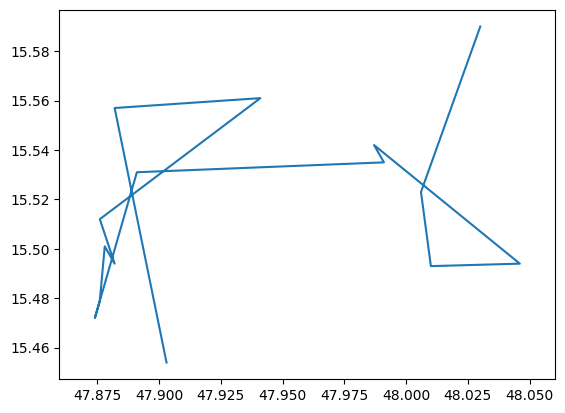

position in list =  25  index in df =  113


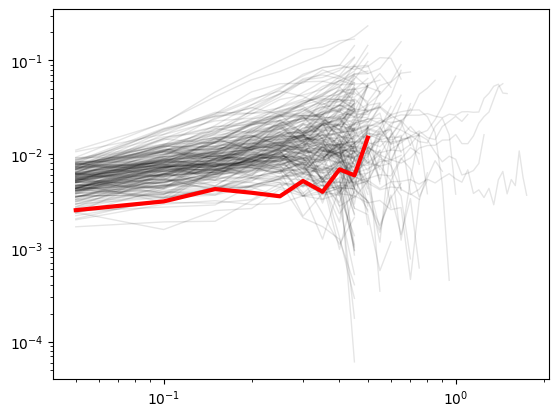

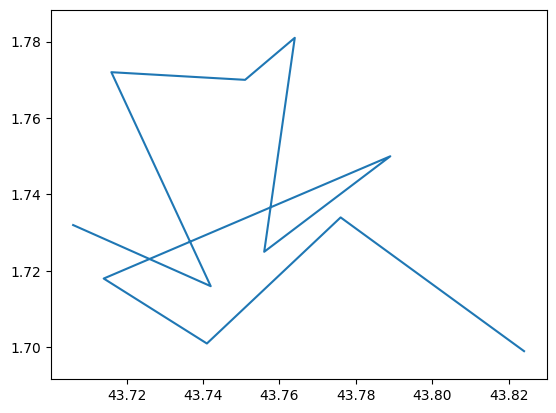

position in list =  26  index in df =  116


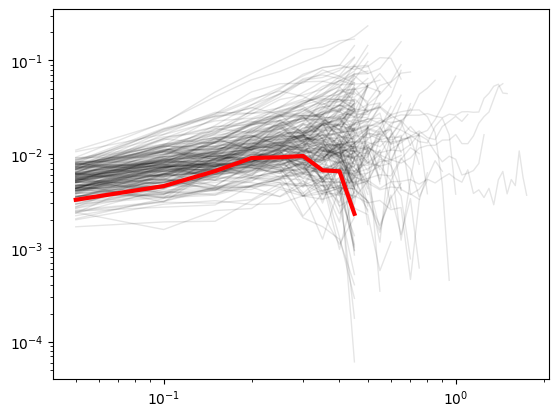

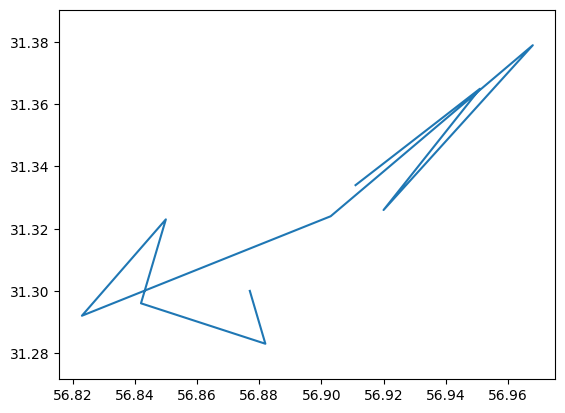

position in list =  27  index in df =  117


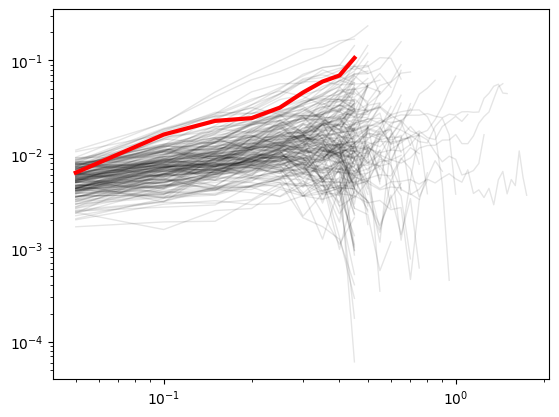

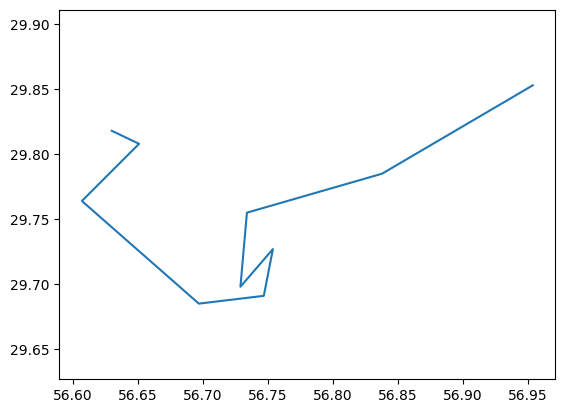

position in list =  28  index in df =  120


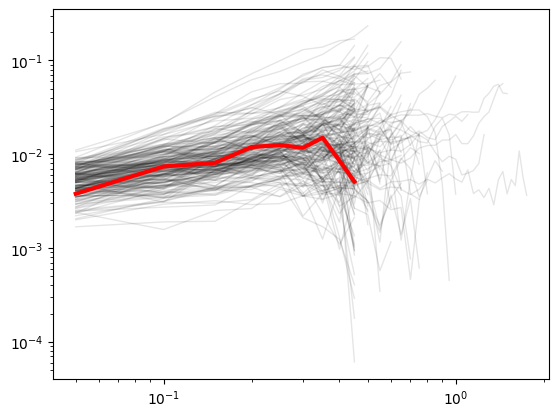

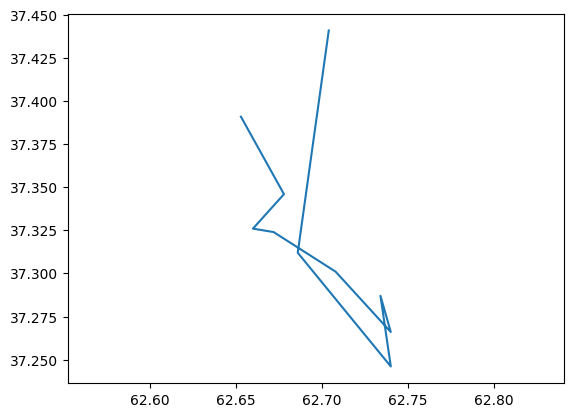

position in list =  29  index in df =  122


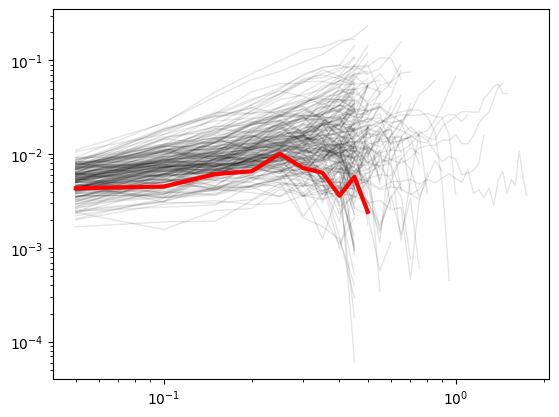

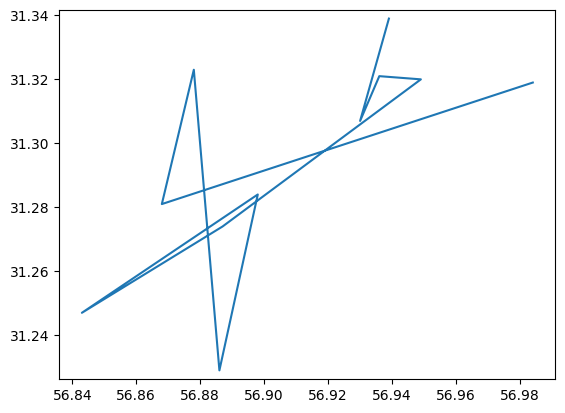

position in list =  30  index in df =  123


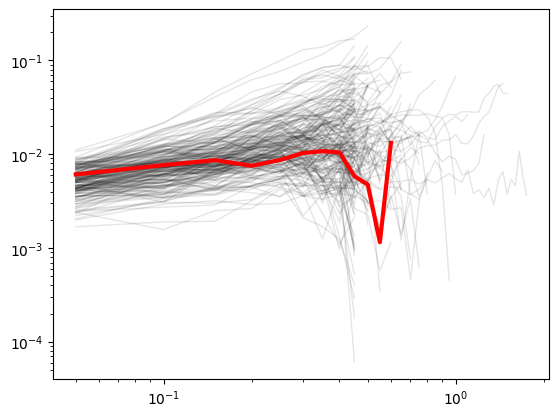

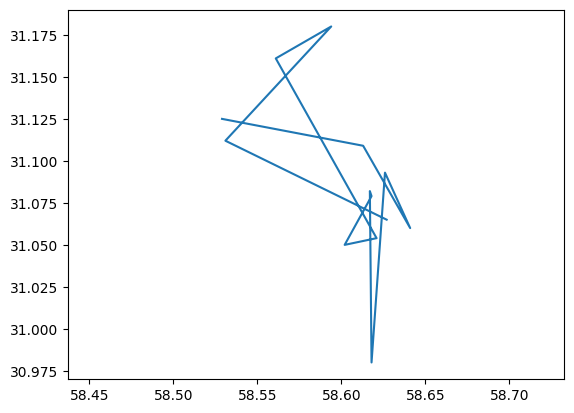

position in list =  31  index in df =  126


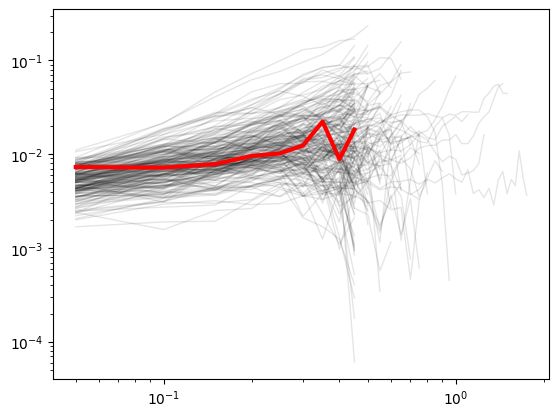

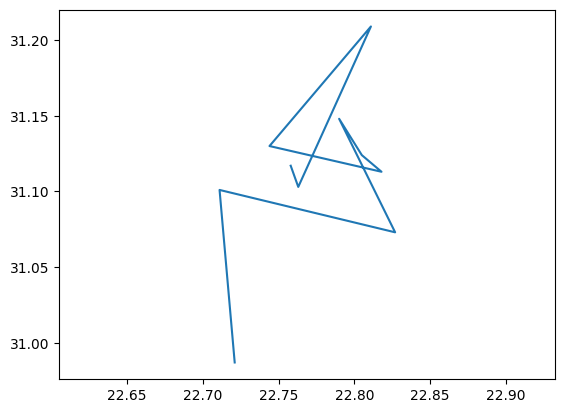

position in list =  32  index in df =  129


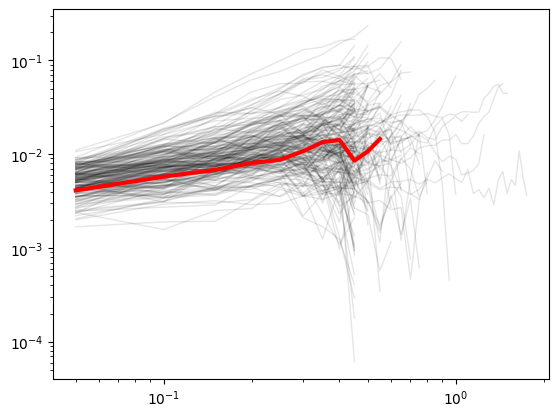

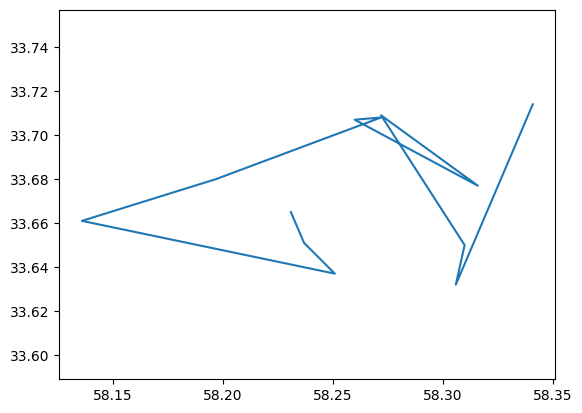

position in list =  33  index in df =  135


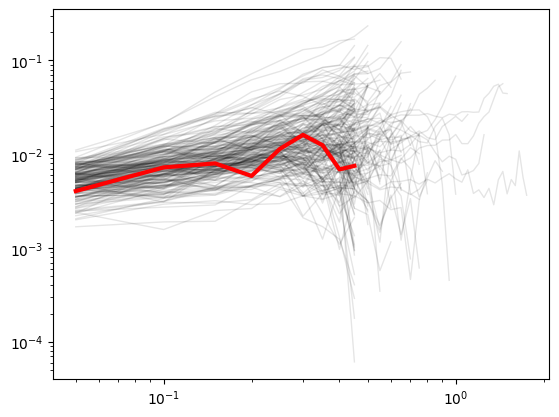

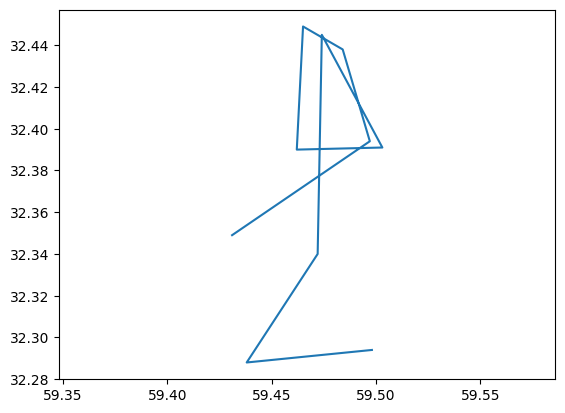

position in list =  34  index in df =  138


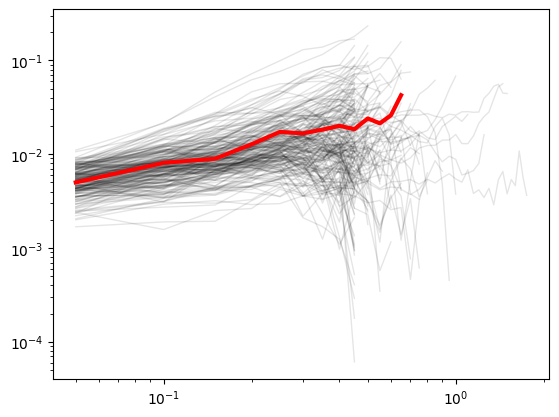

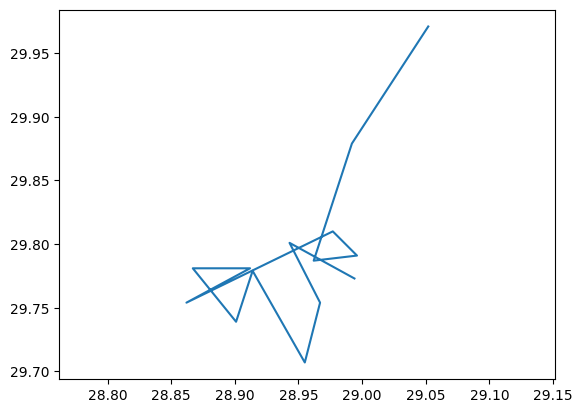

position in list =  35  index in df =  143


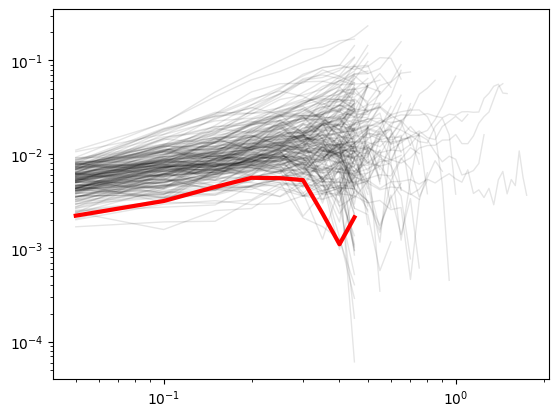

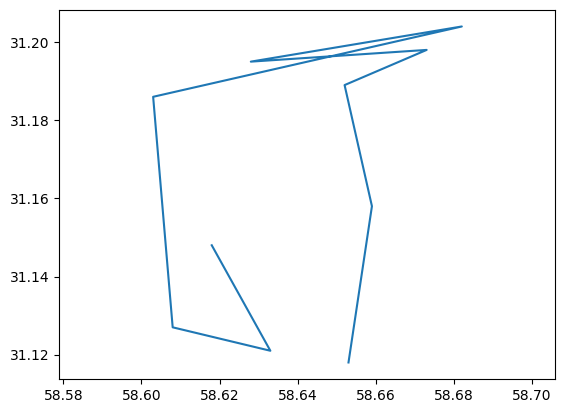

position in list =  36  index in df =  147


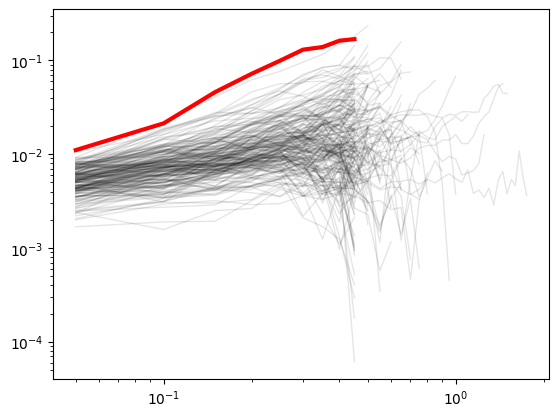

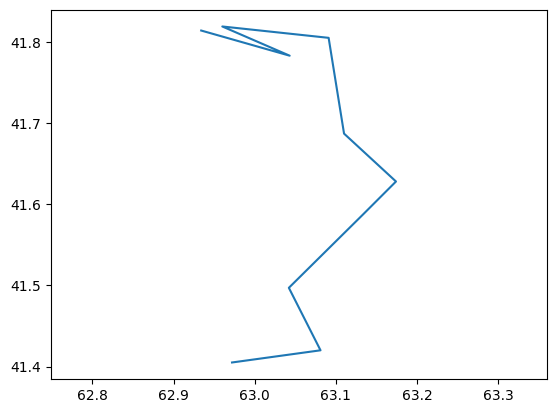

position in list =  37  index in df =  152


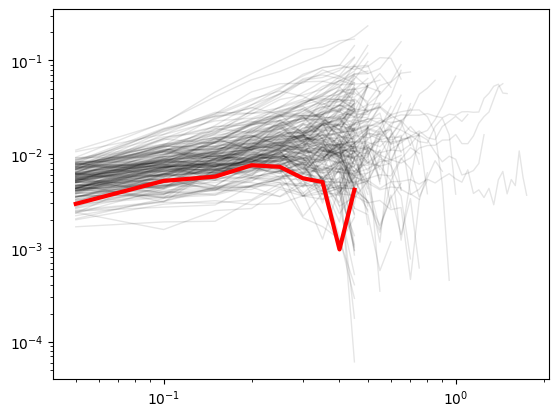

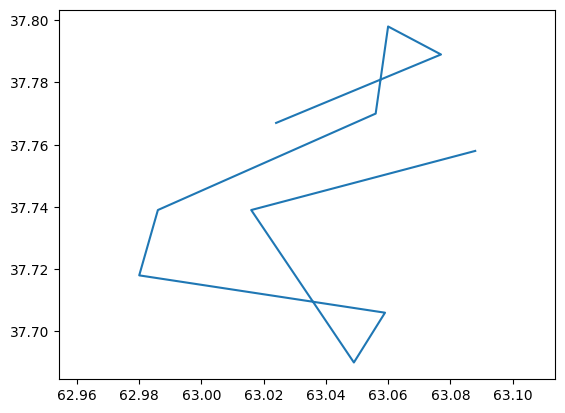

position in list =  38  index in df =  153


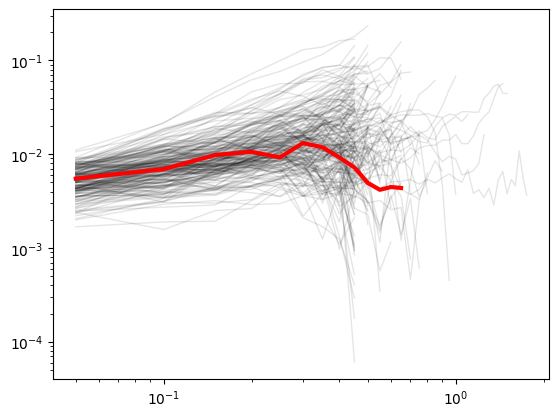

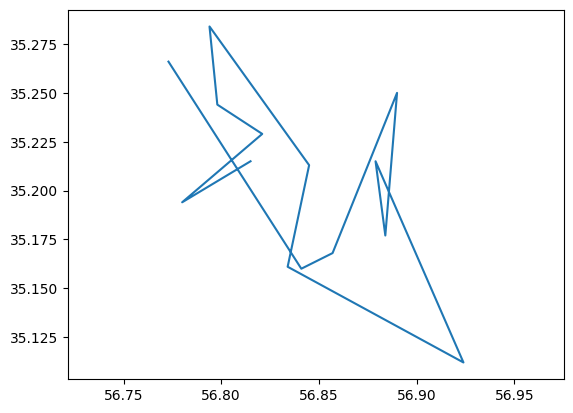

position in list =  39  index in df =  155


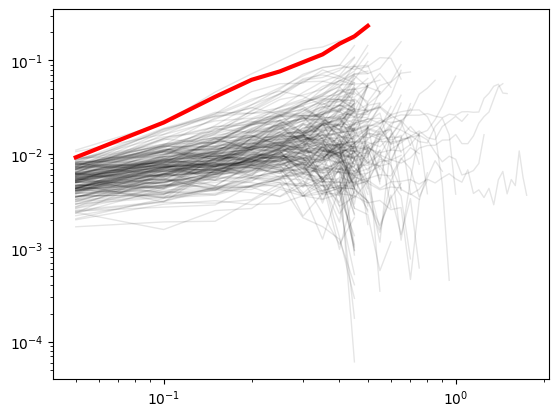

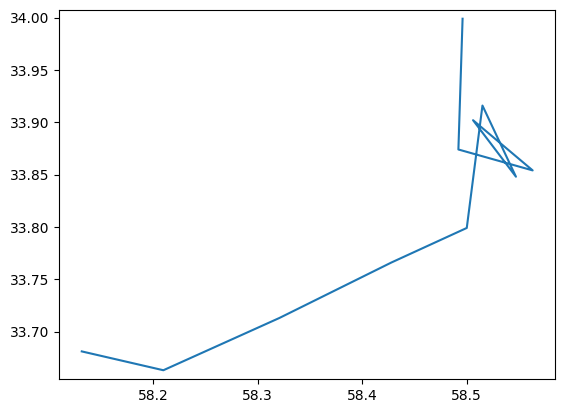

position in list =  40  index in df =  156


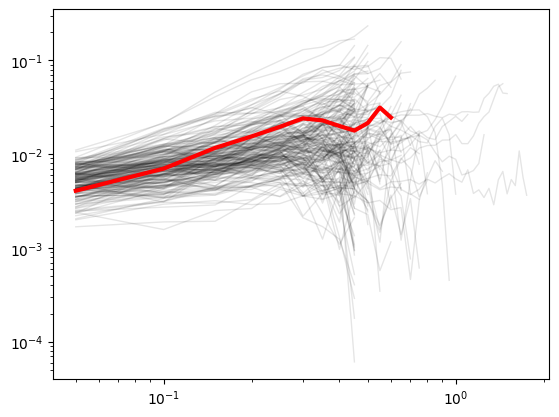

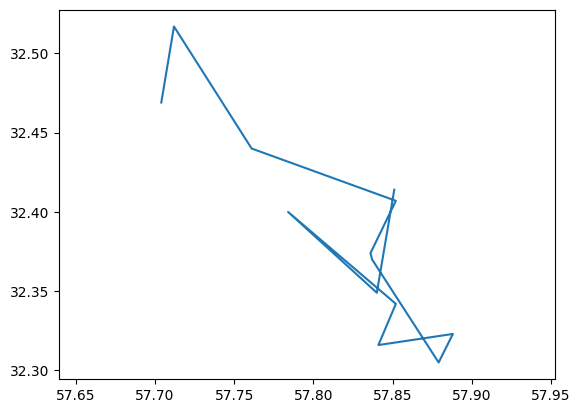

position in list =  41  index in df =  162


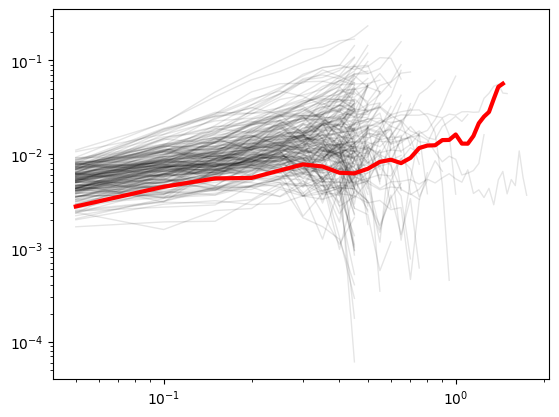

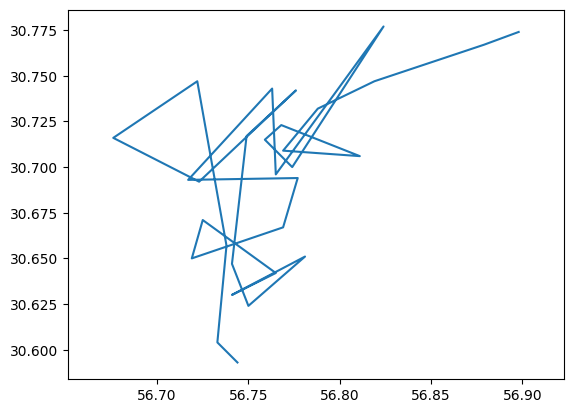

position in list =  42  index in df =  164


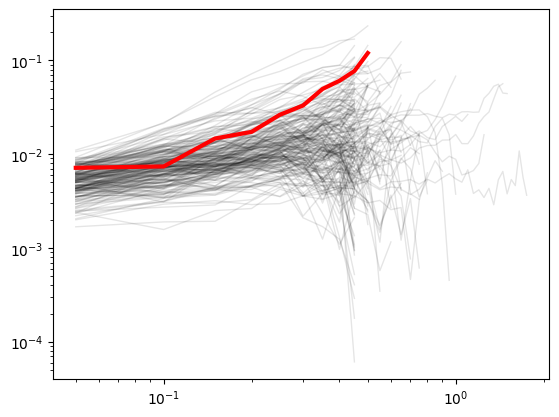

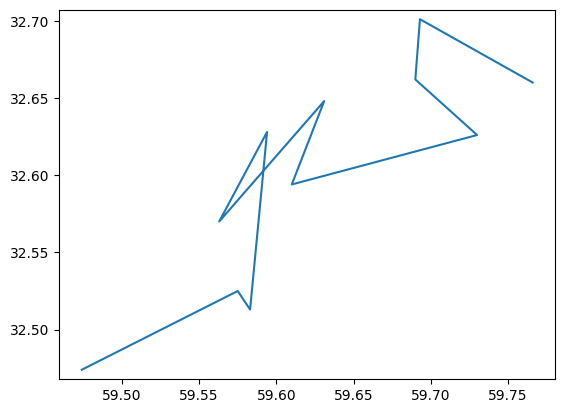

position in list =  43  index in df =  171


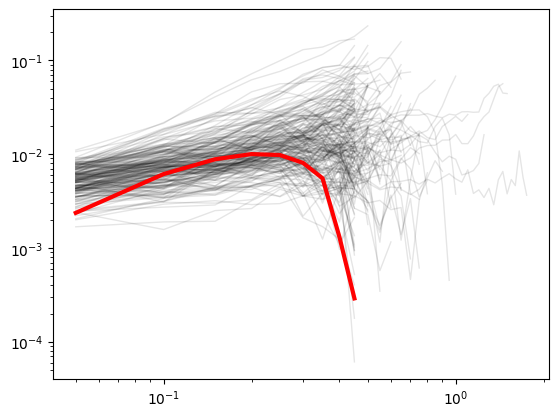

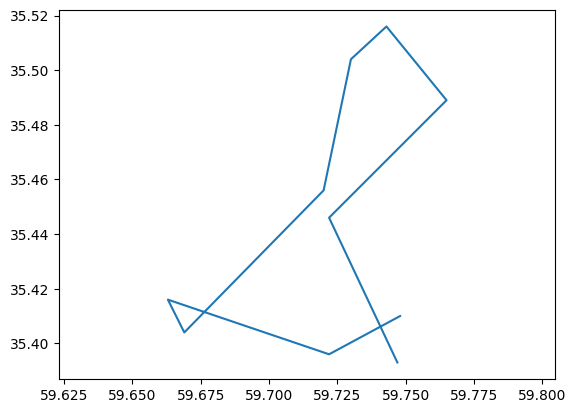

position in list =  44  index in df =  179


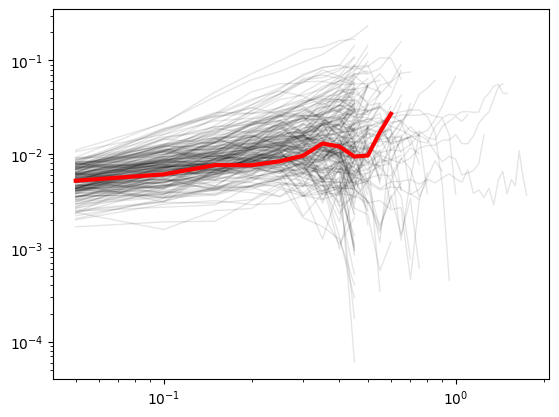

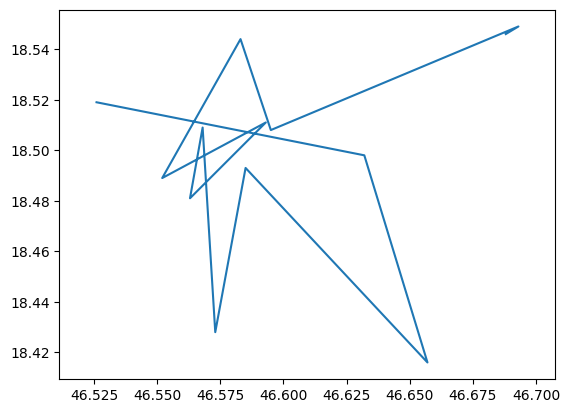

position in list =  45  index in df =  183


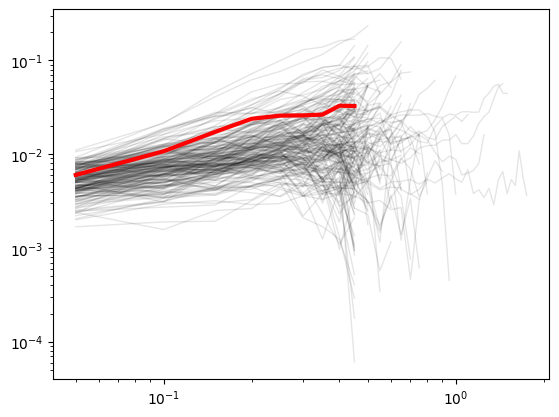

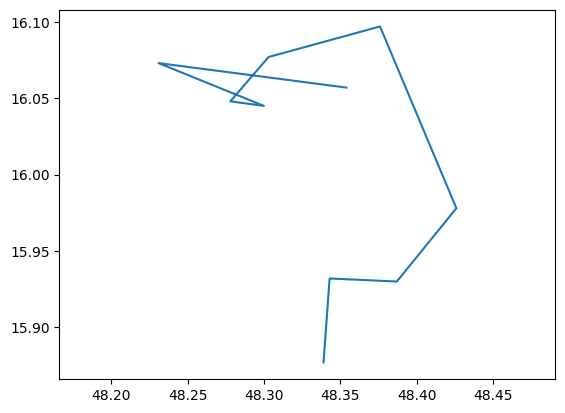

position in list =  46  index in df =  185


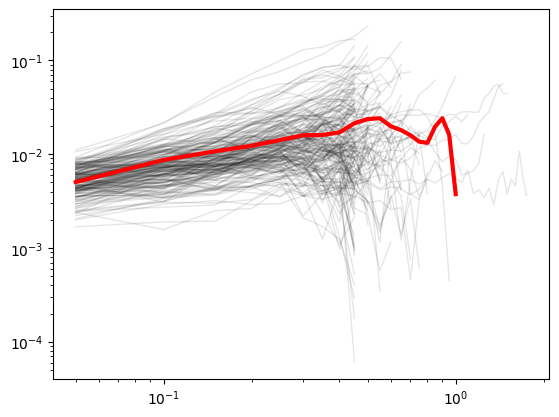

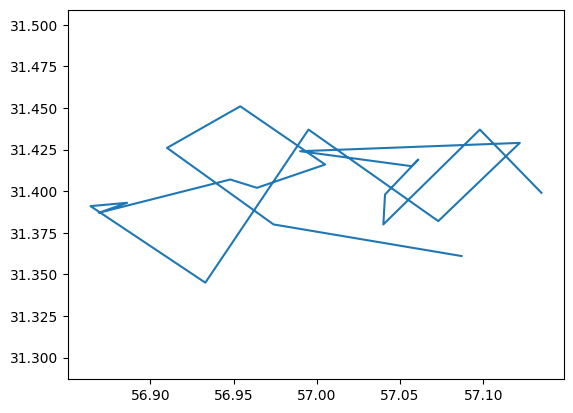

position in list =  47  index in df =  191


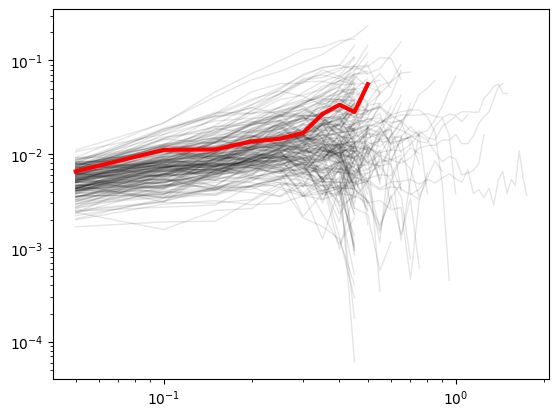

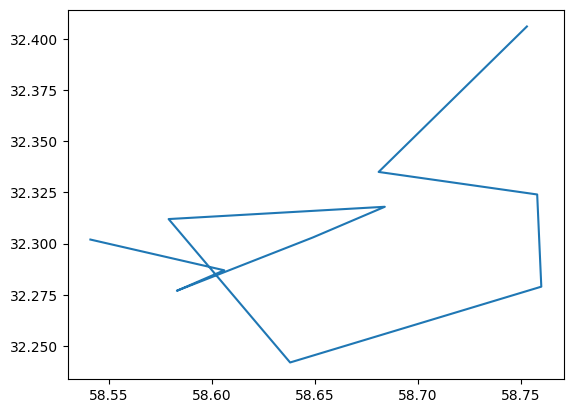

position in list =  48  index in df =  200


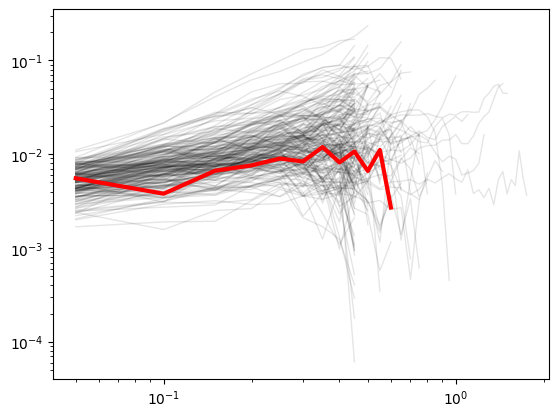

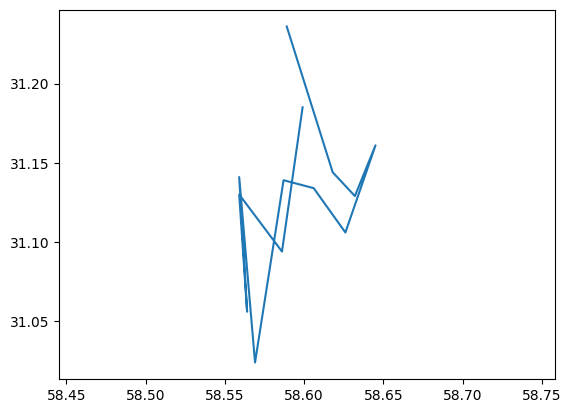

position in list =  49  index in df =  201


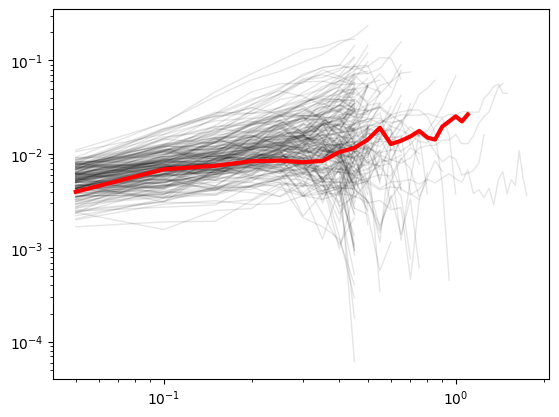

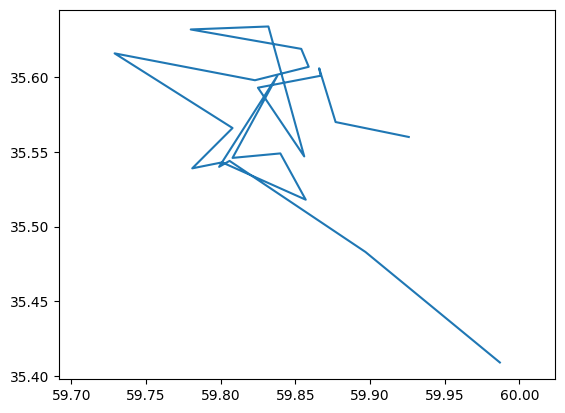

position in list =  50  index in df =  202


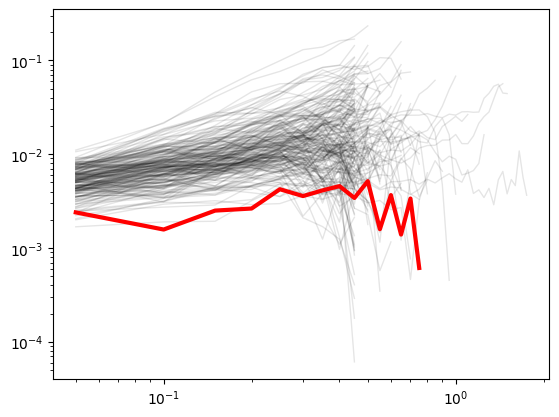

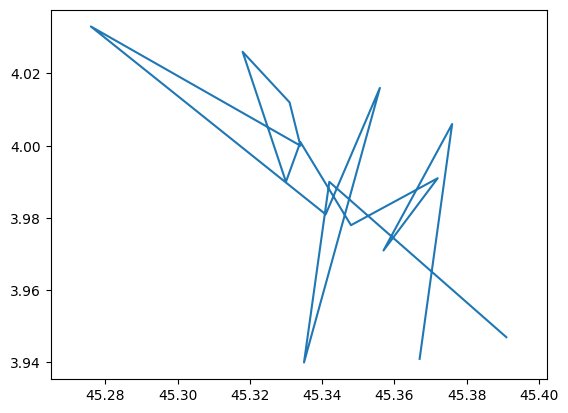

position in list =  51  index in df =  203


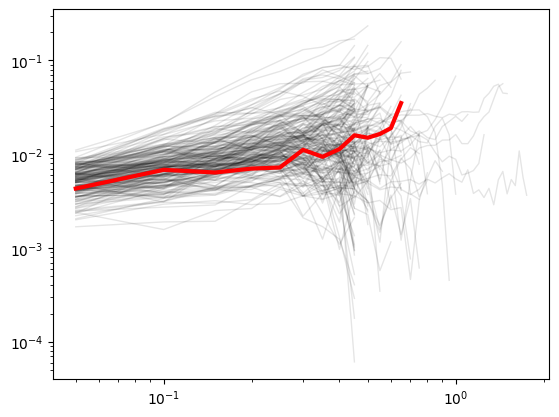

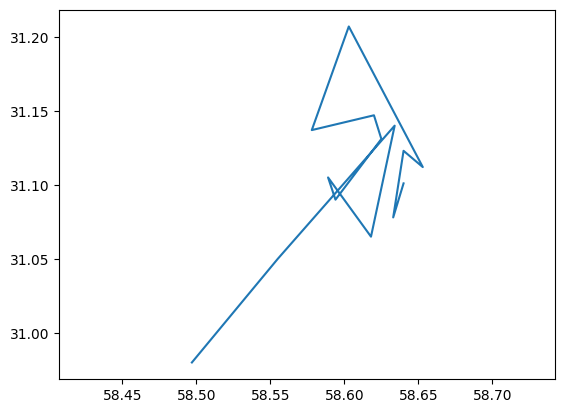

position in list =  52  index in df =  204


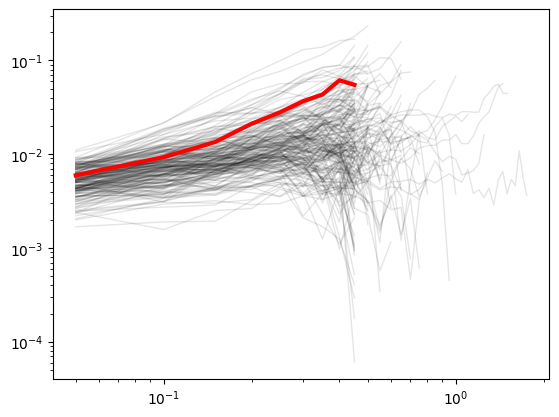

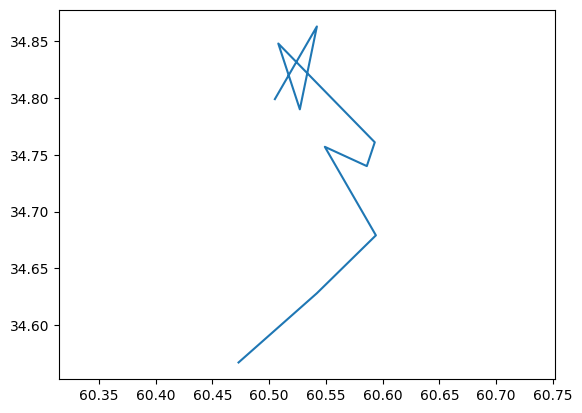

position in list =  53  index in df =  212


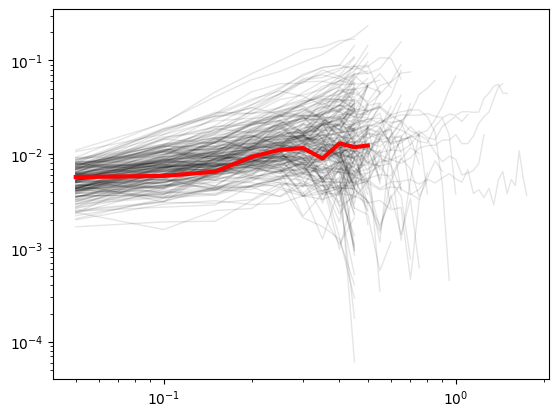

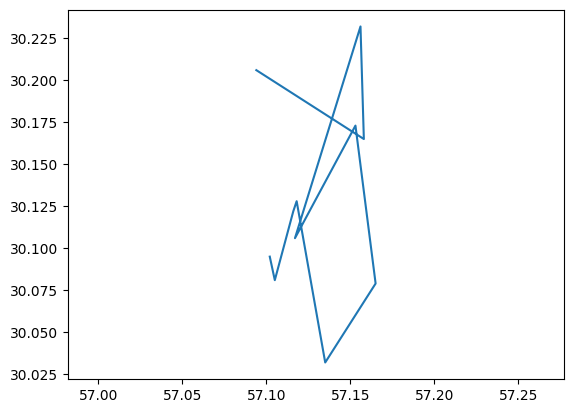

position in list =  54  index in df =  214


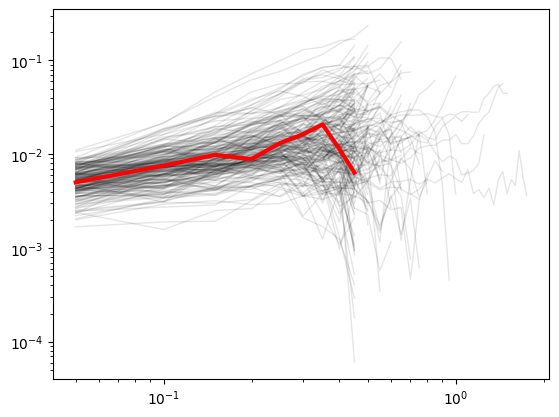

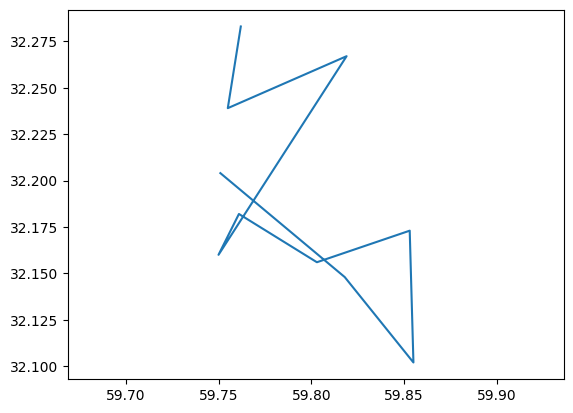

position in list =  55  index in df =  217


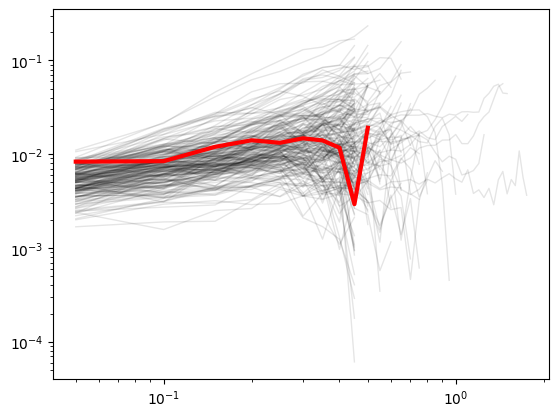

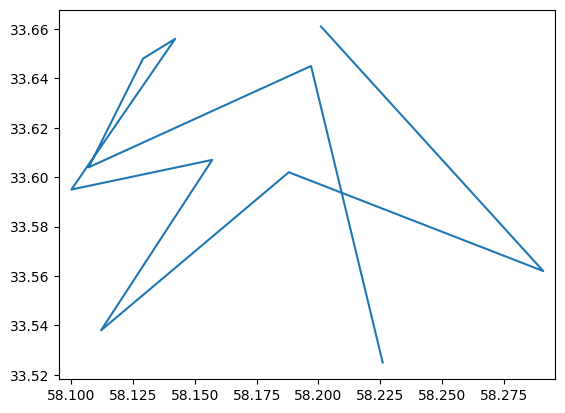

position in list =  56  index in df =  219


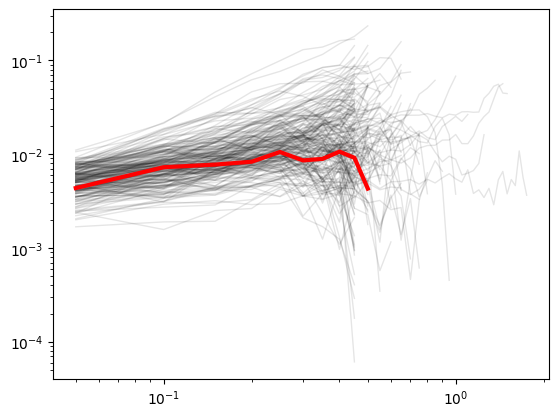

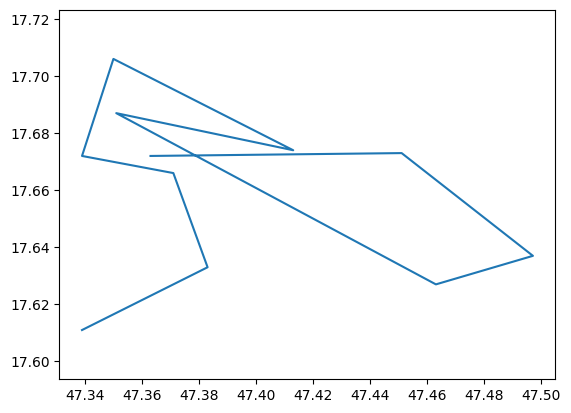

position in list =  57  index in df =  220


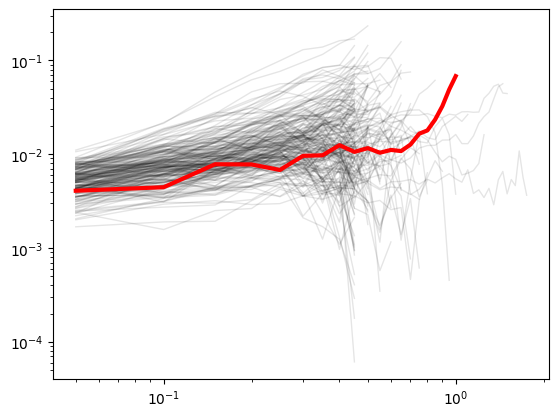

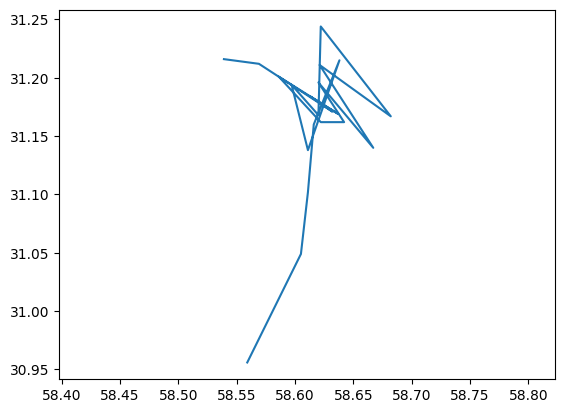

position in list =  58  index in df =  223


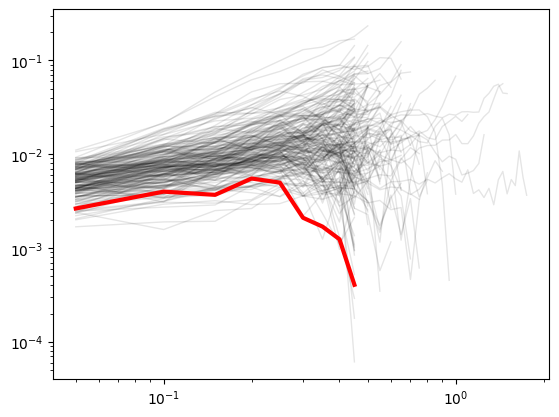

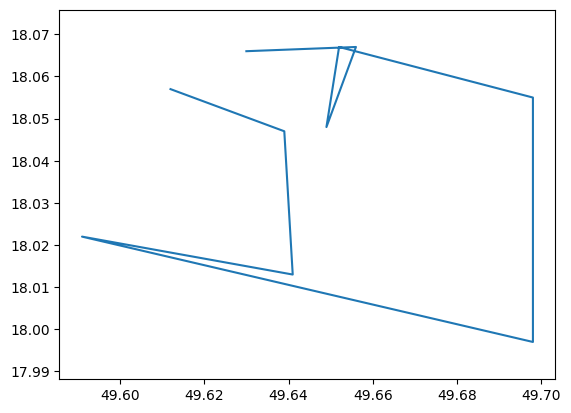

position in list =  59  index in df =  231


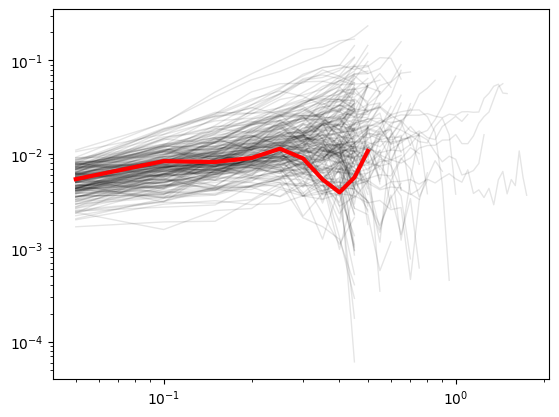

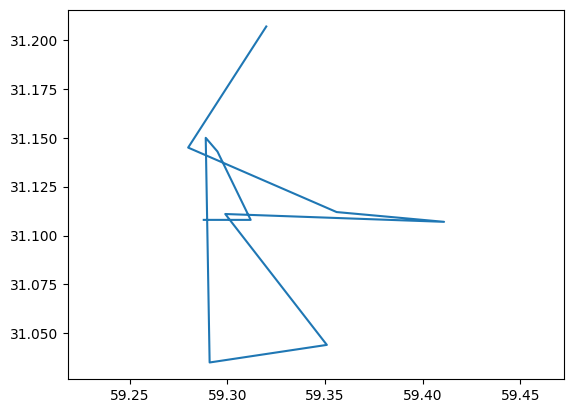

position in list =  60  index in df =  241


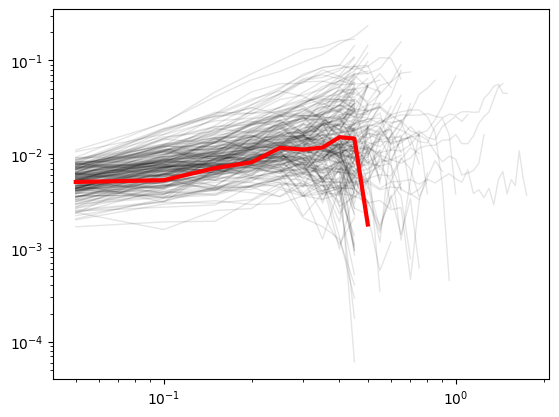

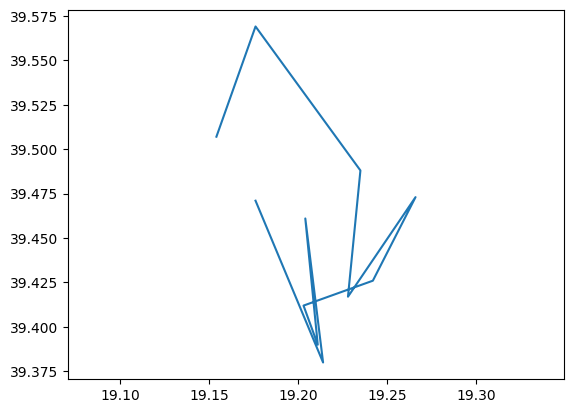

position in list =  61  index in df =  247


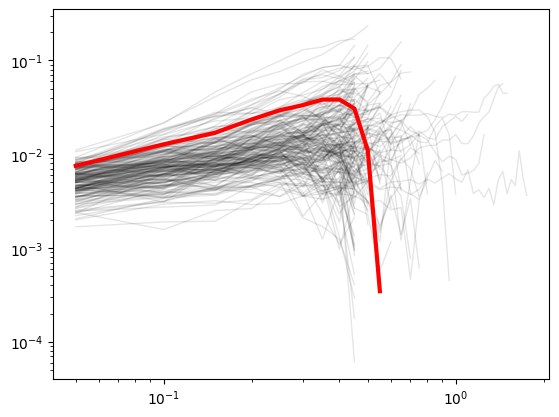

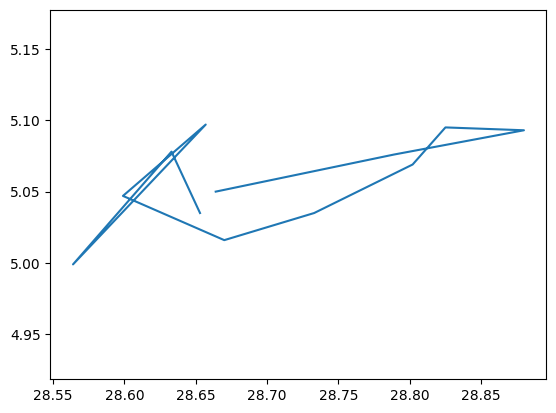

position in list =  62  index in df =  249


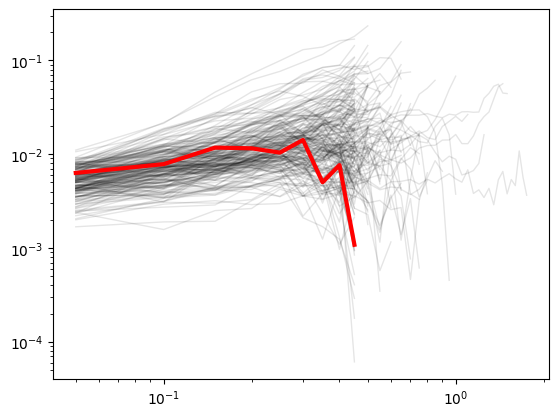

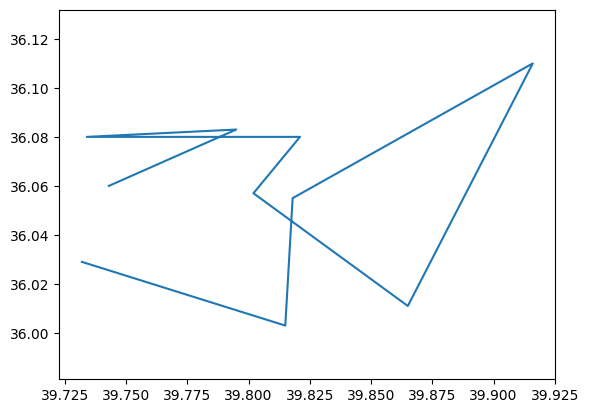

position in list =  63  index in df =  251


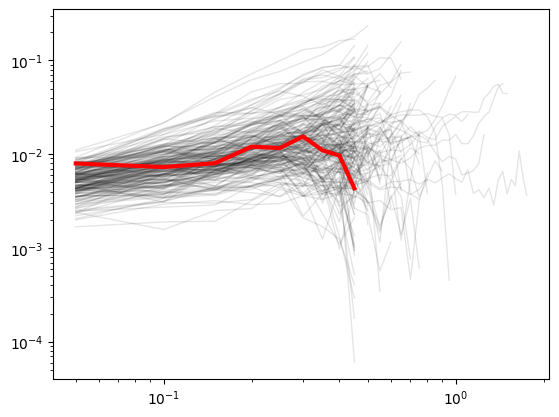

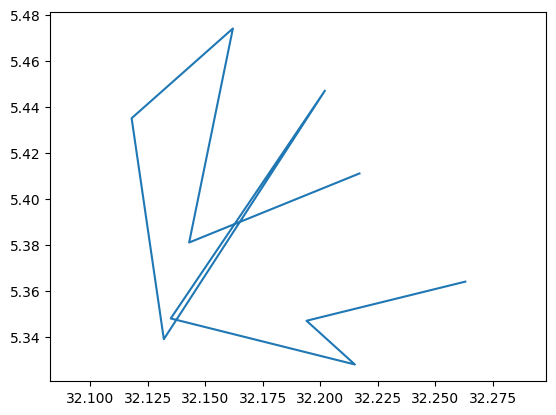

position in list =  64  index in df =  252


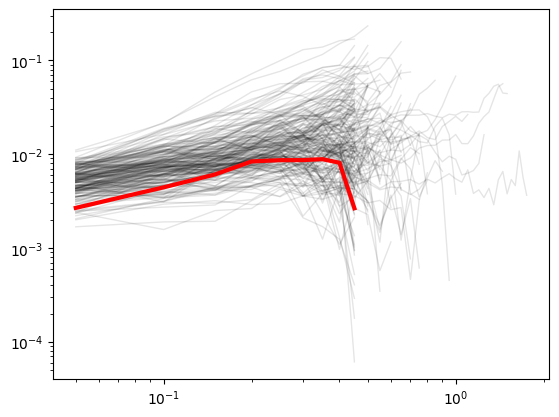

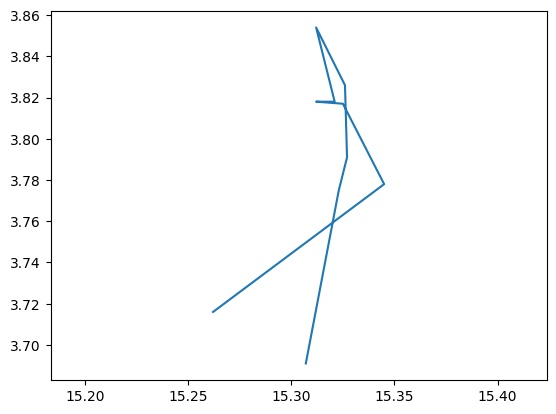

position in list =  65  index in df =  266


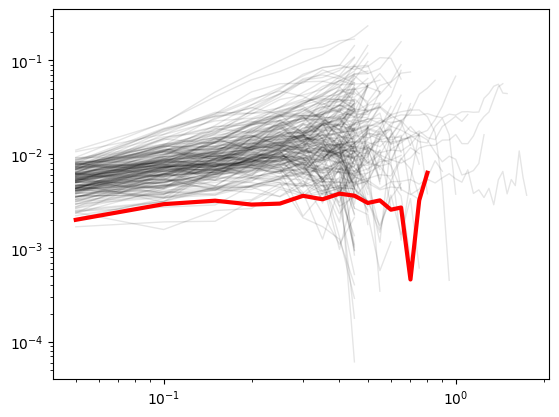

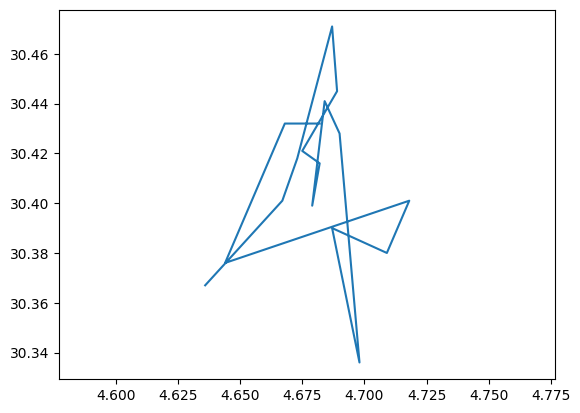

position in list =  66  index in df =  276


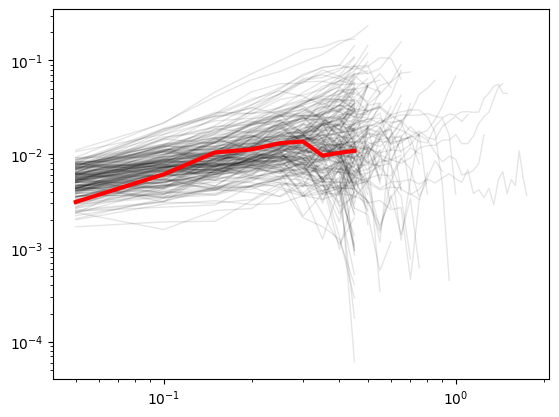

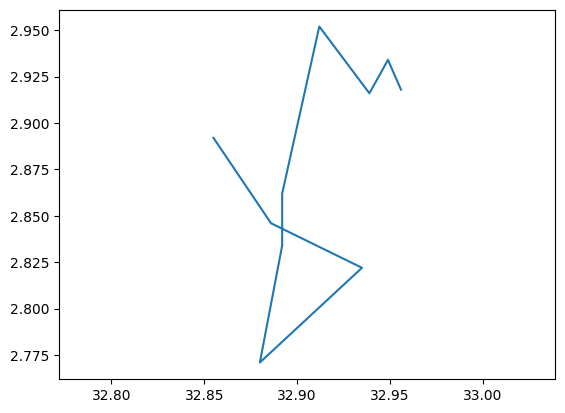

position in list =  67  index in df =  278


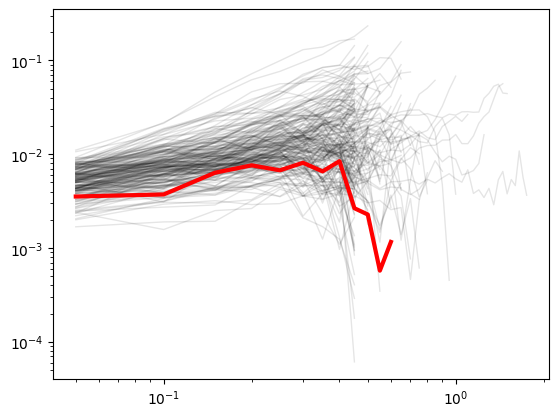

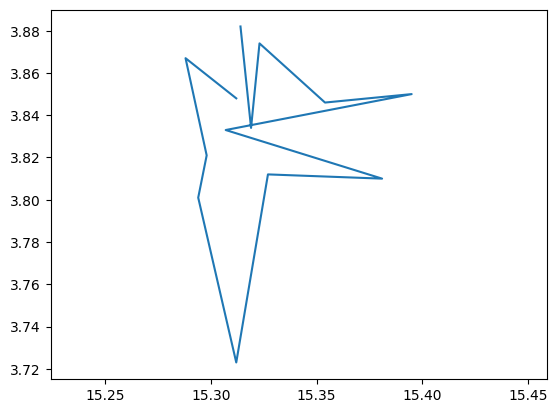

position in list =  68  index in df =  279


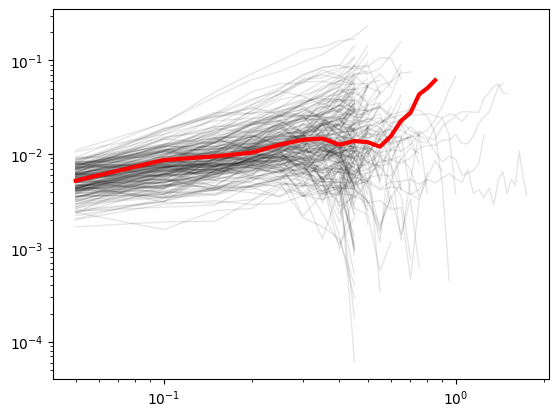

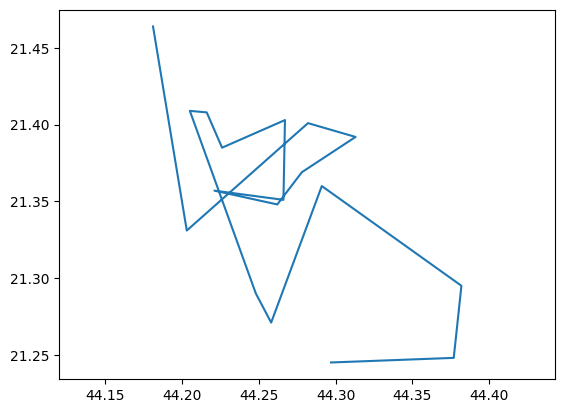

position in list =  69  index in df =  280


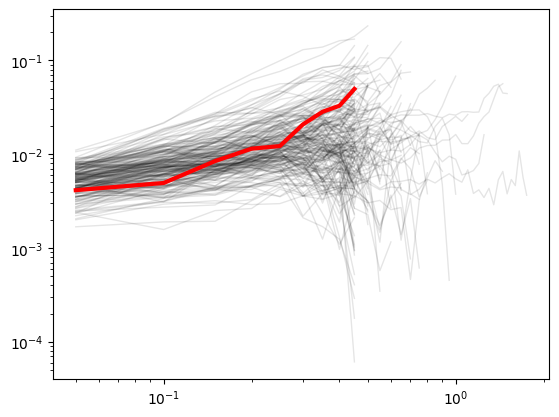

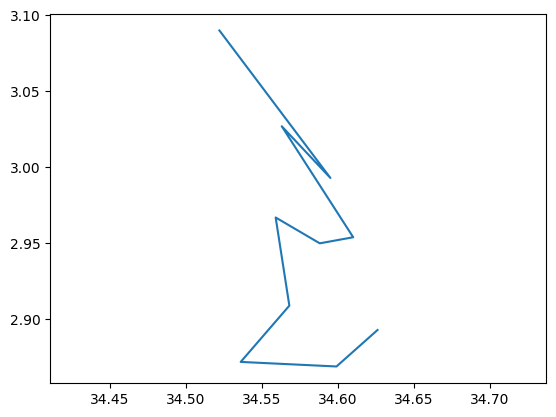

position in list =  70  index in df =  283


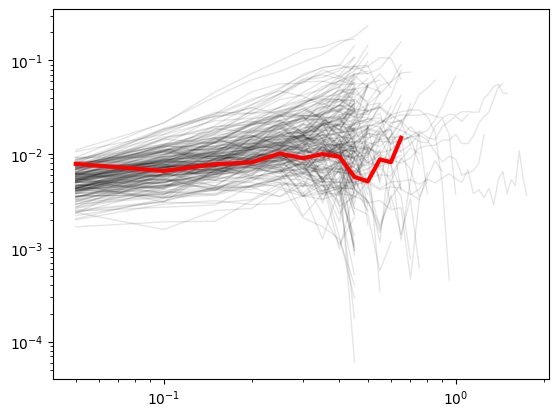

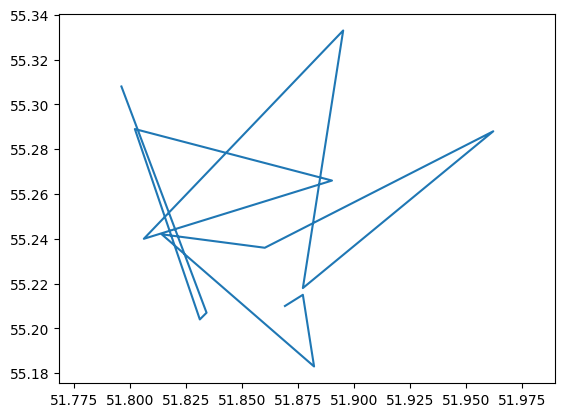

position in list =  71  index in df =  285


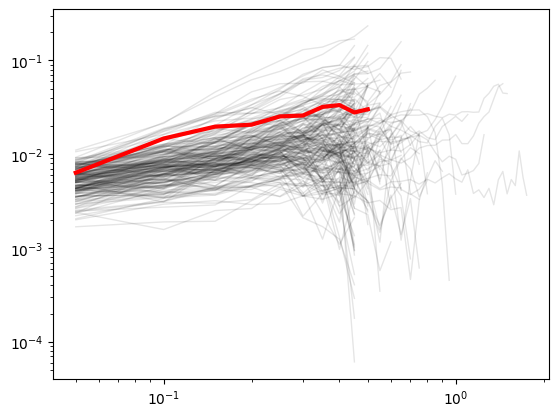

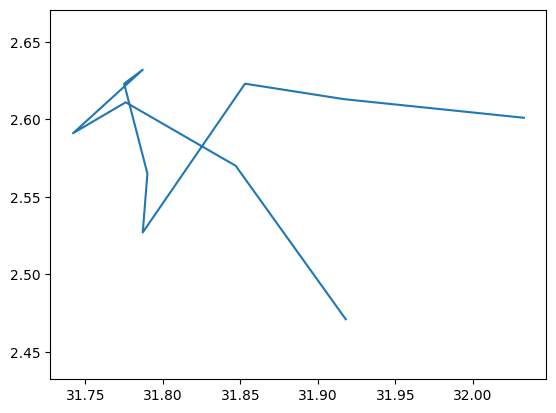

position in list =  72  index in df =  291


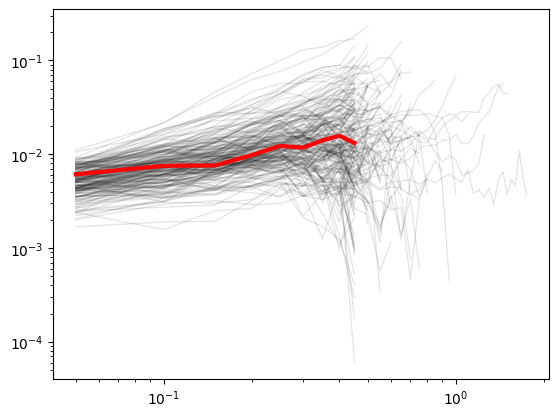

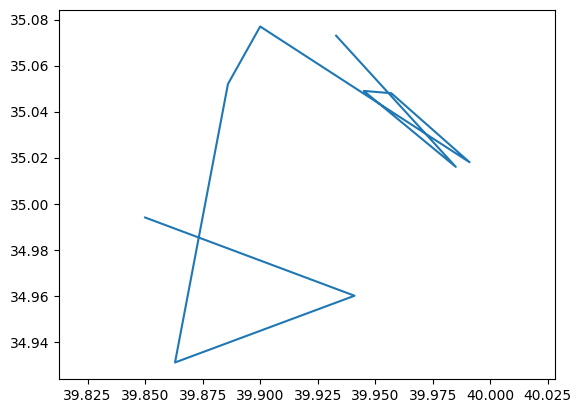

position in list =  73  index in df =  295


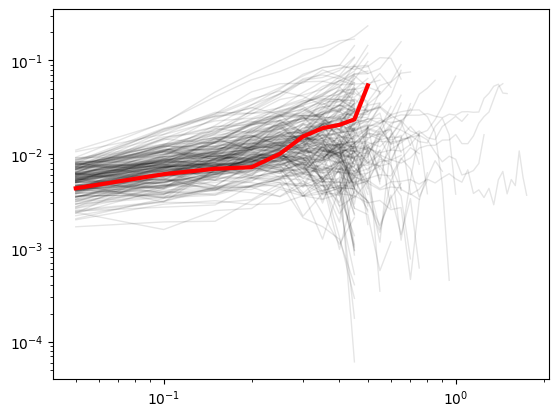

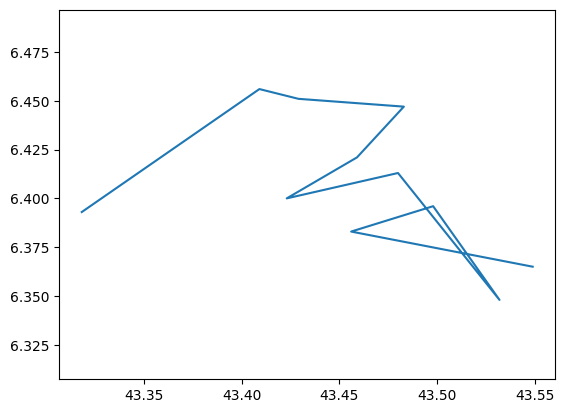

position in list =  74  index in df =  296


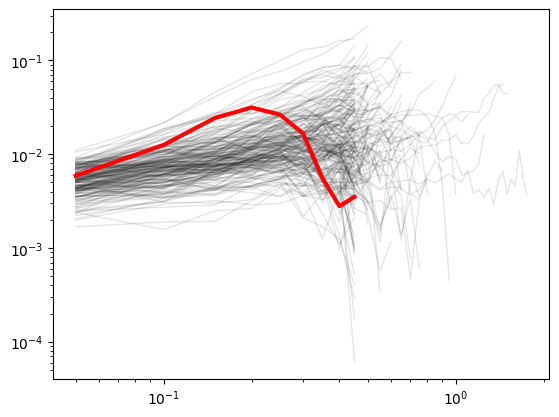

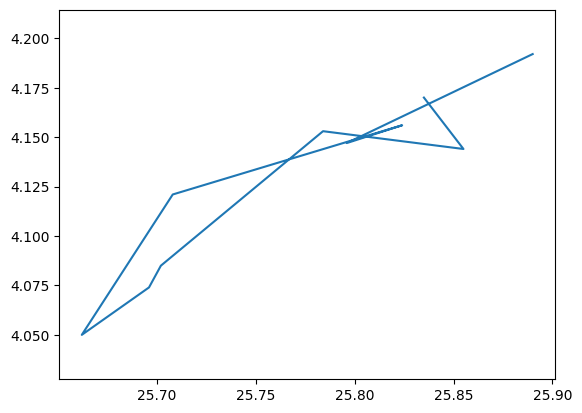

position in list =  75  index in df =  304


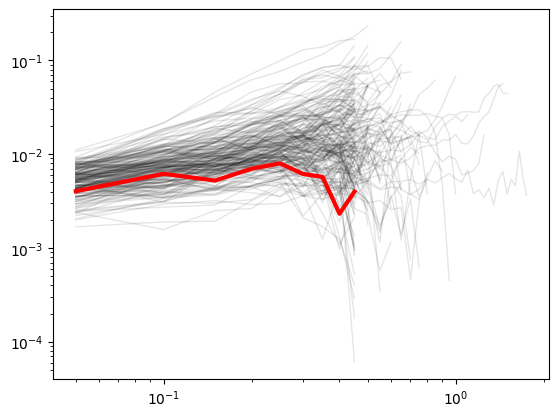

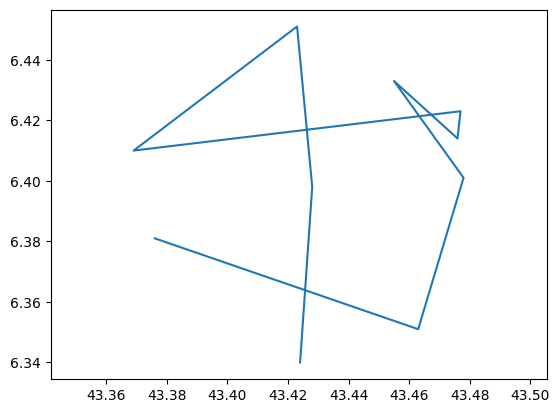

position in list =  76  index in df =  310


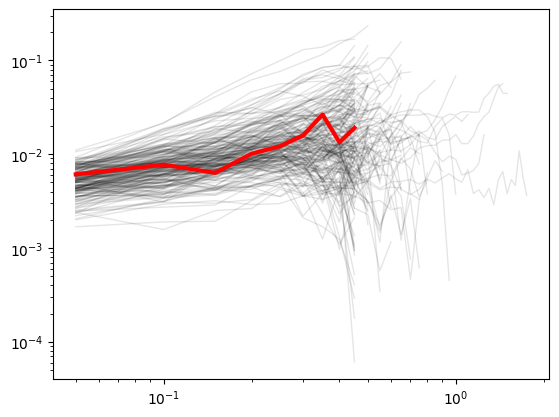

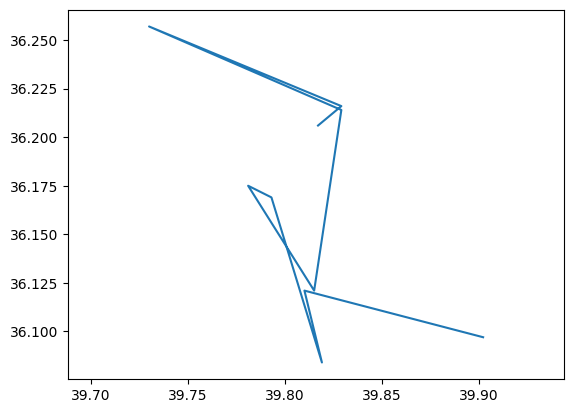

position in list =  77  index in df =  311


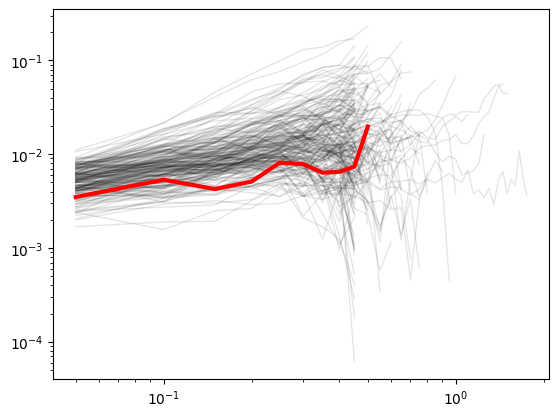

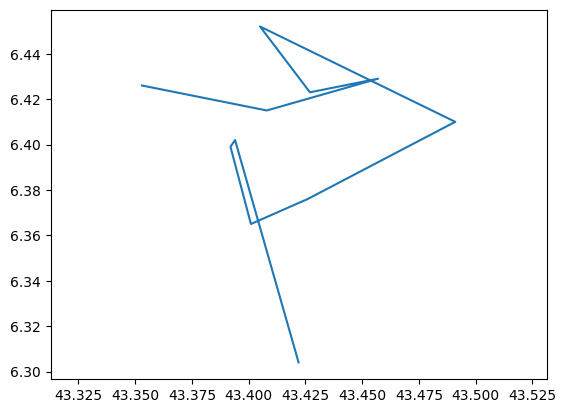

position in list =  78  index in df =  316


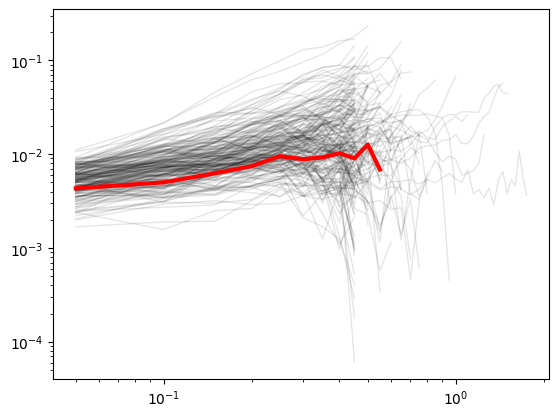

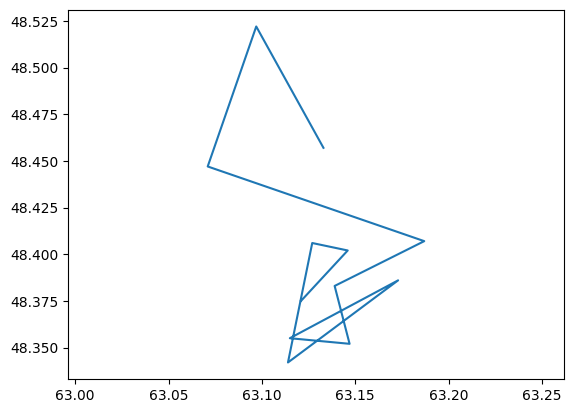

position in list =  79  index in df =  317


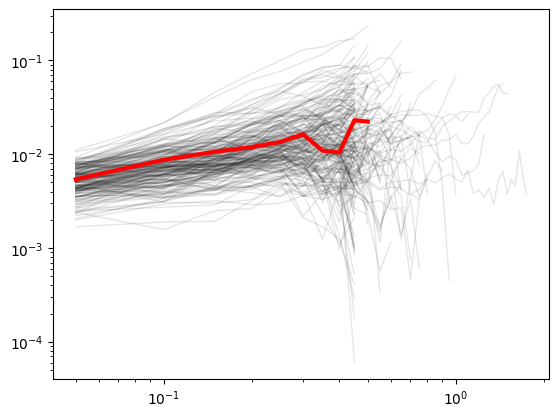

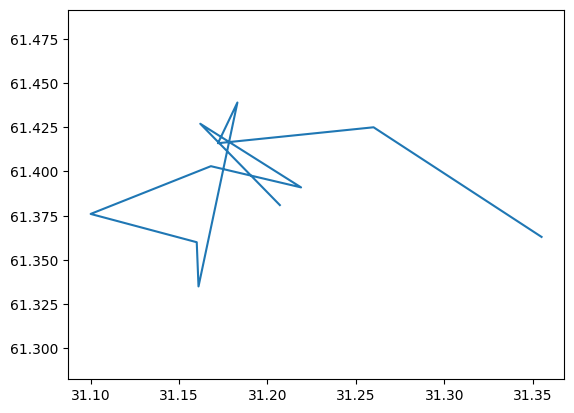

position in list =  80  index in df =  318


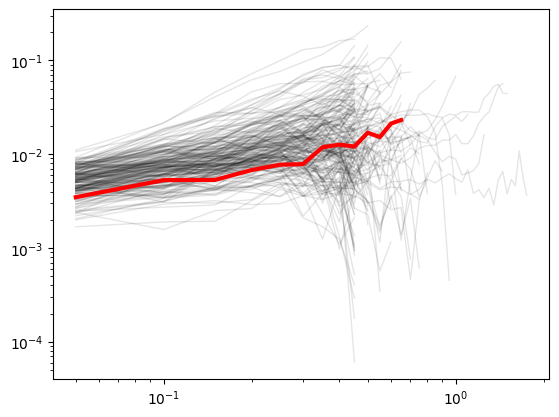

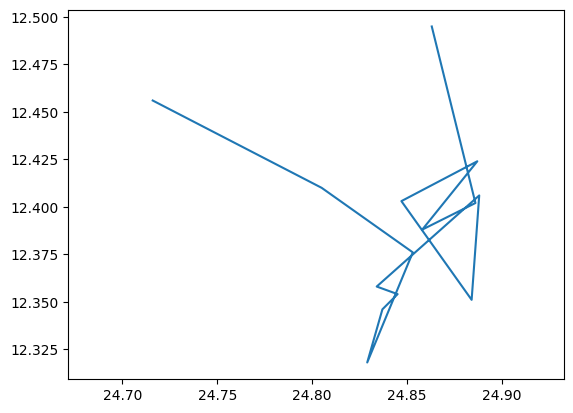

position in list =  81  index in df =  321


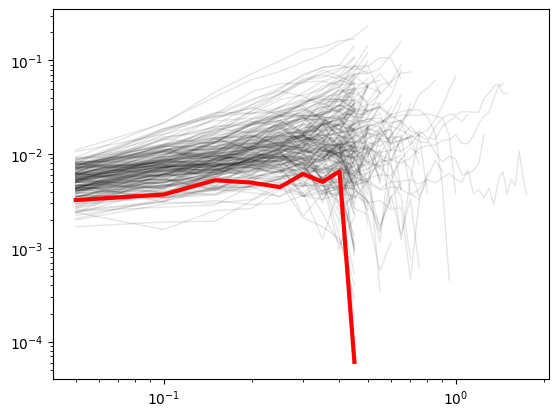

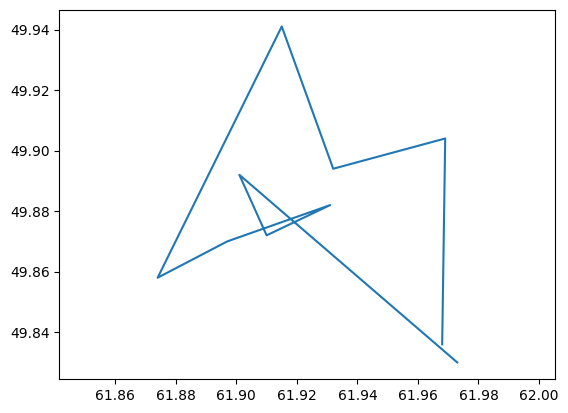

position in list =  82  index in df =  322


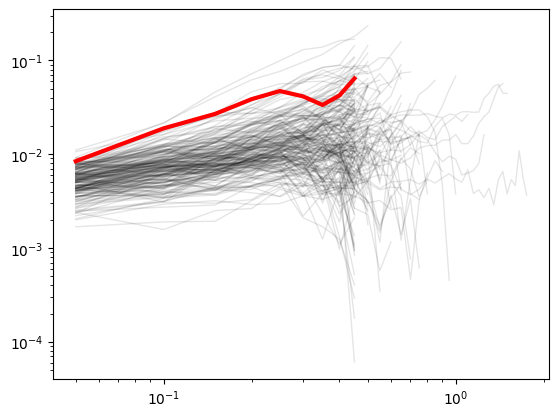

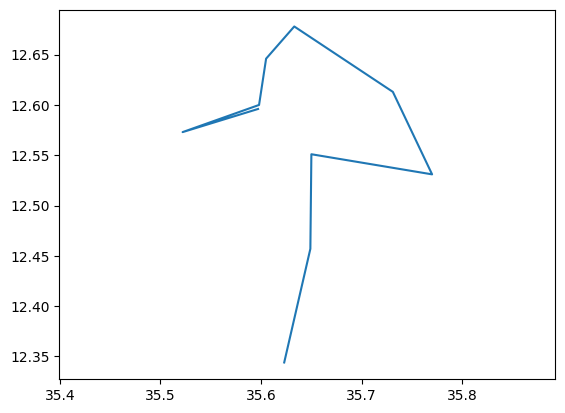

position in list =  83  index in df =  328


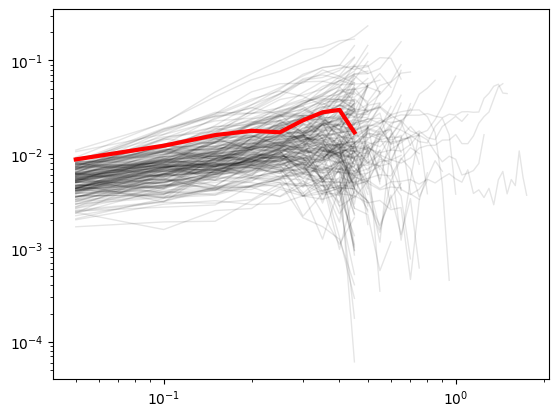

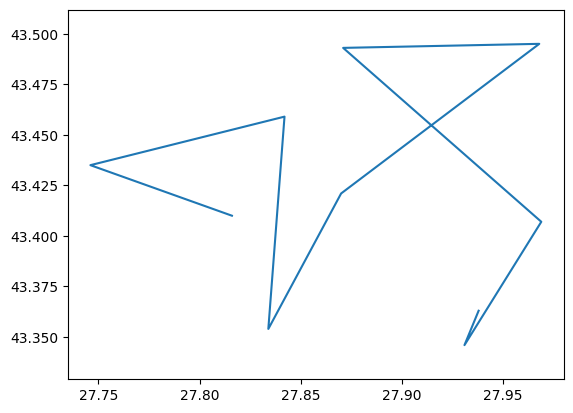

position in list =  84  index in df =  341


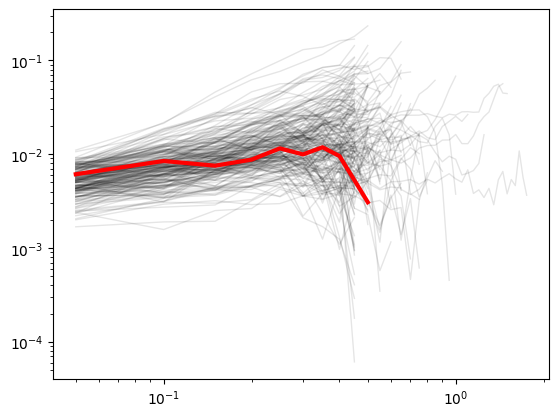

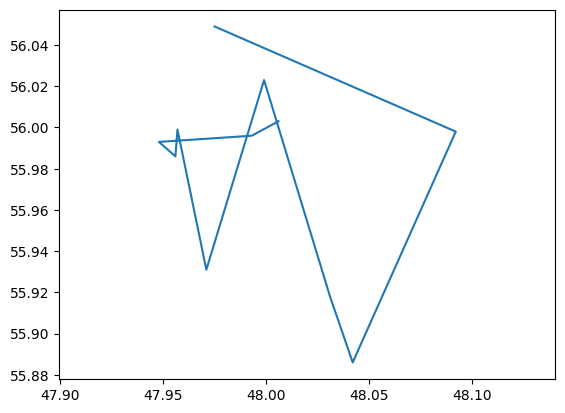

position in list =  85  index in df =  343


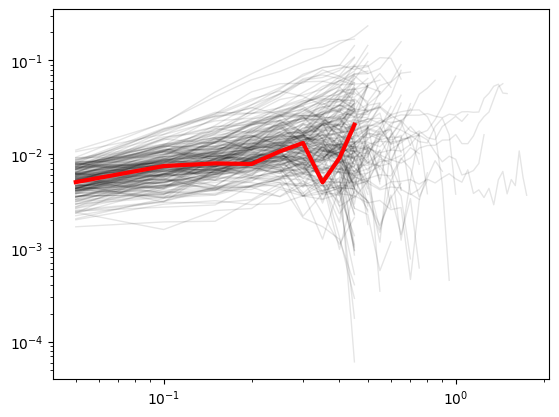

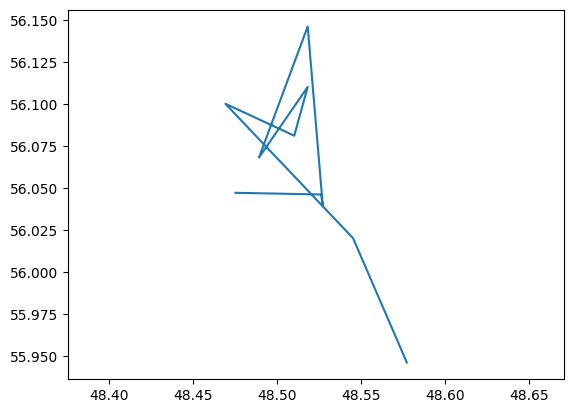

position in list =  86  index in df =  344


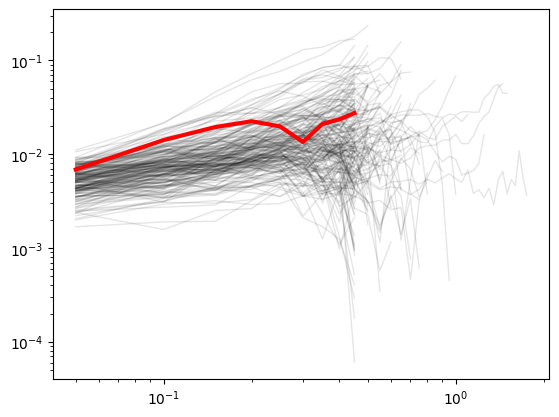

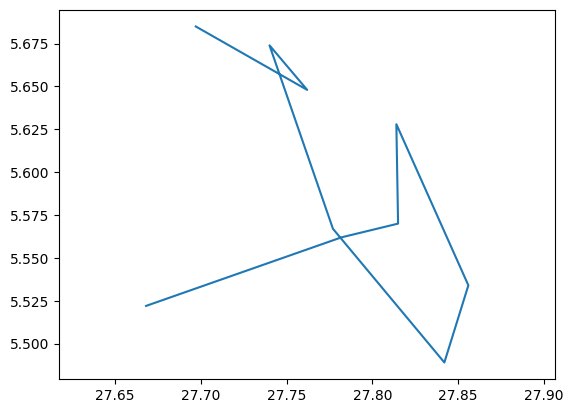

position in list =  87  index in df =  345


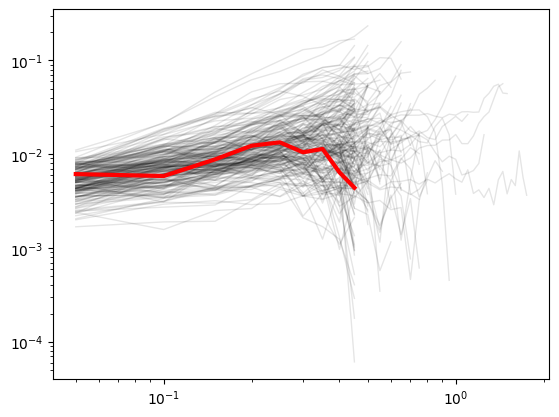

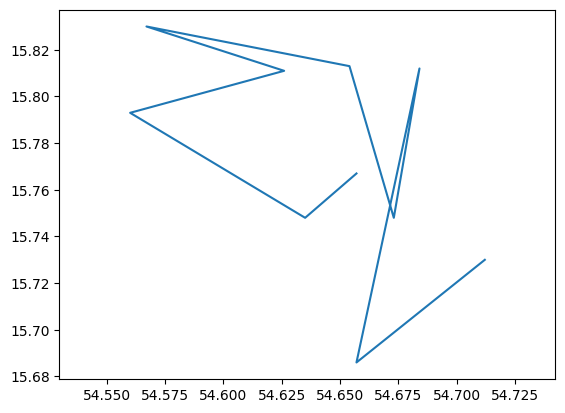

position in list =  88  index in df =  347


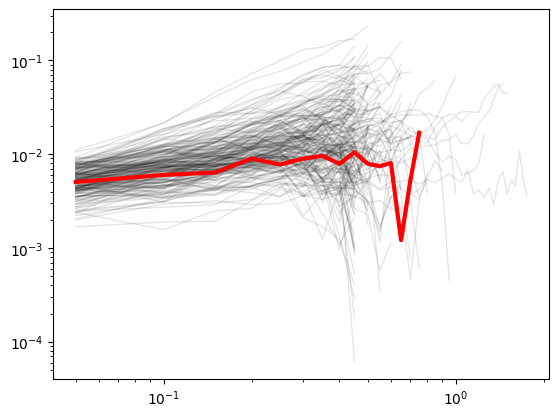

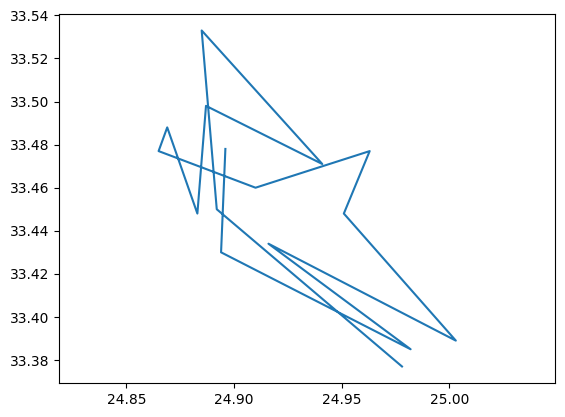

position in list =  89  index in df =  349


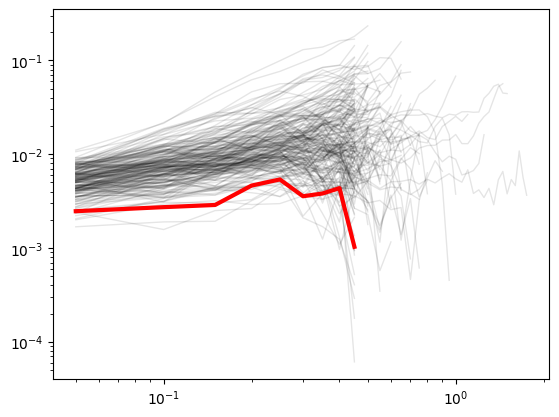

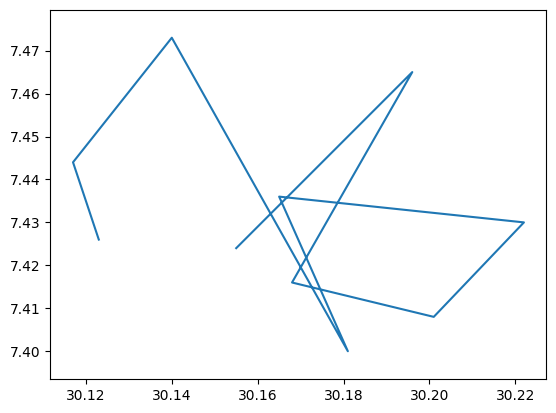

position in list =  90  index in df =  351


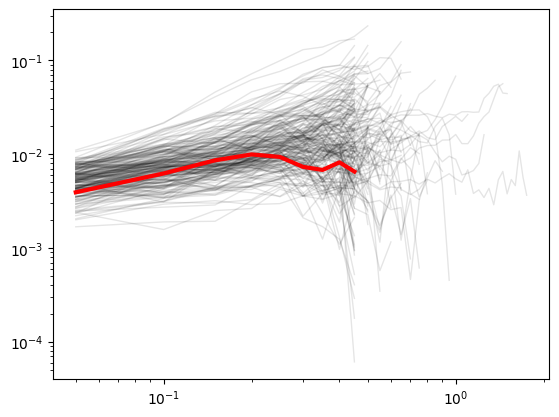

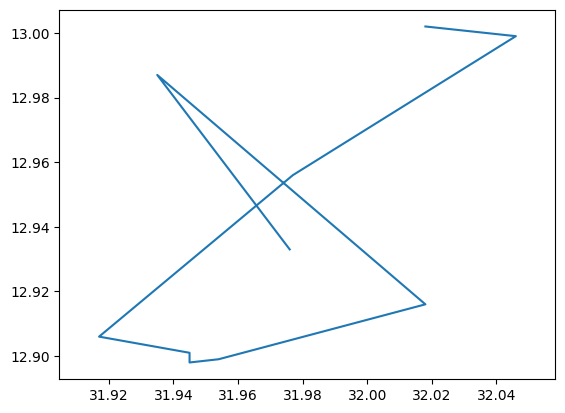

position in list =  91  index in df =  352


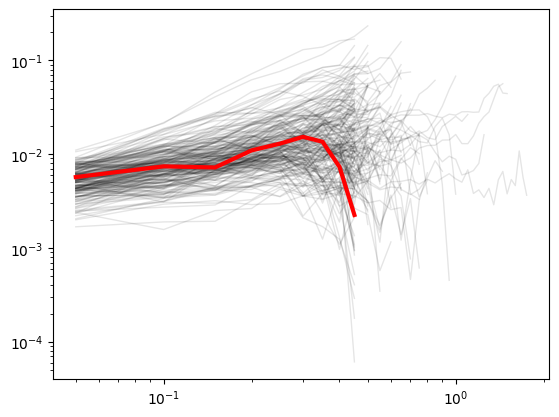

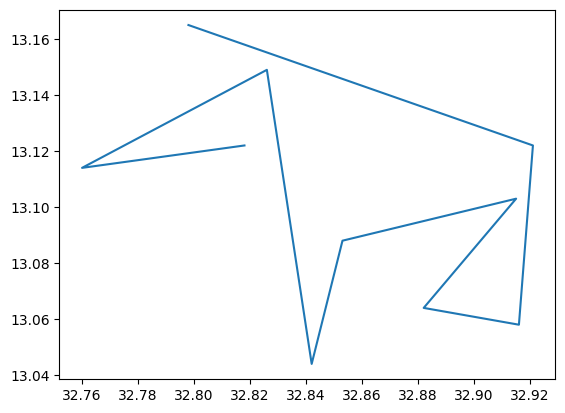

position in list =  92  index in df =  359


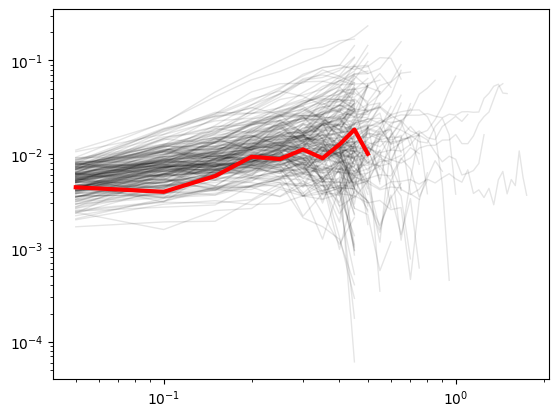

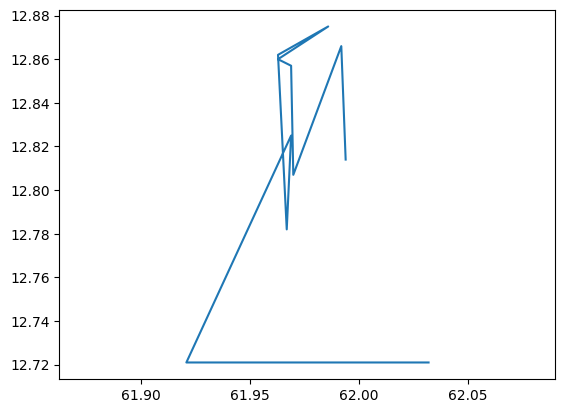

position in list =  93  index in df =  361


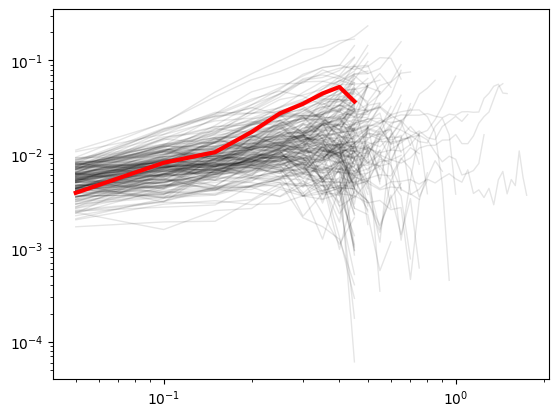

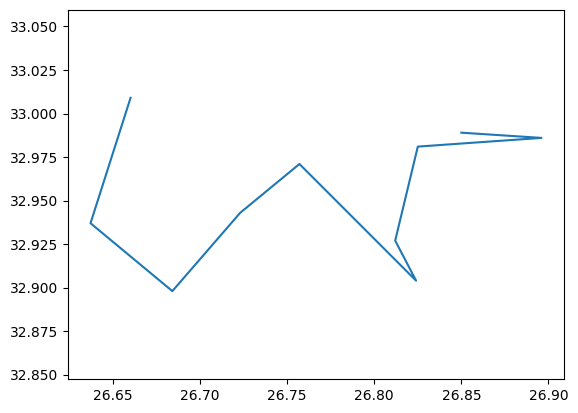

position in list =  94  index in df =  365


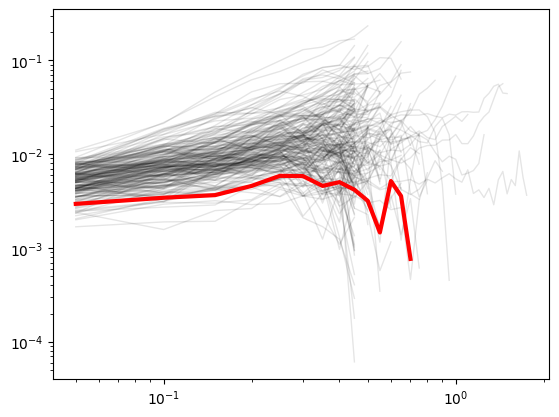

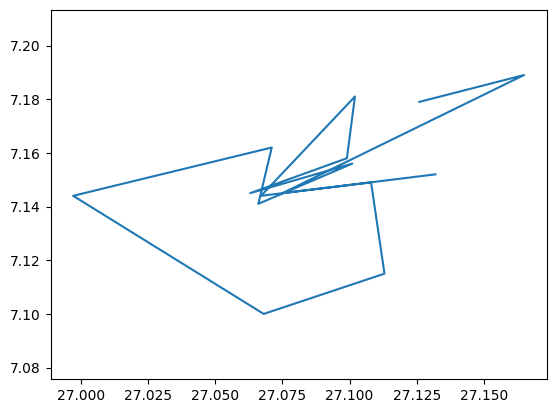

position in list =  95  index in df =  366


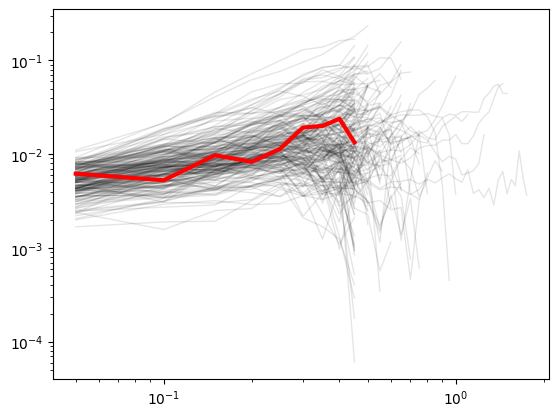

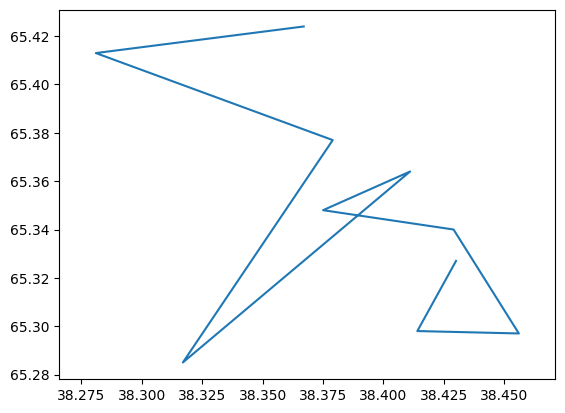

position in list =  96  index in df =  367


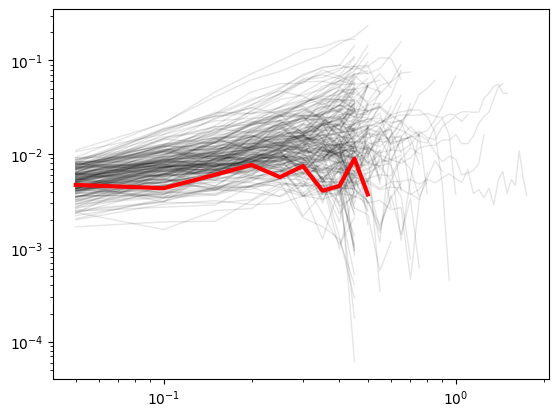

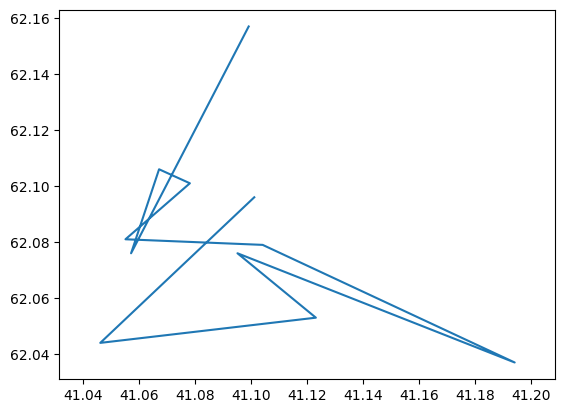

position in list =  97  index in df =  368


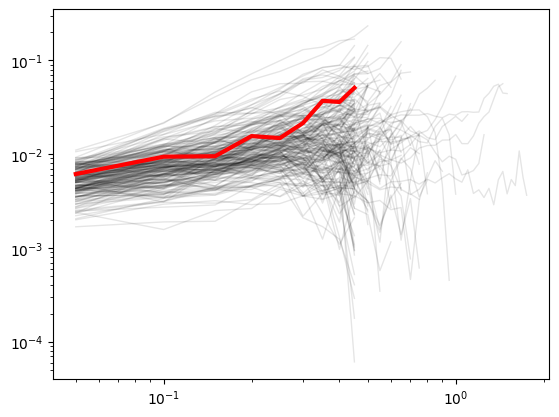

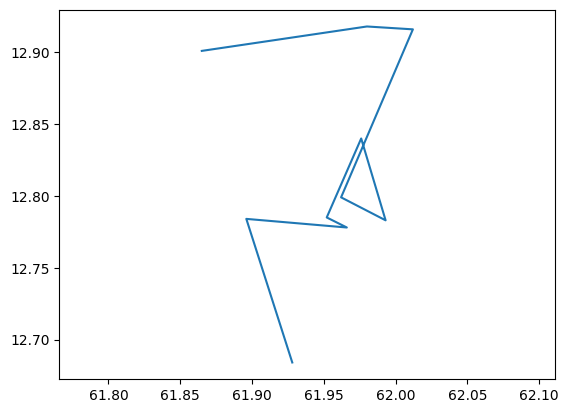

position in list =  98  index in df =  375


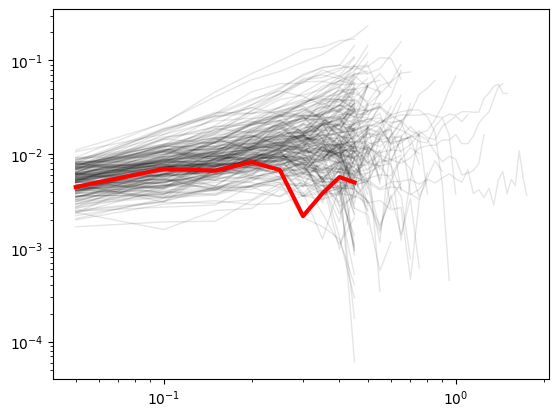

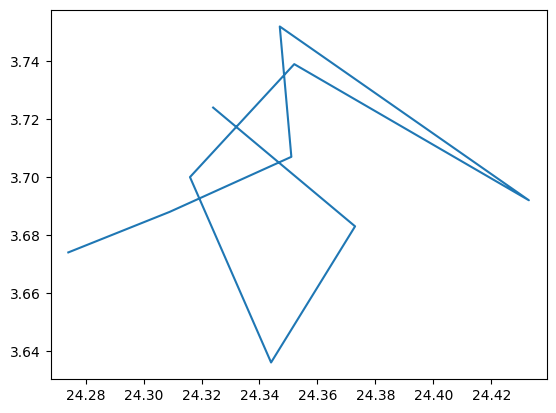

position in list =  99  index in df =  377


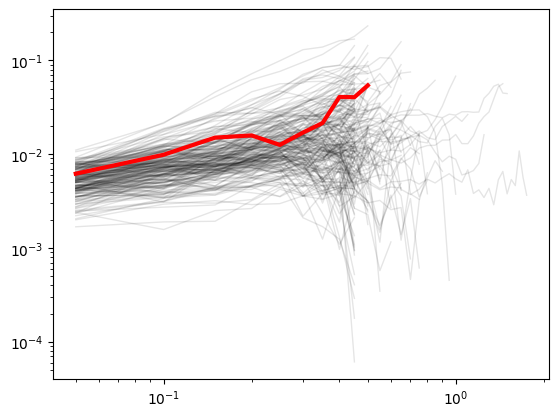

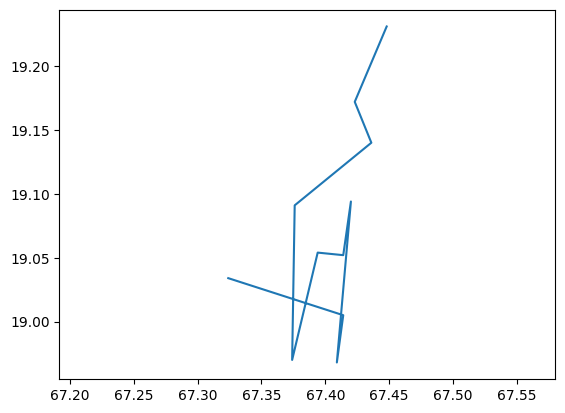

position in list =  100  index in df =  382


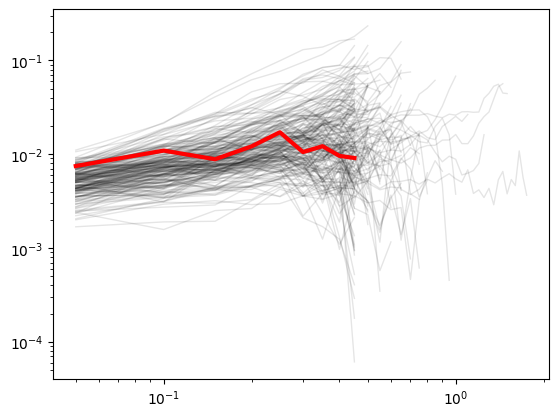

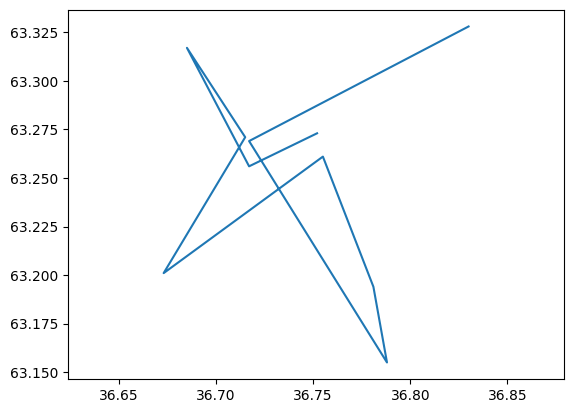

position in list =  101  index in df =  383


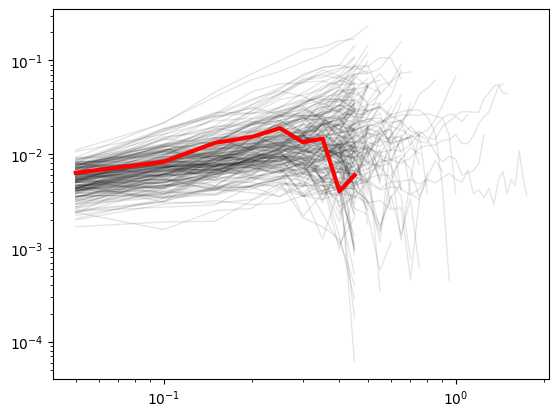

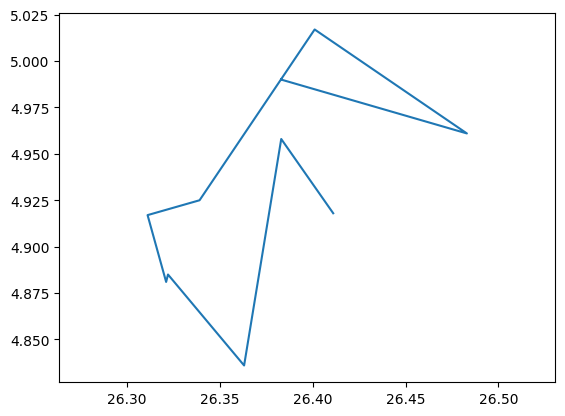

position in list =  102  index in df =  389


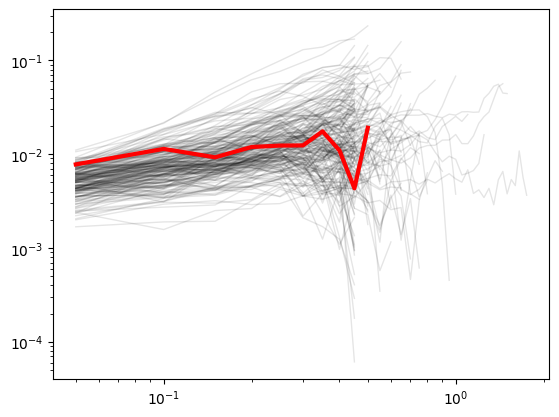

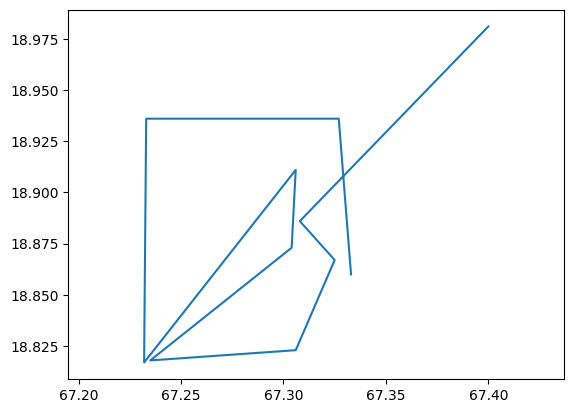

position in list =  103  index in df =  395


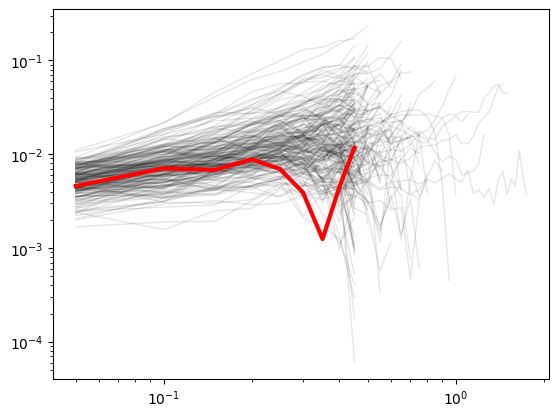

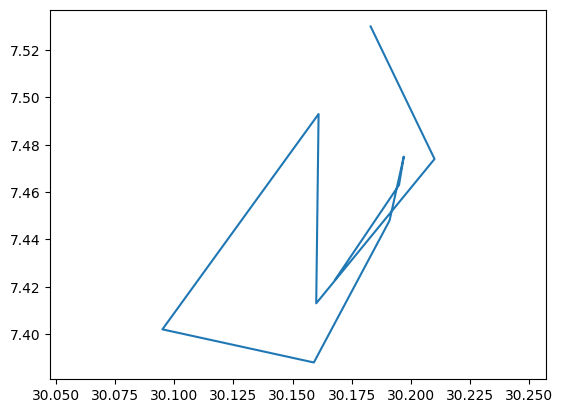

position in list =  104  index in df =  396


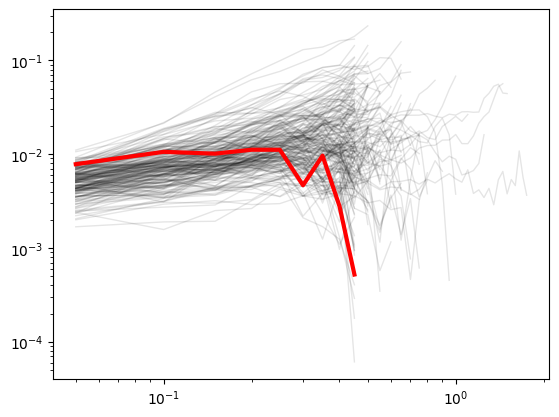

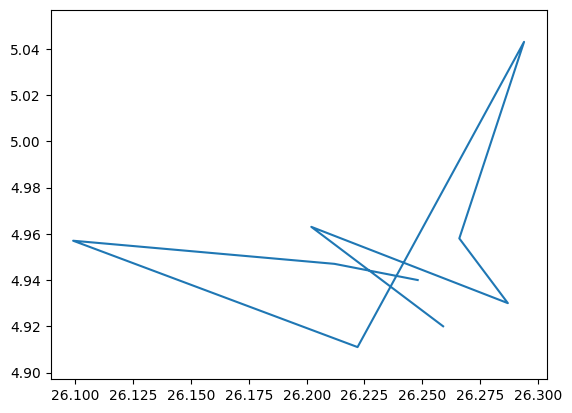

position in list =  105  index in df =  401


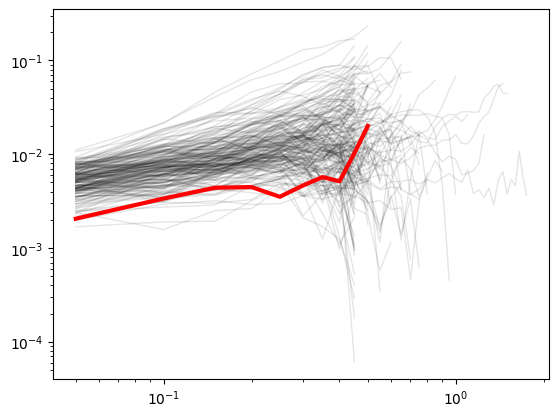

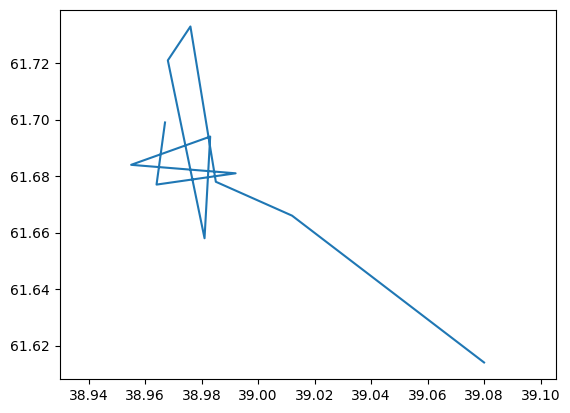

position in list =  106  index in df =  402


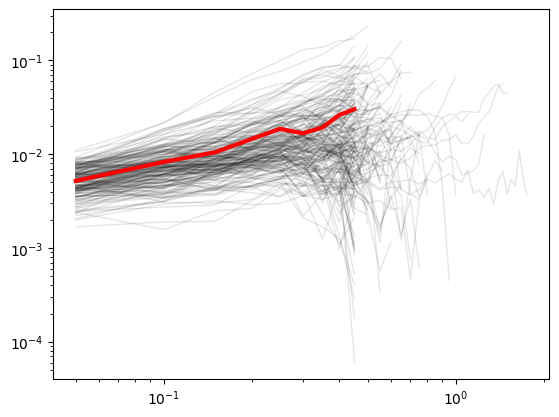

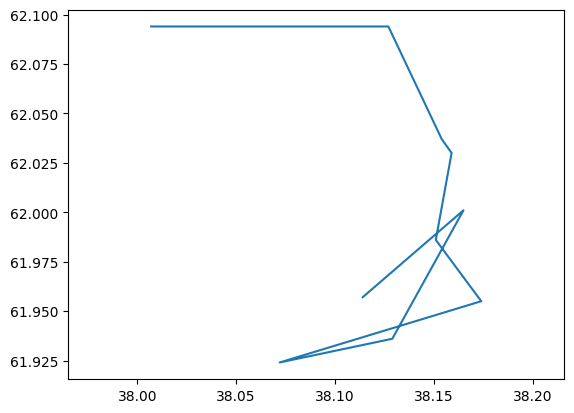

position in list =  107  index in df =  404


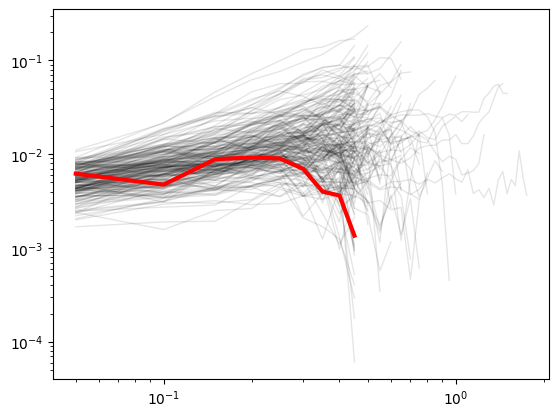

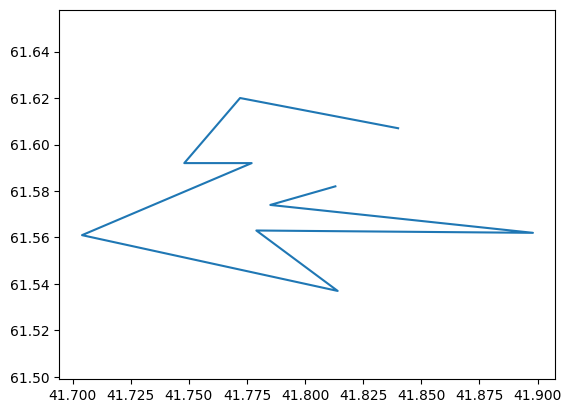

position in list =  108  index in df =  405


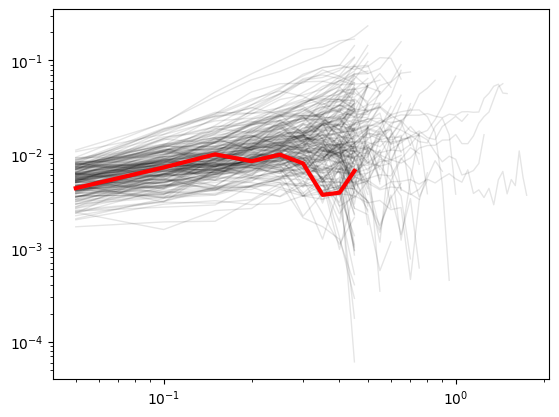

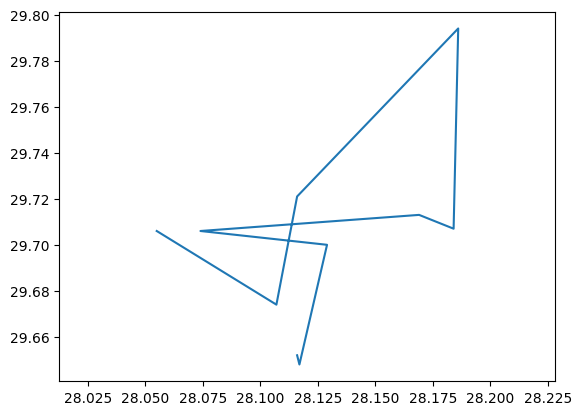

position in list =  109  index in df =  410


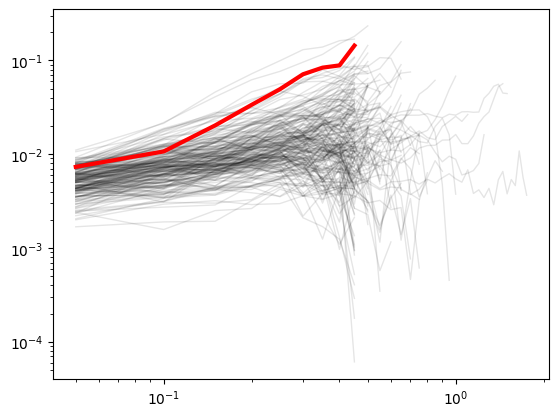

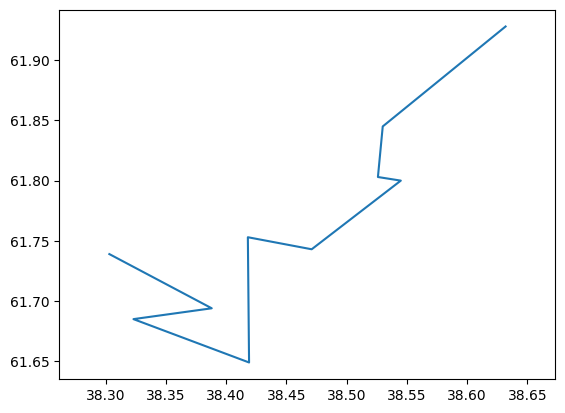

position in list =  110  index in df =  411


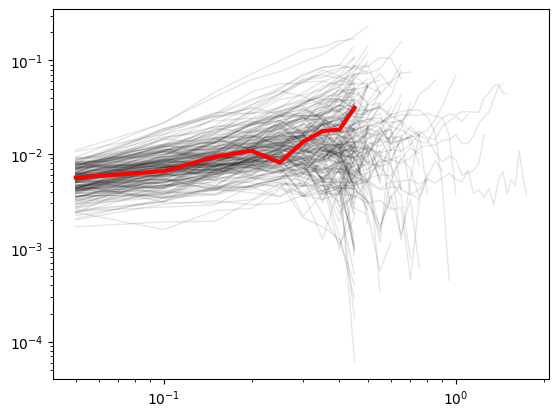

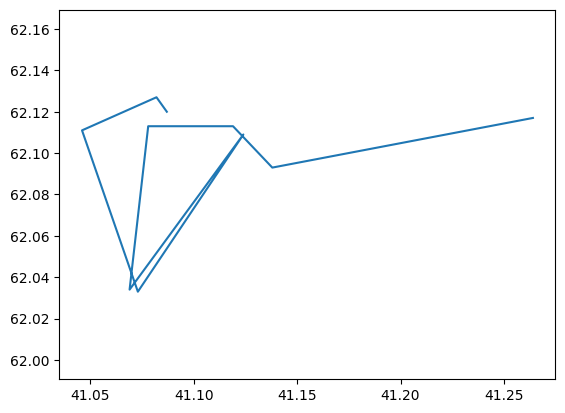

position in list =  111  index in df =  416


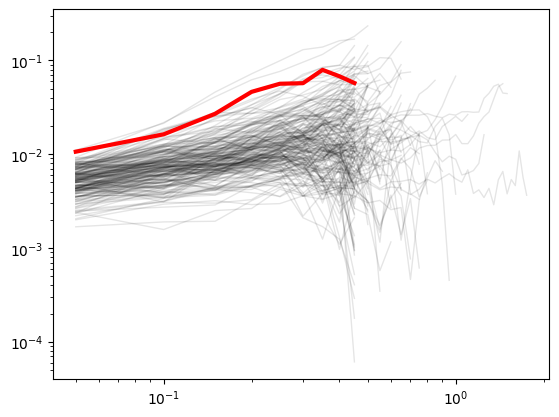

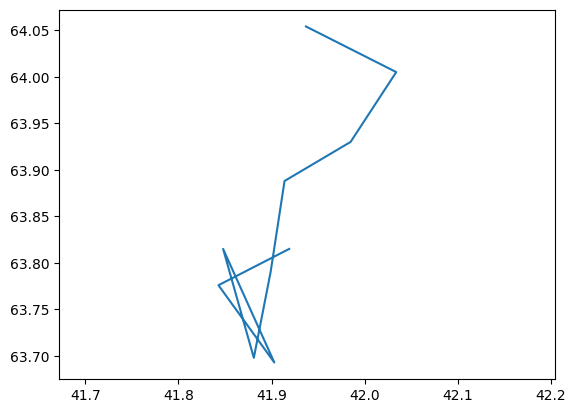

position in list =  112  index in df =  417


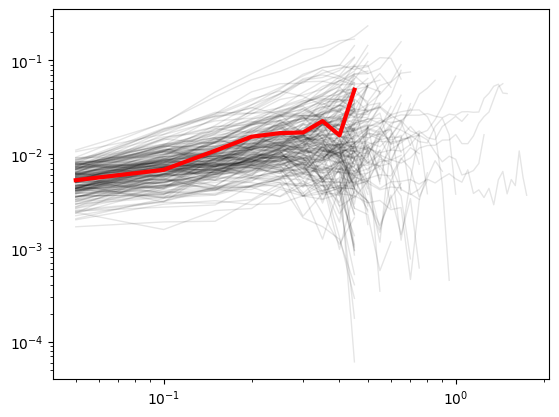

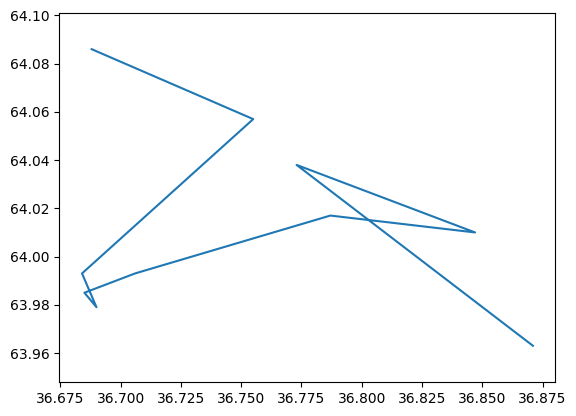

position in list =  113  index in df =  419


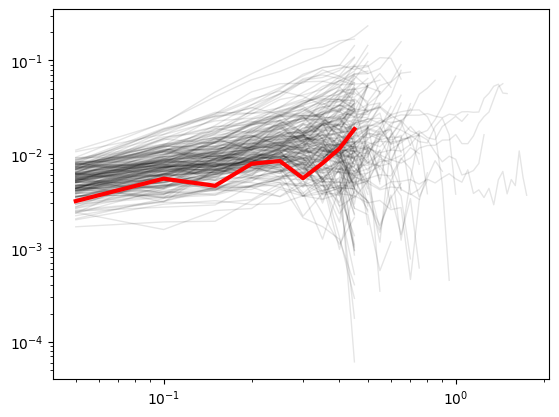

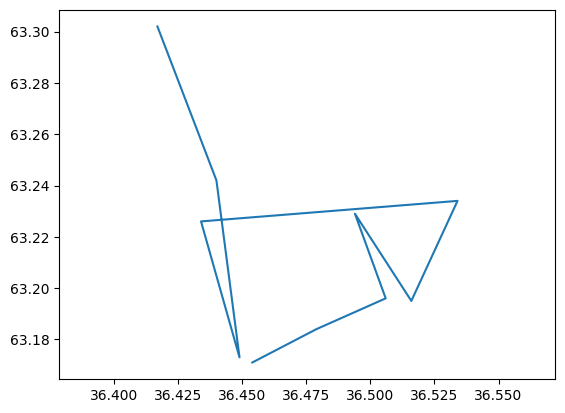

position in list =  114  index in df =  420


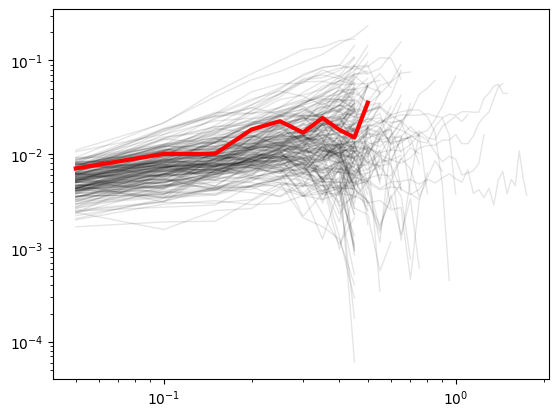

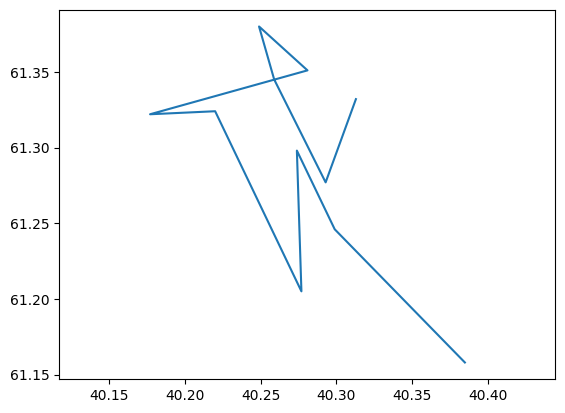

position in list =  115  index in df =  421


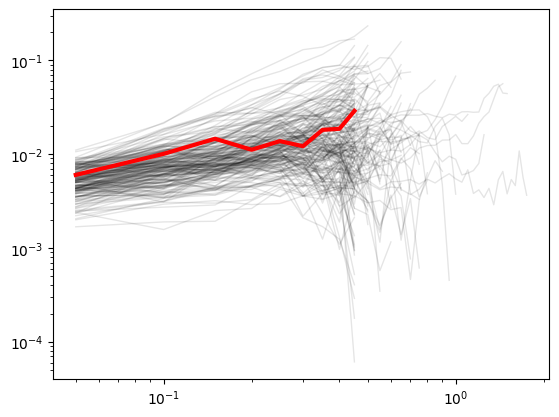

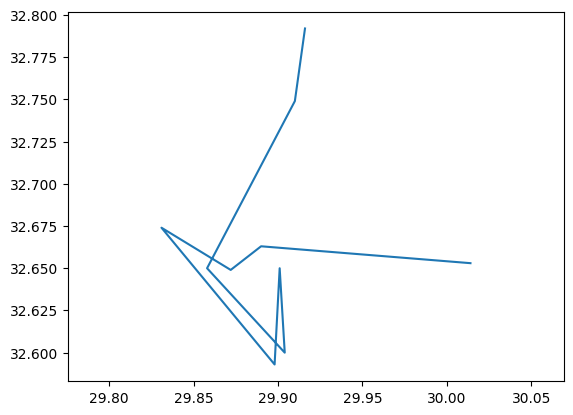

position in list =  116  index in df =  428


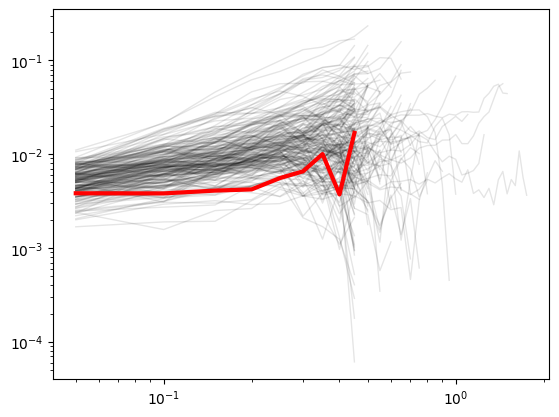

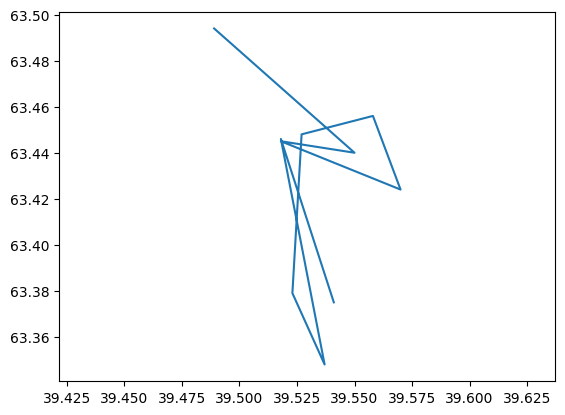

position in list =  117  index in df =  439


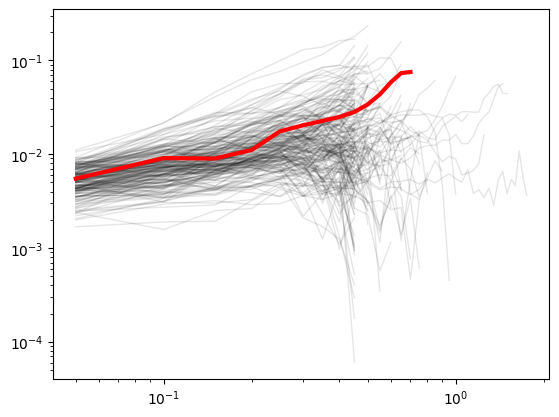

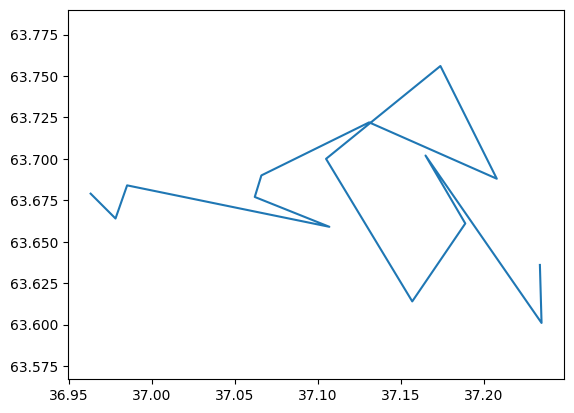

position in list =  118  index in df =  448


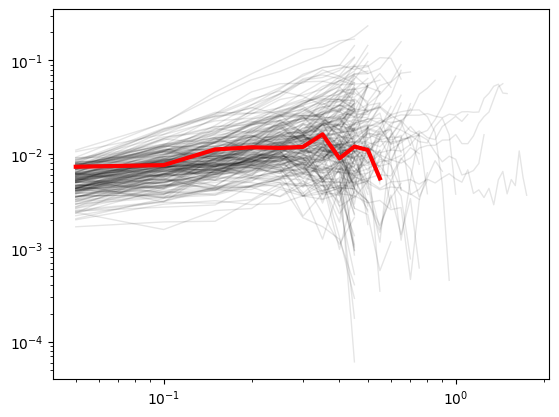

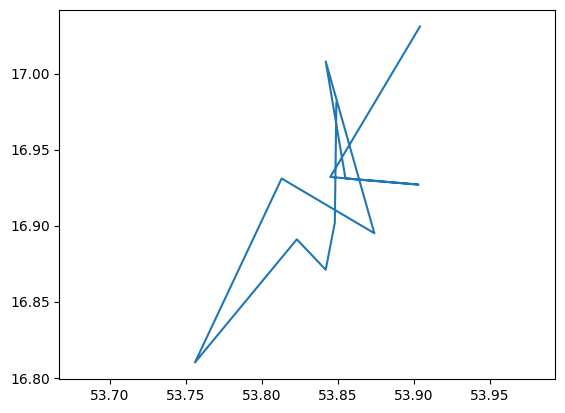

position in list =  119  index in df =  450


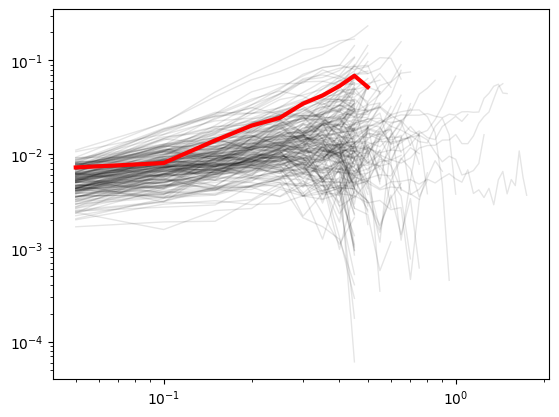

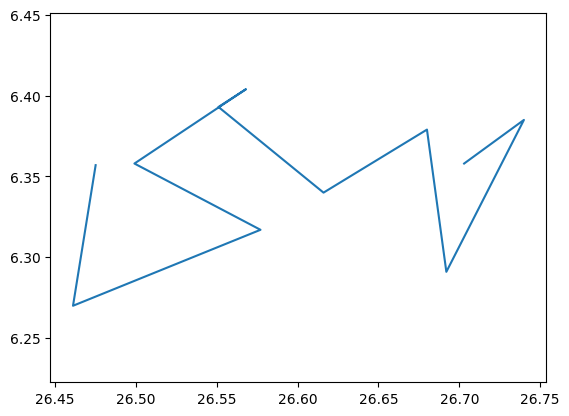

position in list =  120  index in df =  457


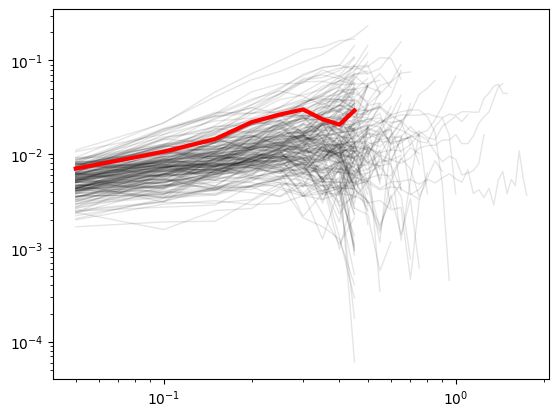

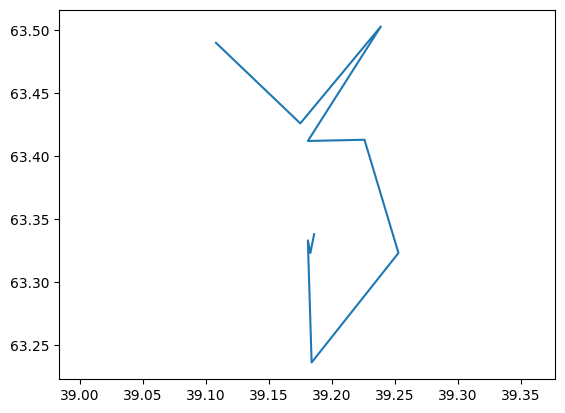

position in list =  121  index in df =  458


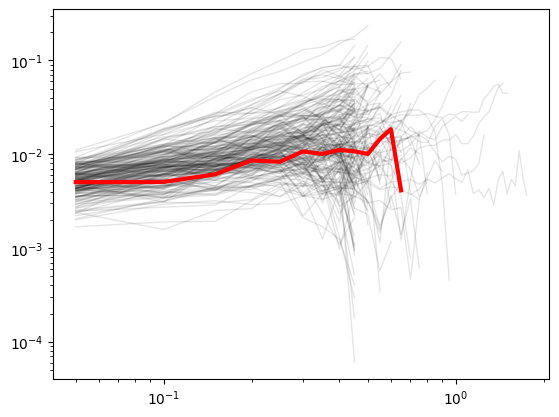

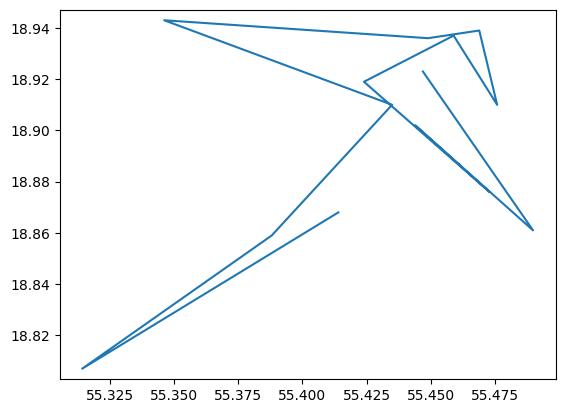

position in list =  122  index in df =  462


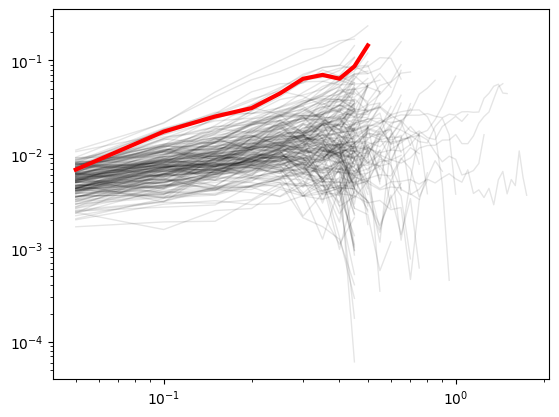

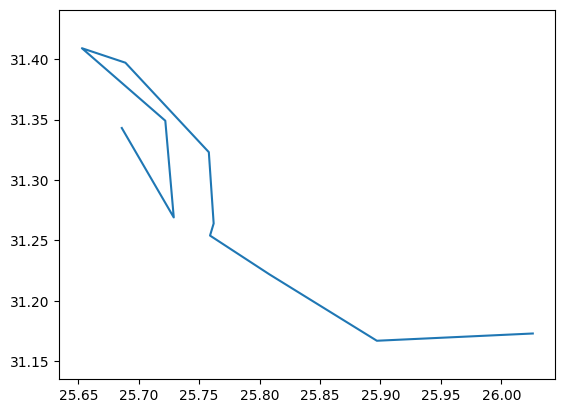

position in list =  123  index in df =  463


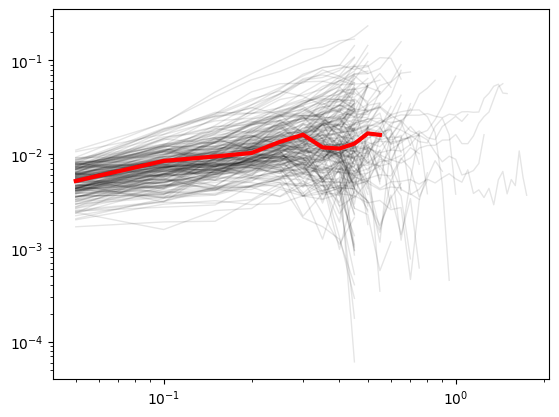

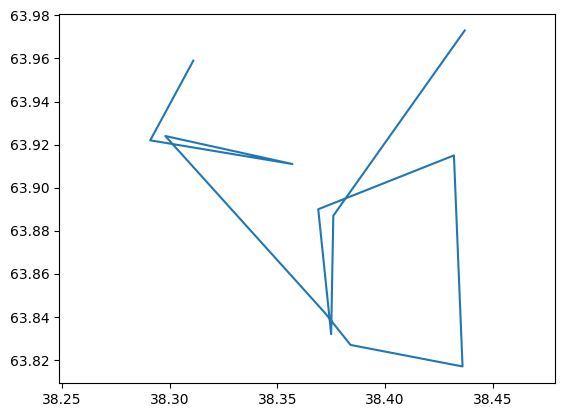

position in list =  124  index in df =  468


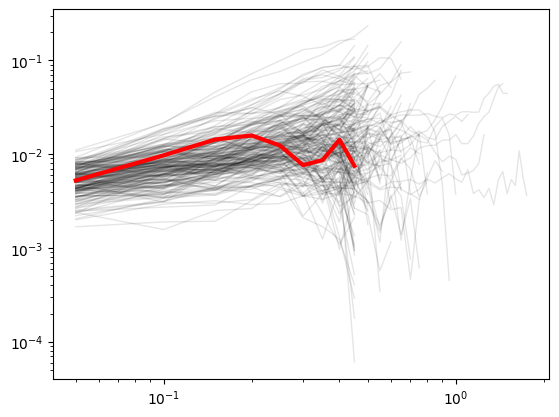

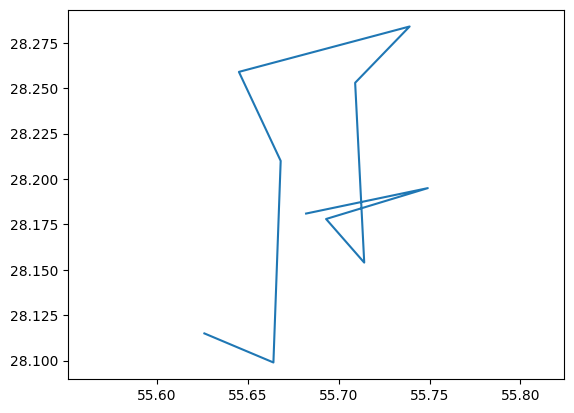

position in list =  125  index in df =  477


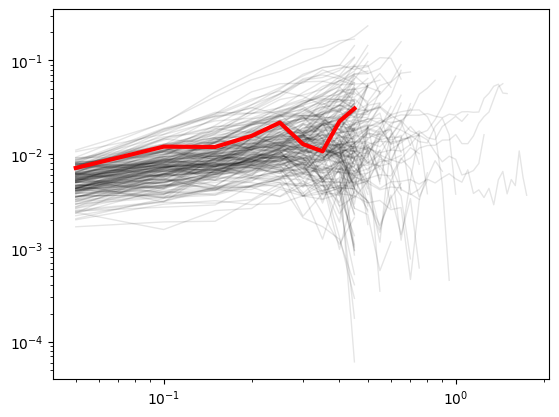

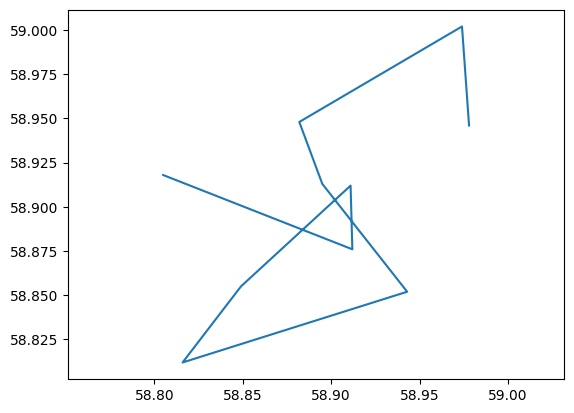

position in list =  126  index in df =  478


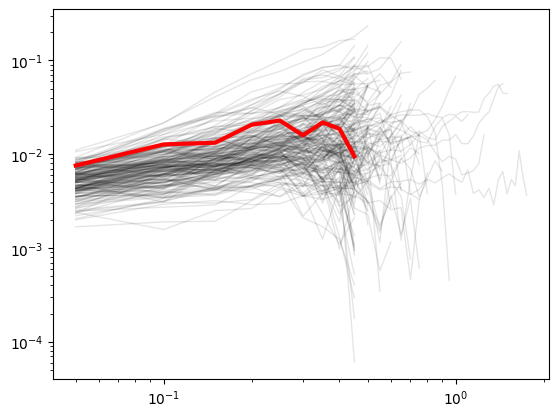

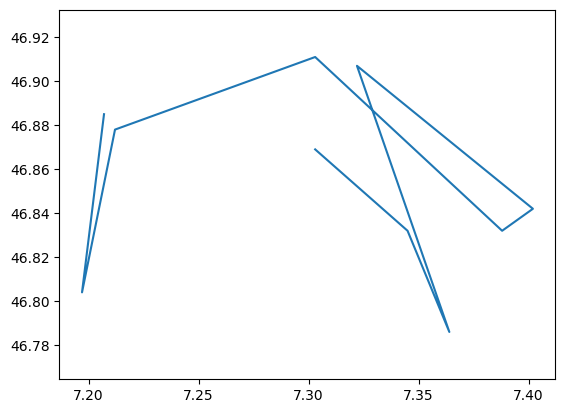

position in list =  127  index in df =  481


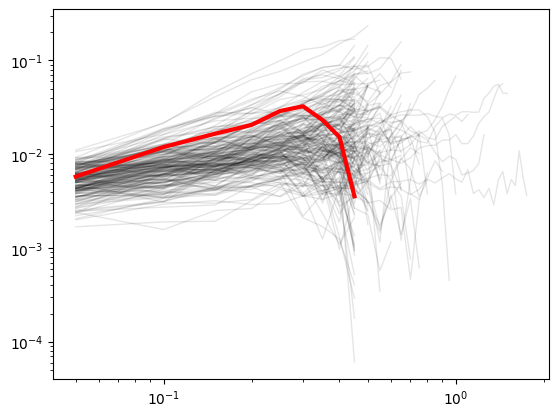

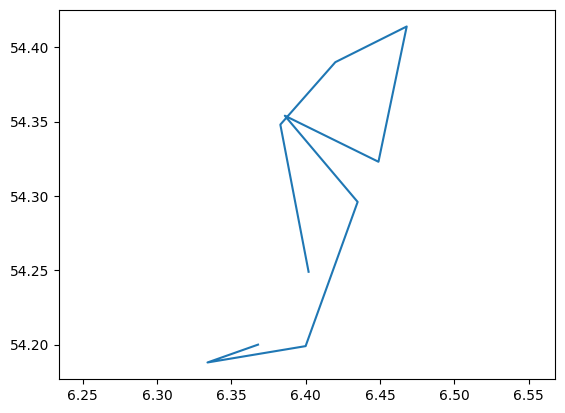

position in list =  128  index in df =  492


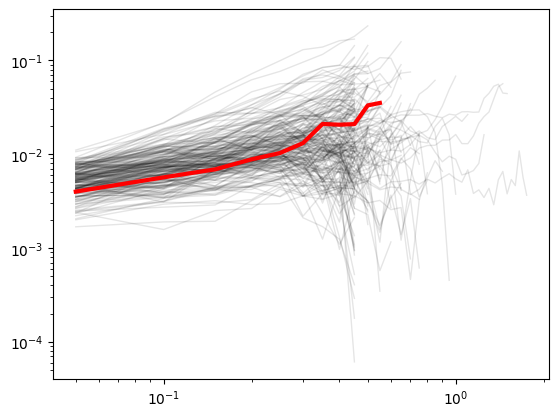

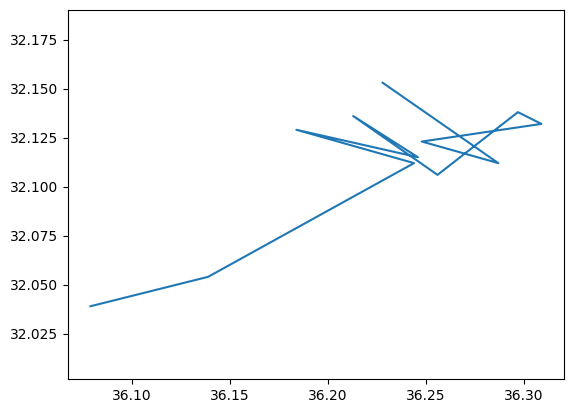

position in list =  129  index in df =  496


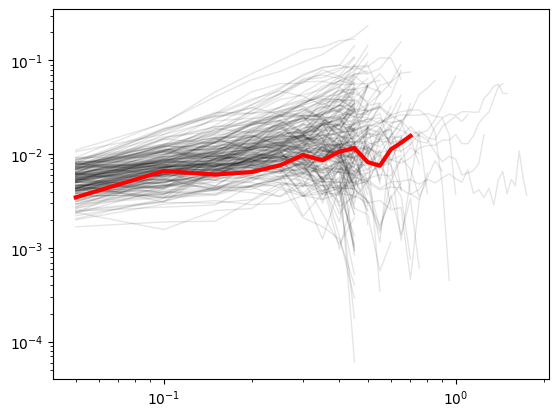

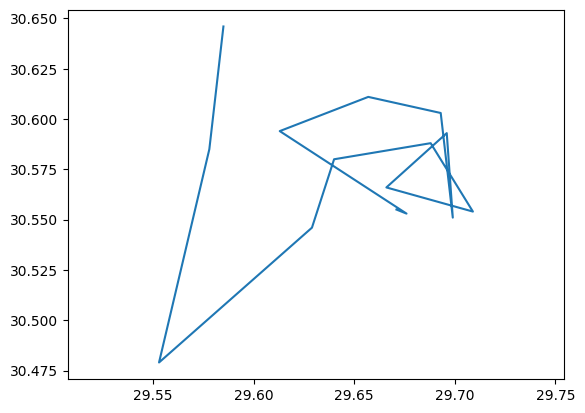

position in list =  130  index in df =  509


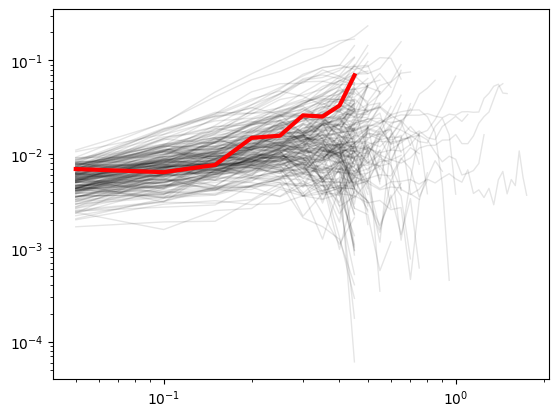

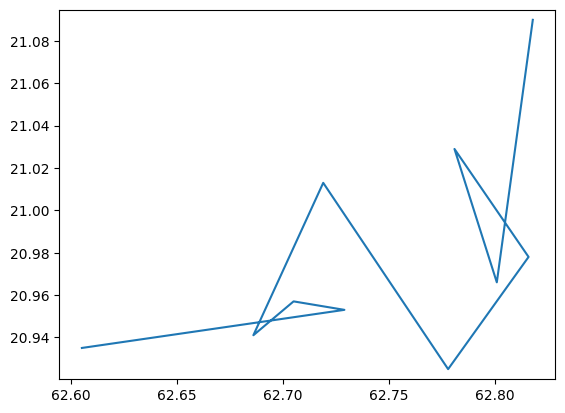

position in list =  131  index in df =  527


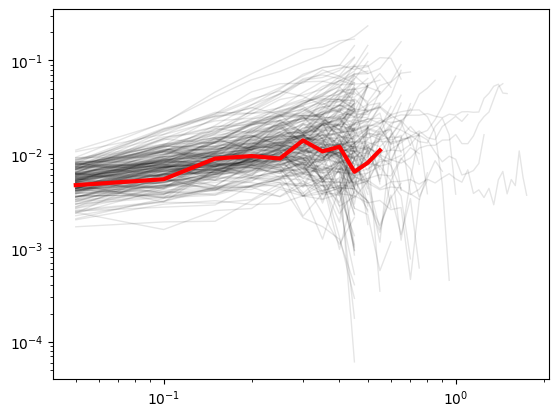

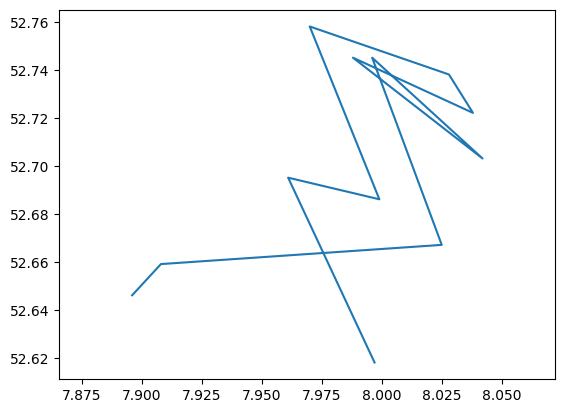

position in list =  132  index in df =  557


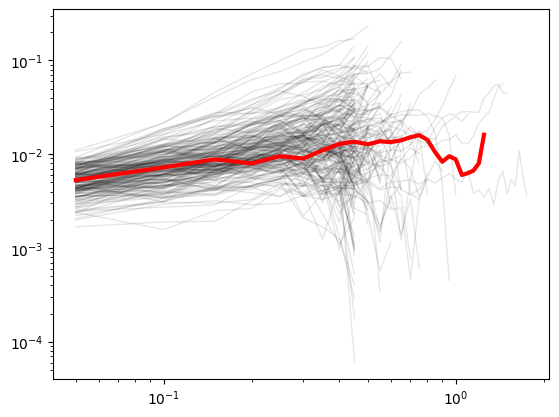

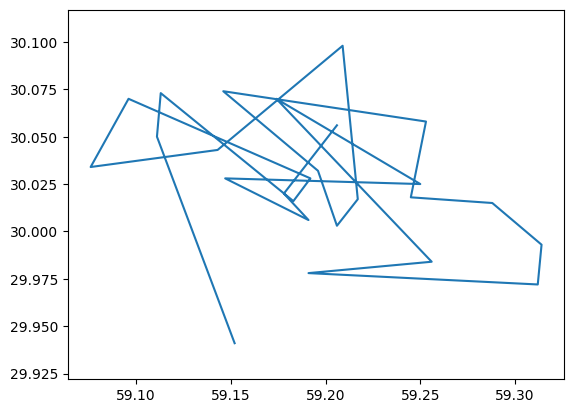

position in list =  133  index in df =  559


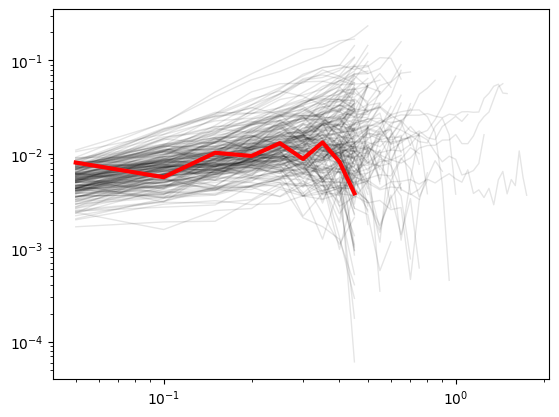

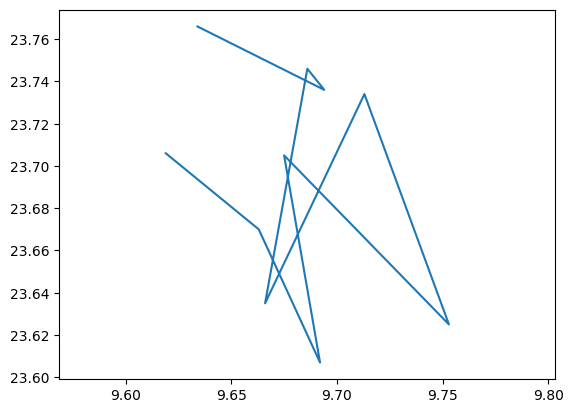

position in list =  134  index in df =  561


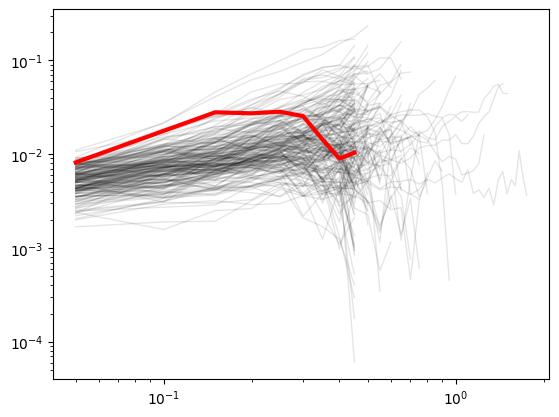

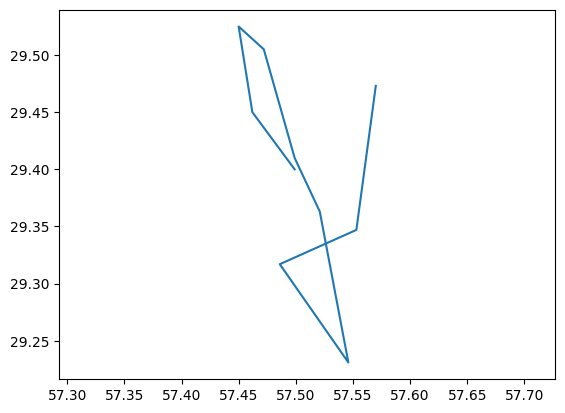

position in list =  135  index in df =  569


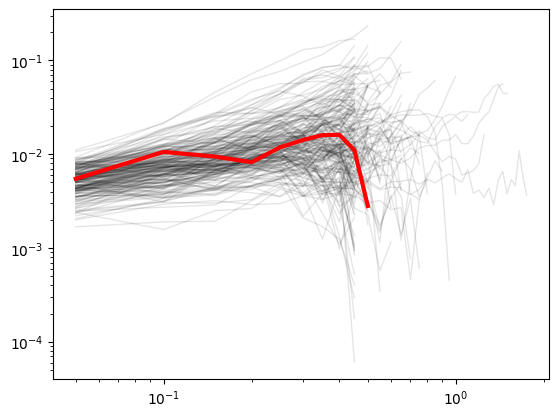

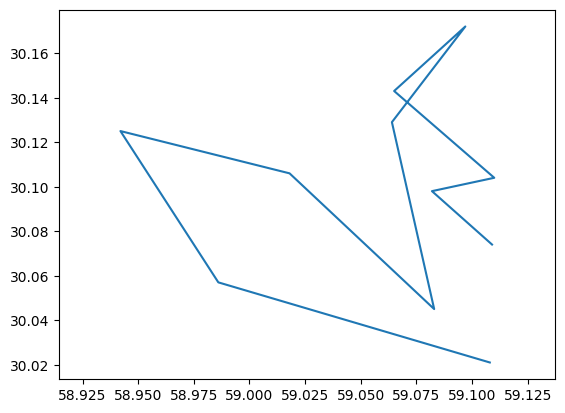

position in list =  136  index in df =  577


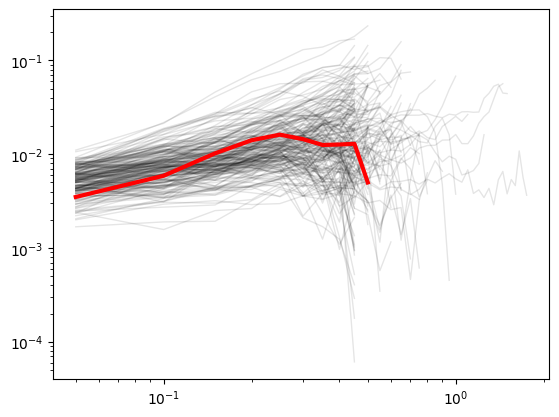

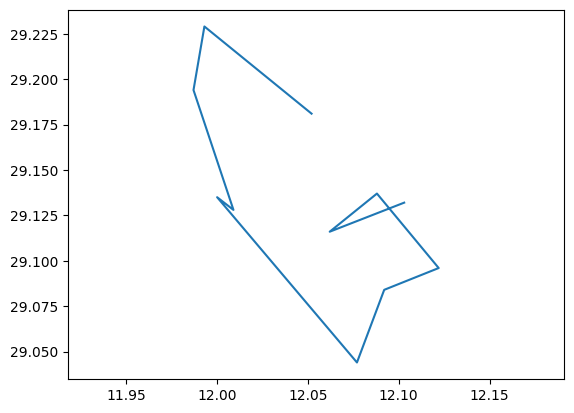

position in list =  137  index in df =  582


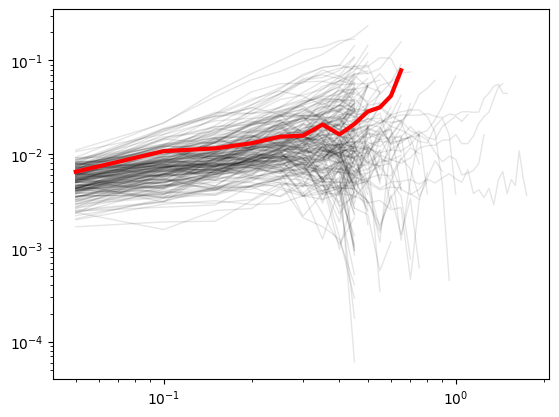

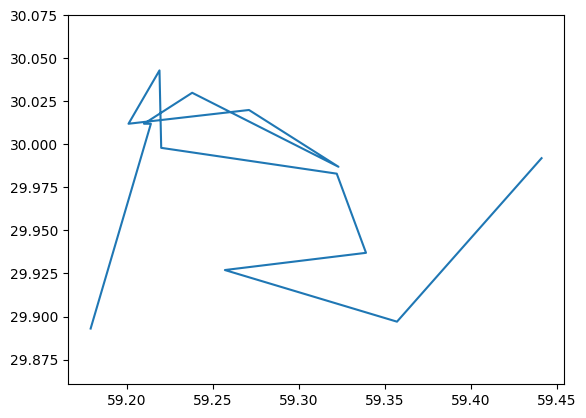

position in list =  138  index in df =  583


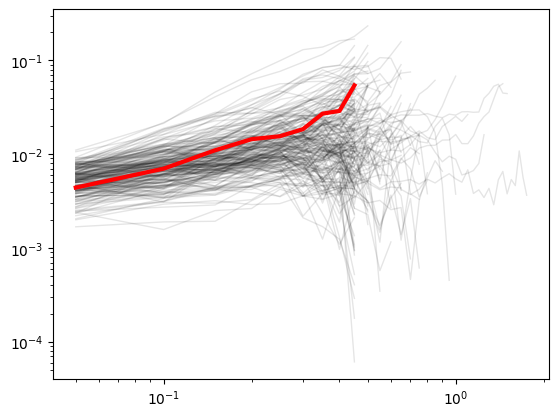

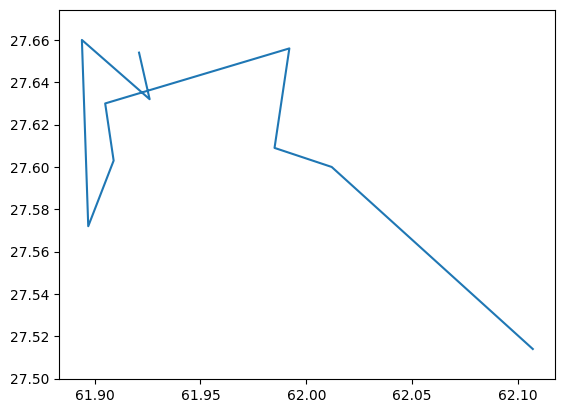

position in list =  139  index in df =  590


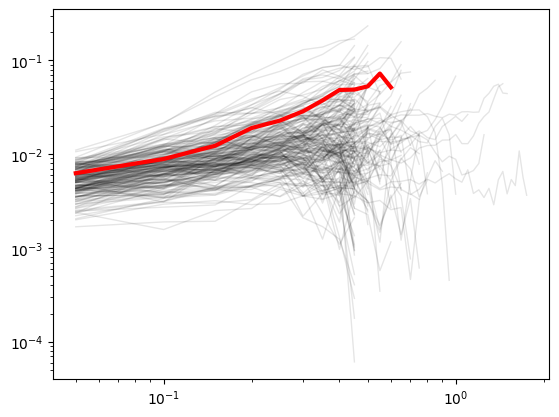

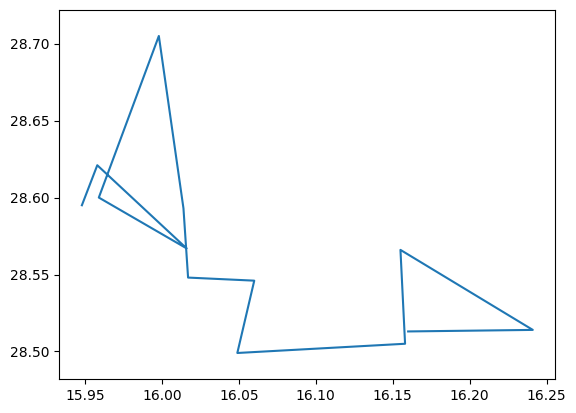

position in list =  140  index in df =  591


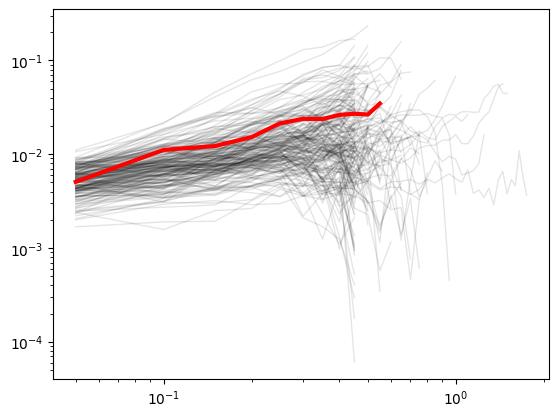

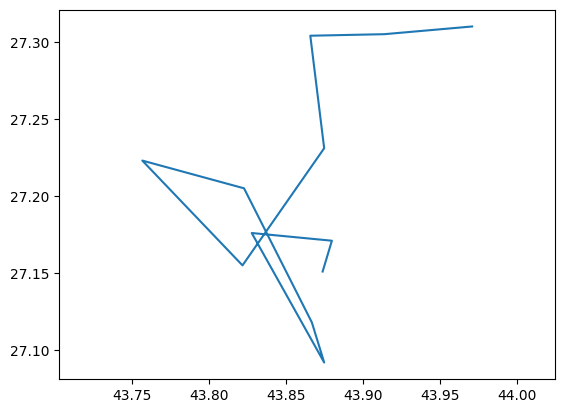

position in list =  141  index in df =  595


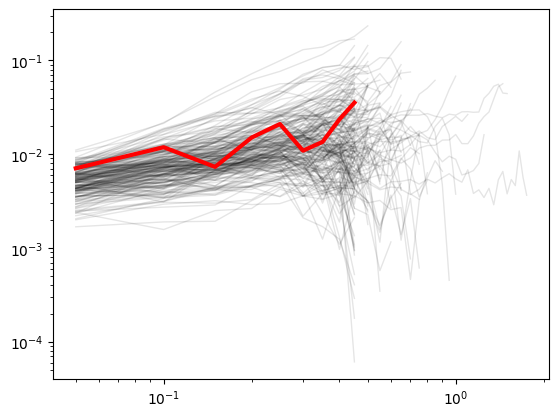

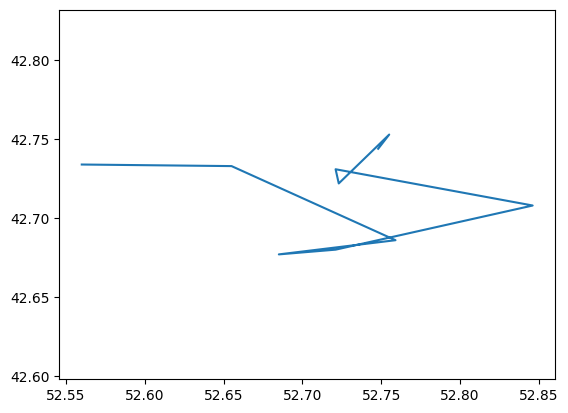

position in list =  142  index in df =  599


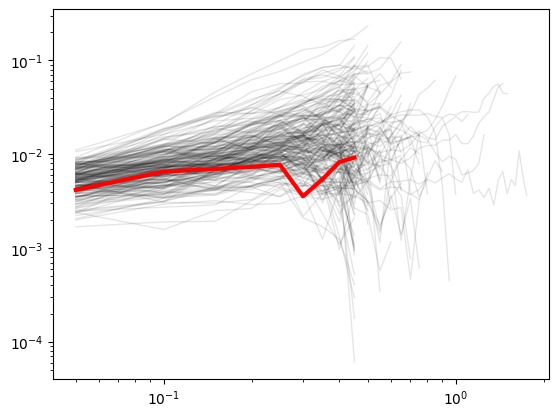

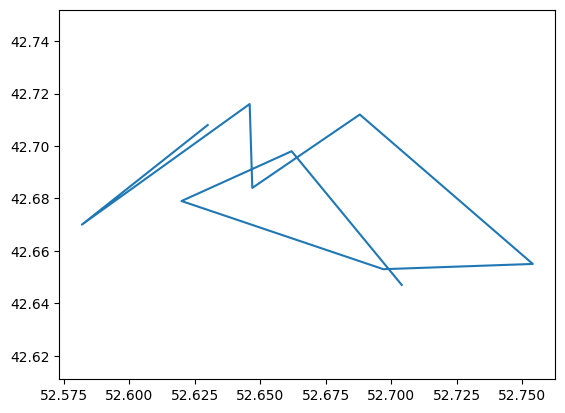

position in list =  143  index in df =  604


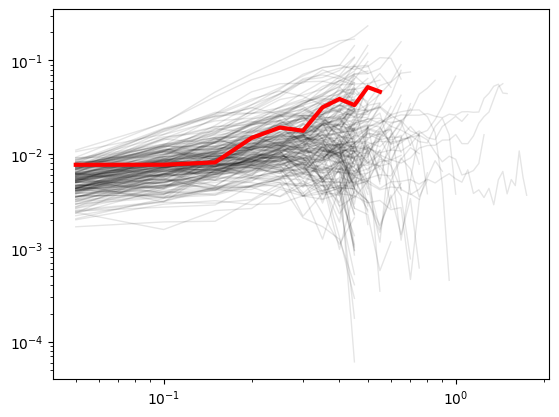

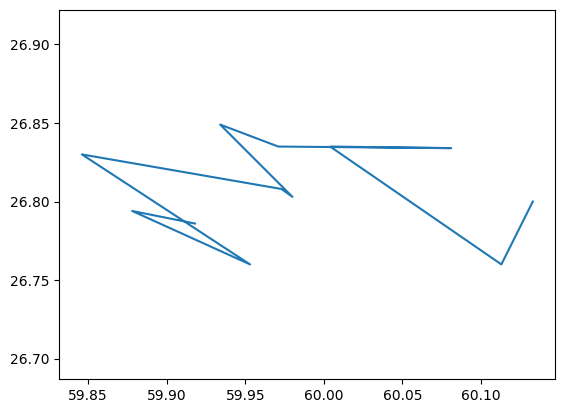

position in list =  144  index in df =  619


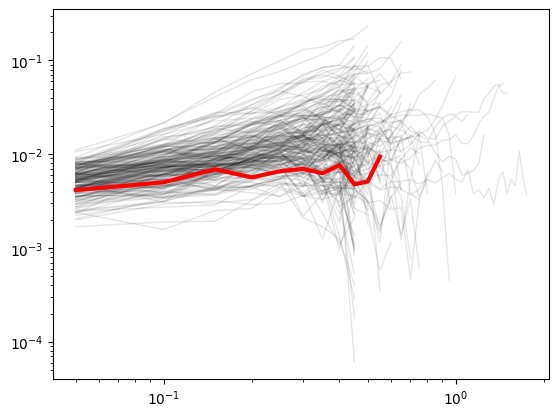

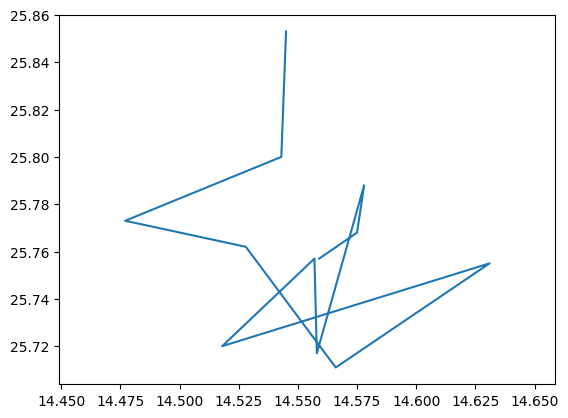

position in list =  145  index in df =  637


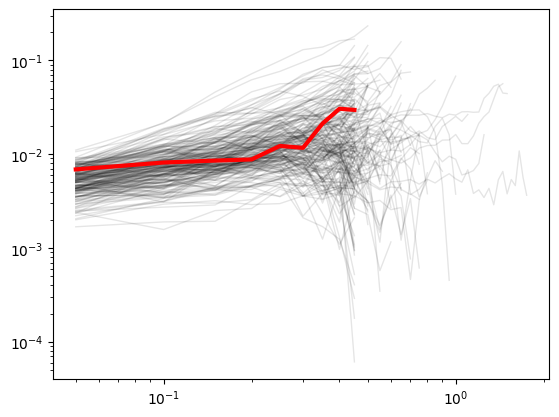

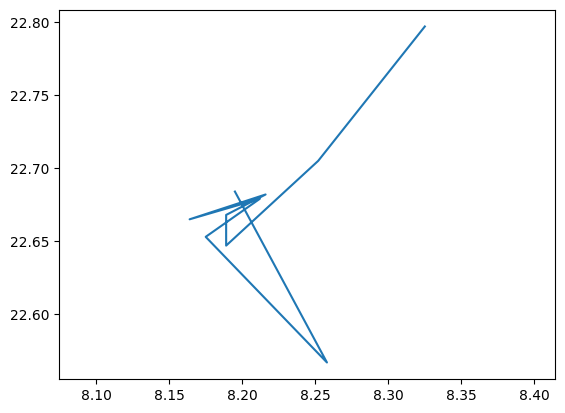

position in list =  146  index in df =  657


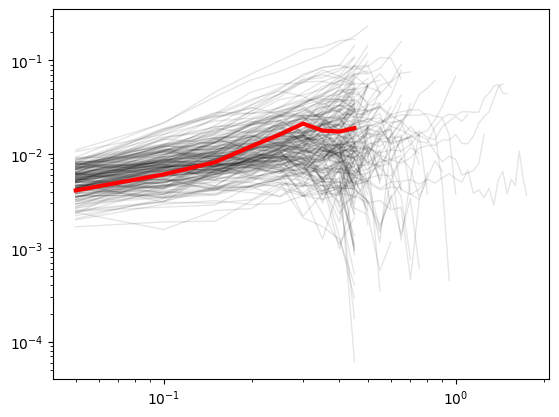

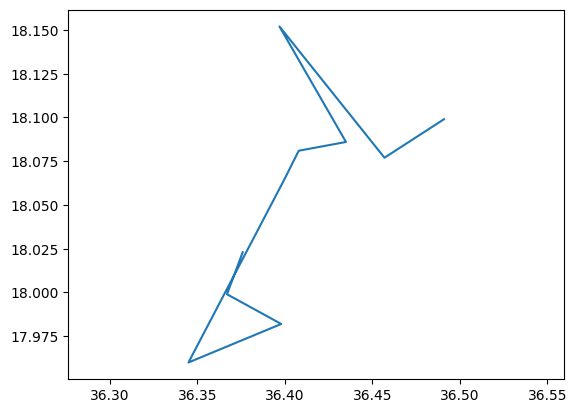

position in list =  147  index in df =  659


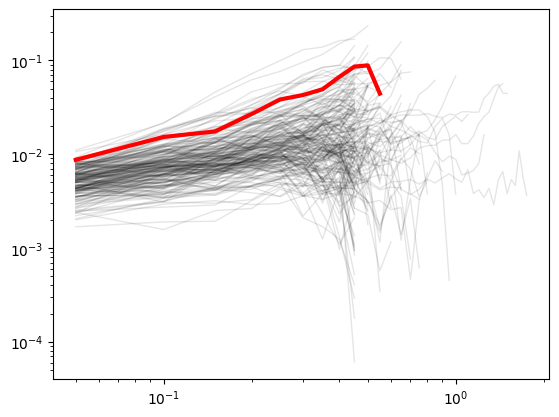

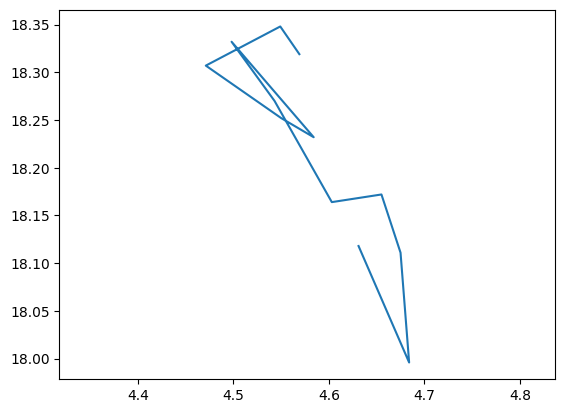

position in list =  148  index in df =  661


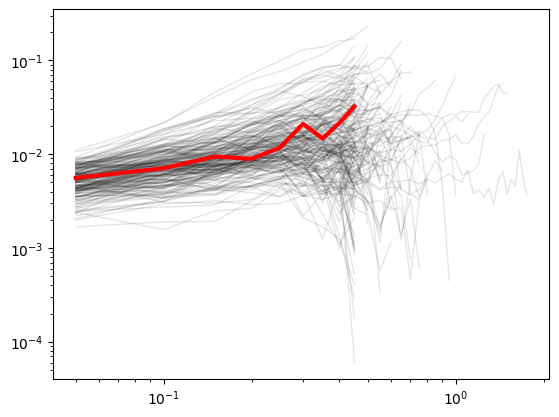

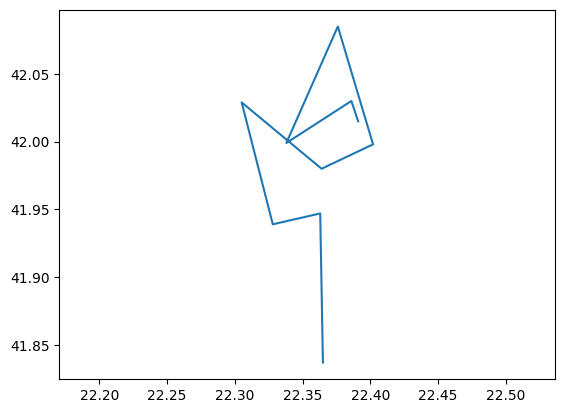

position in list =  149  index in df =  664


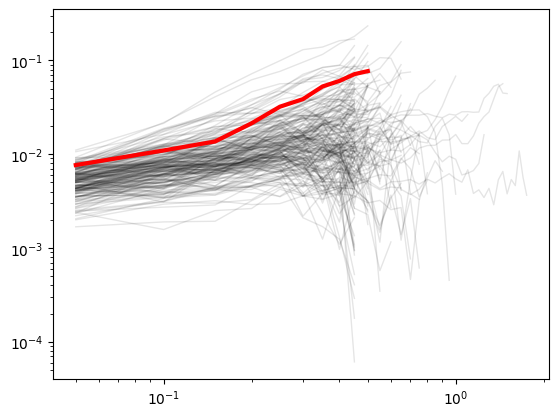

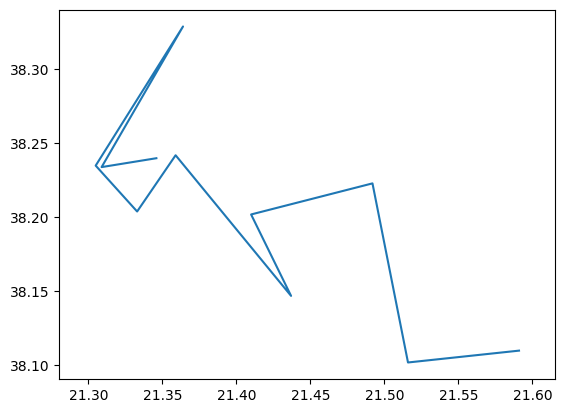

position in list =  150  index in df =  668


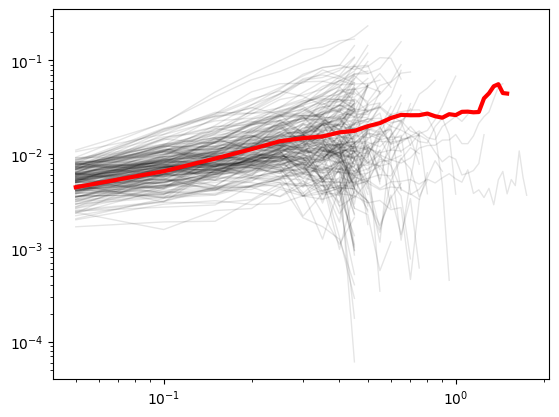

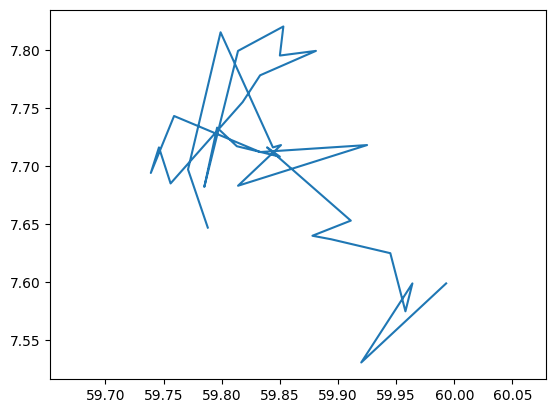

position in list =  151  index in df =  671


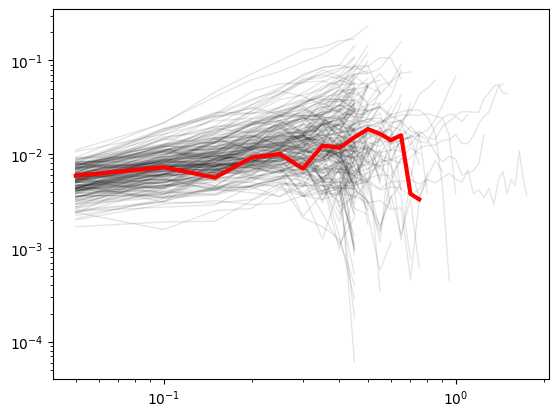

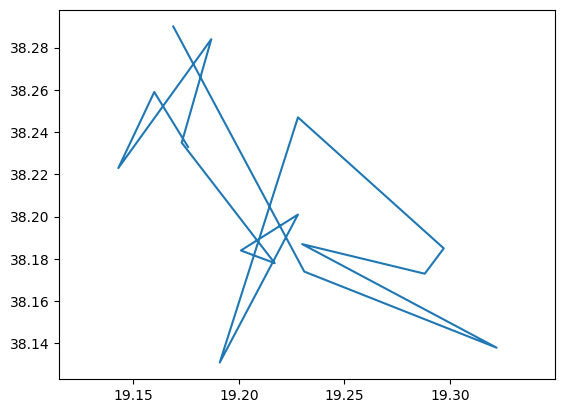

position in list =  152  index in df =  675


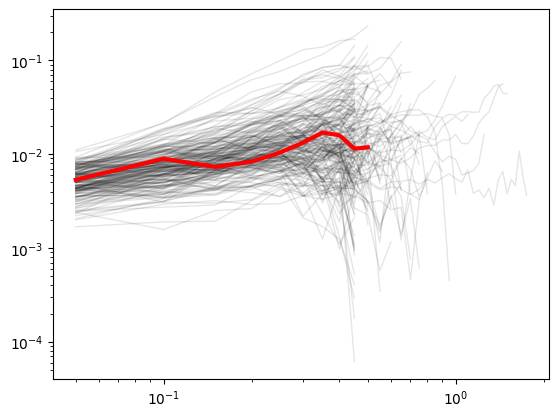

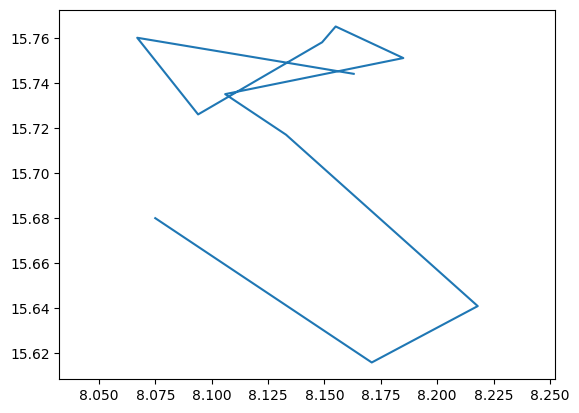

position in list =  153  index in df =  677


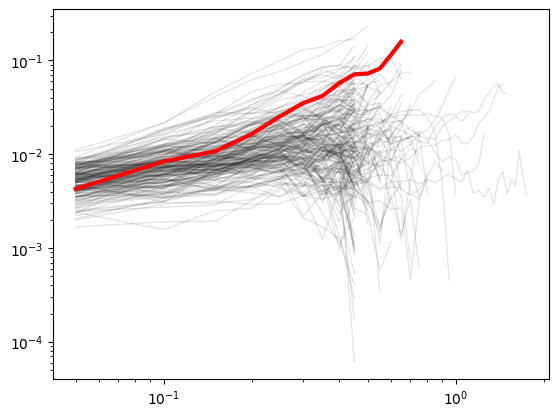

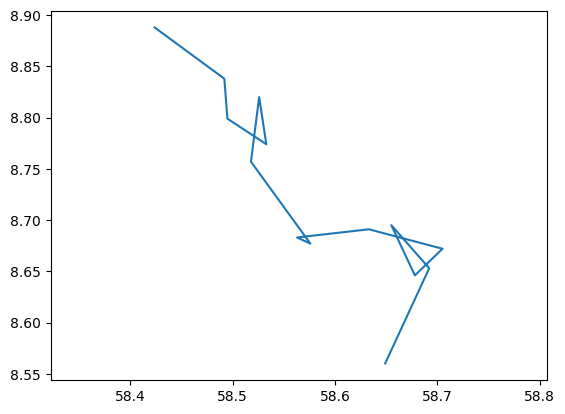

position in list =  154  index in df =  683


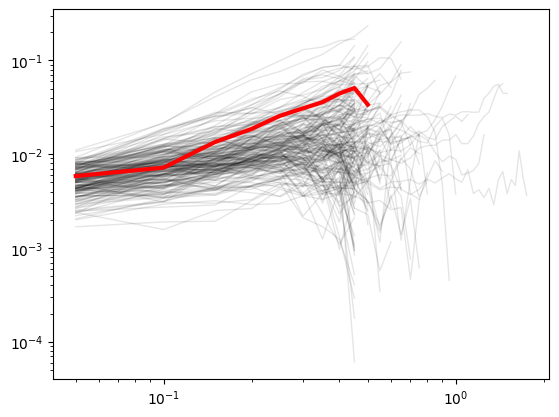

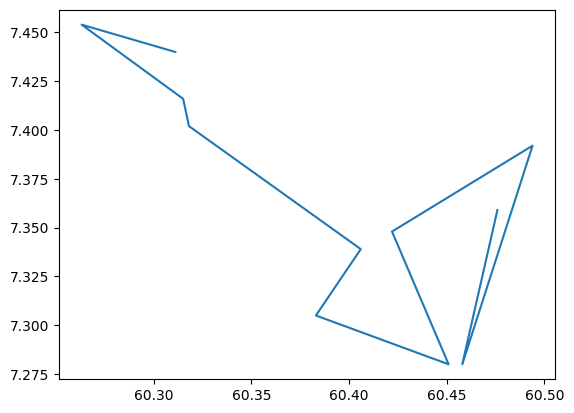

position in list =  155  index in df =  692


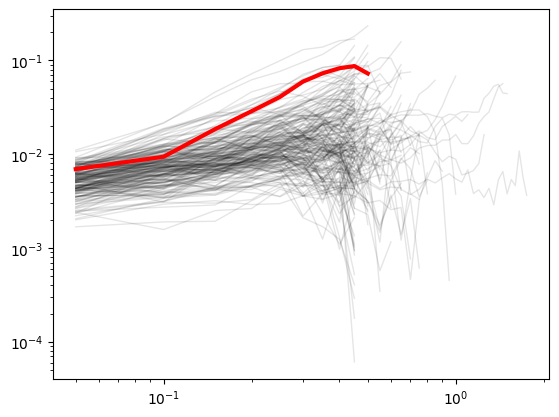

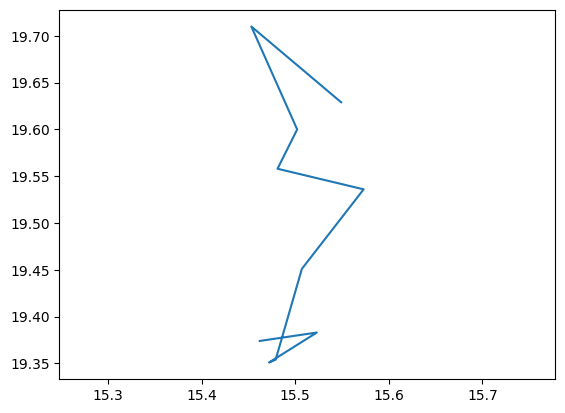

position in list =  156  index in df =  694


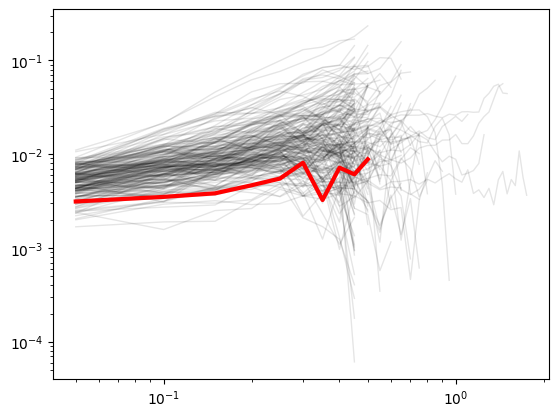

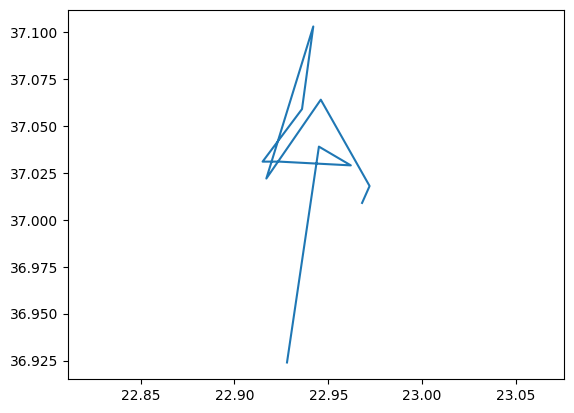

position in list =  157  index in df =  698


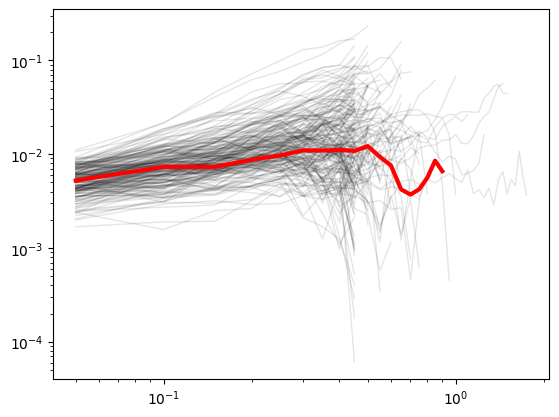

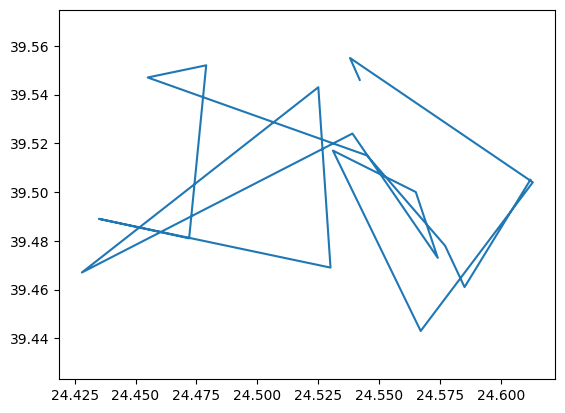

position in list =  158  index in df =  699


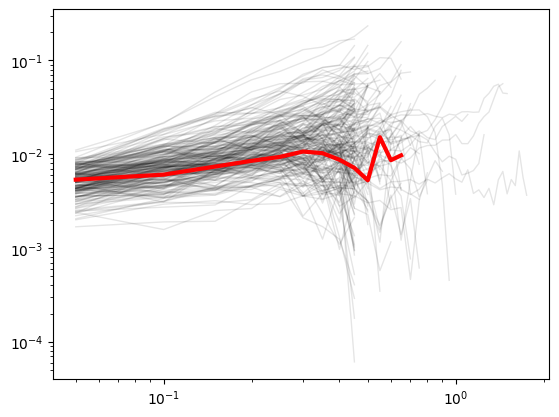

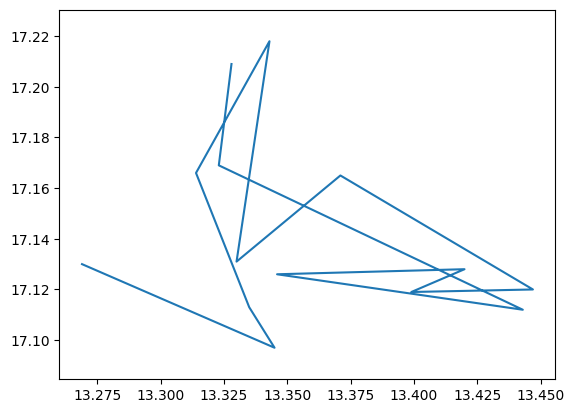

position in list =  159  index in df =  703


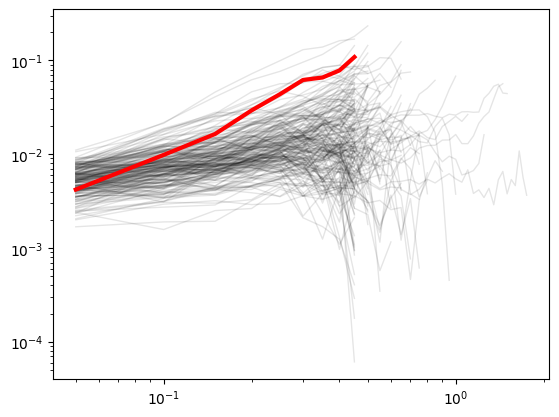

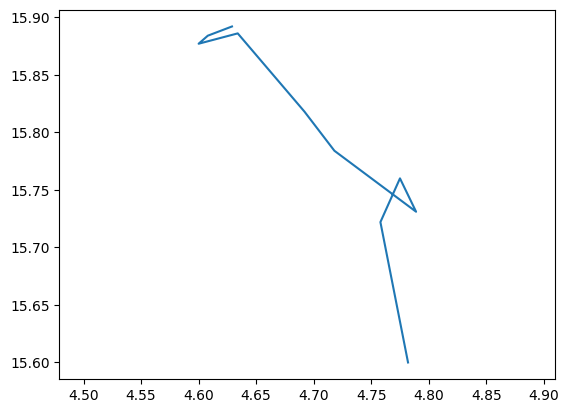

position in list =  160  index in df =  707


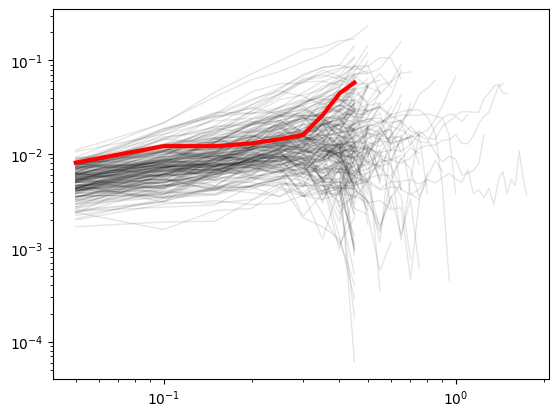

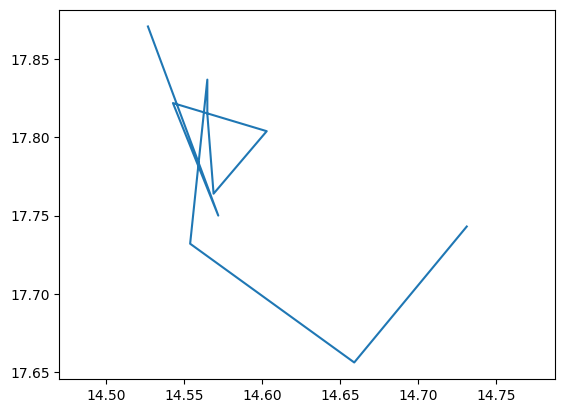

position in list =  161  index in df =  720


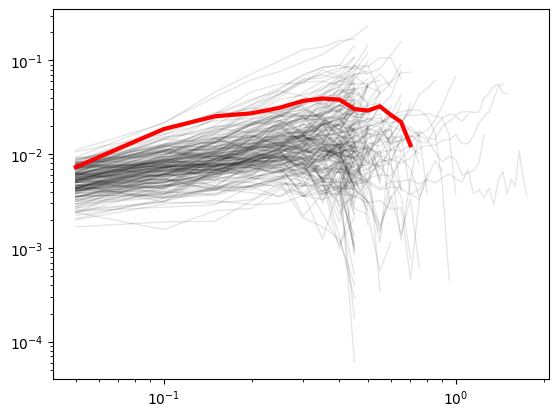

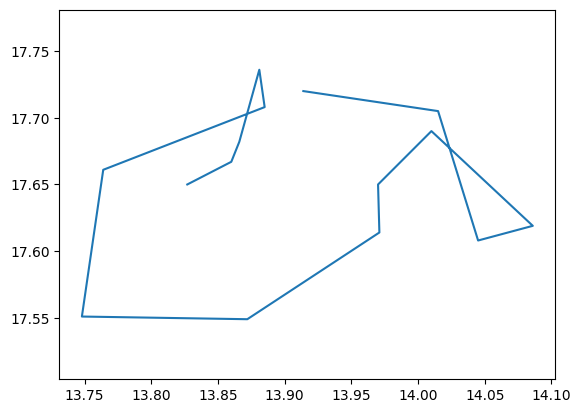

position in list =  162  index in df =  721


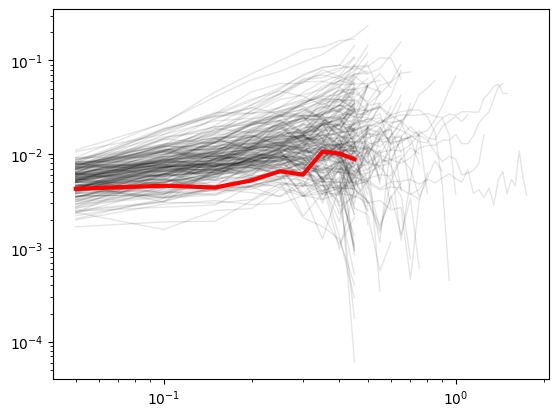

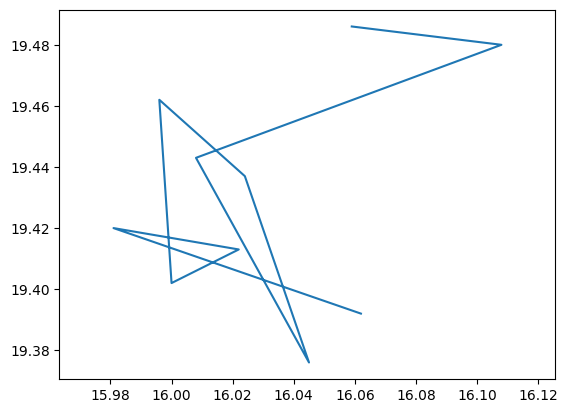

position in list =  163  index in df =  725


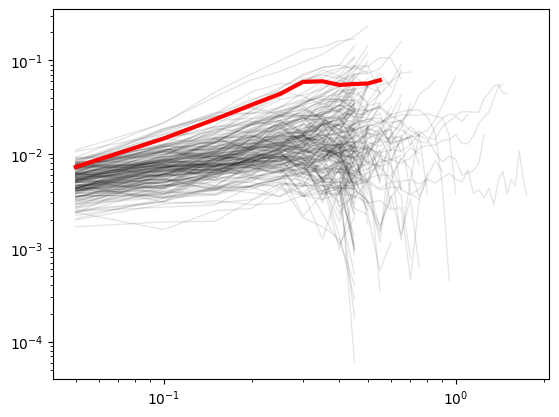

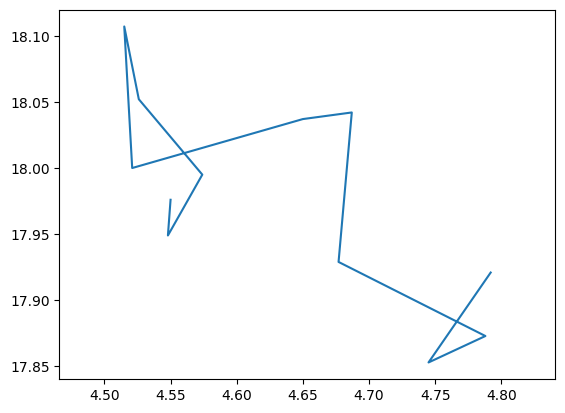

position in list =  164  index in df =  738


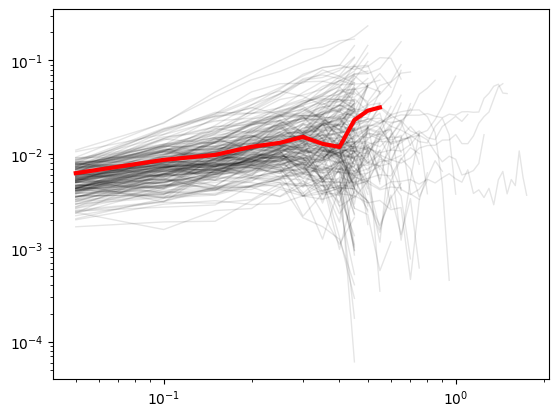

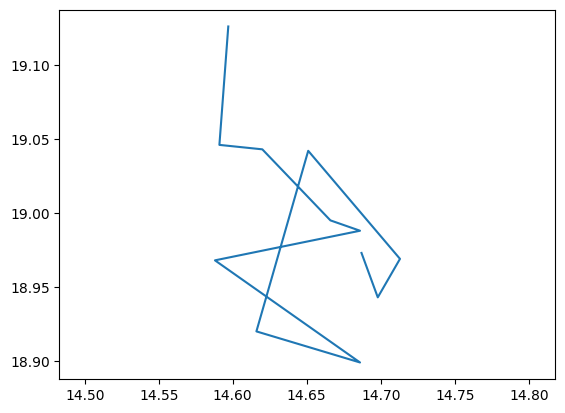

position in list =  165  index in df =  739


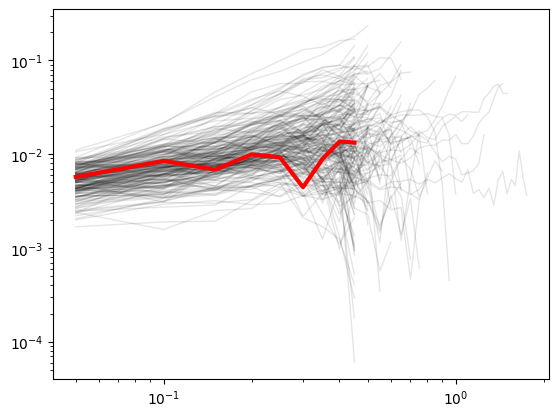

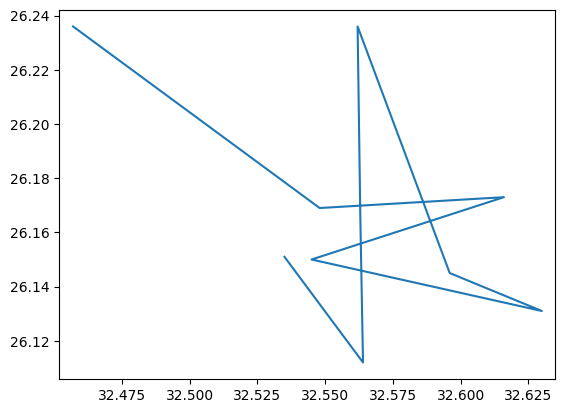

position in list =  166  index in df =  741


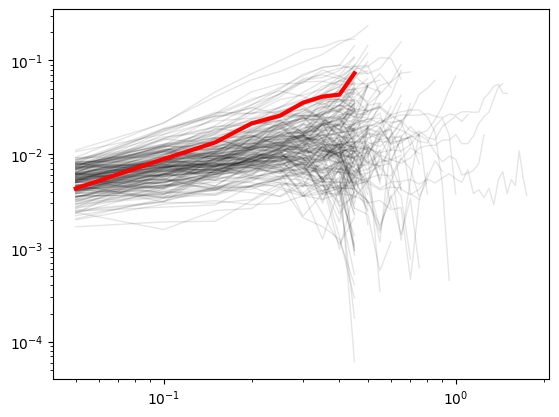

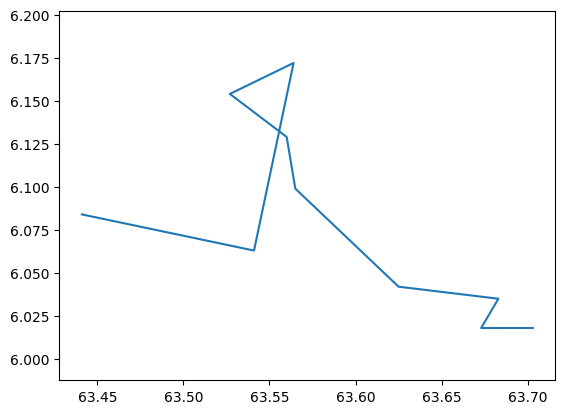

position in list =  167  index in df =  776


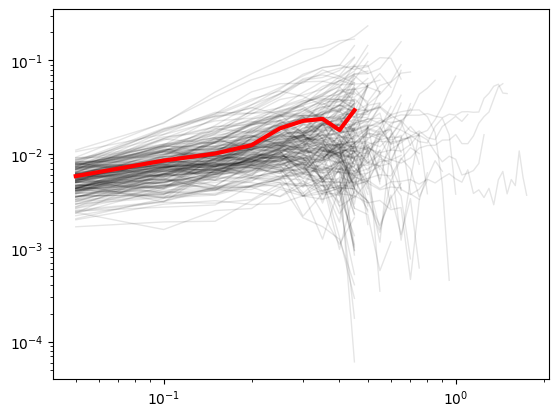

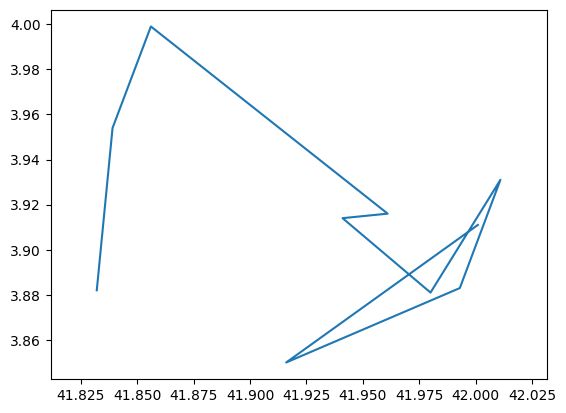

position in list =  168  index in df =  780


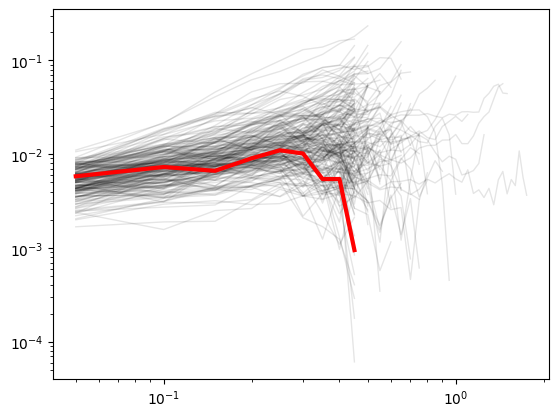

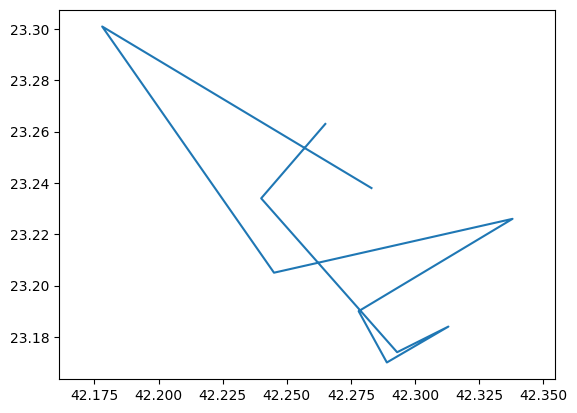

position in list =  169  index in df =  781


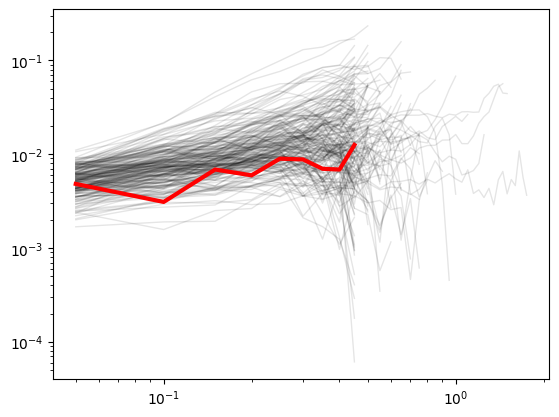

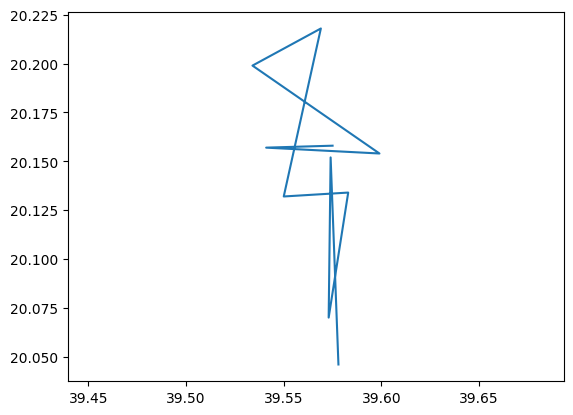

position in list =  170  index in df =  786


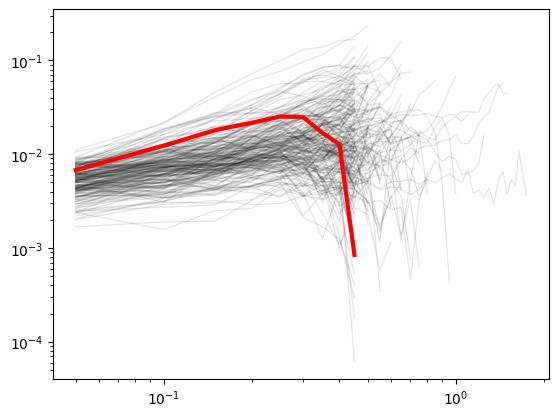

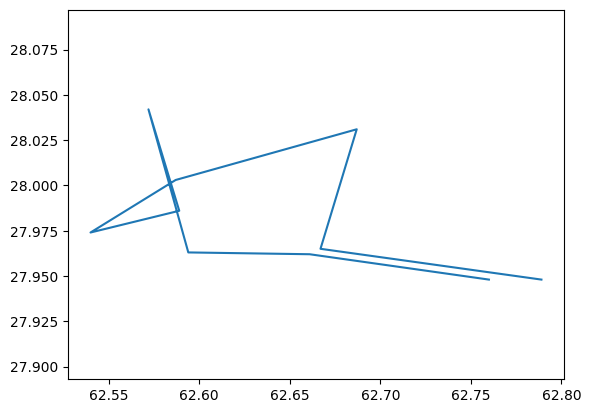

position in list =  171  index in df =  793


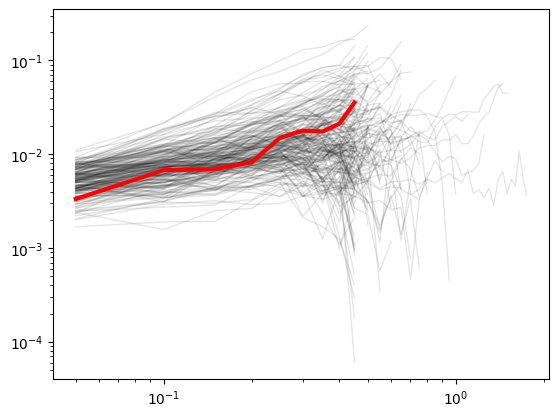

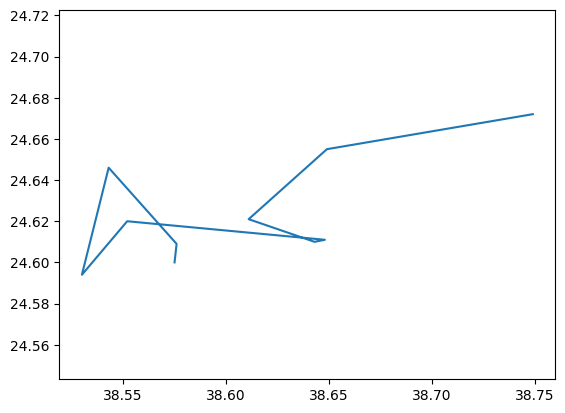

position in list =  172  index in df =  801


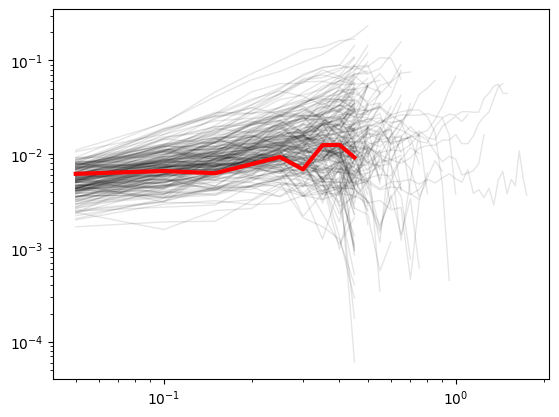

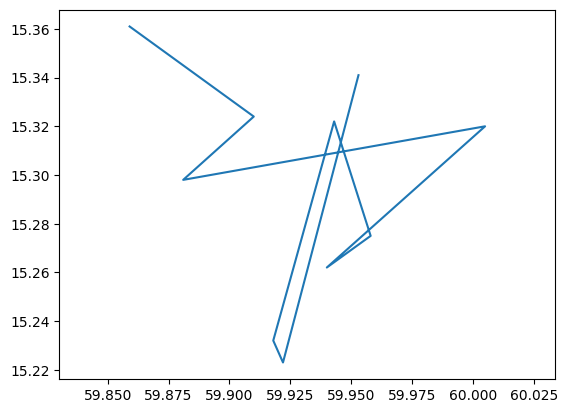

position in list =  173  index in df =  810


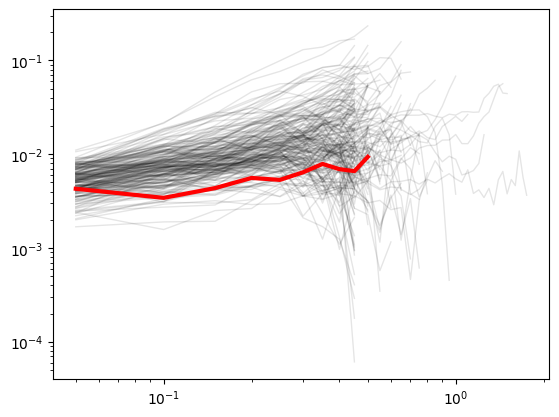

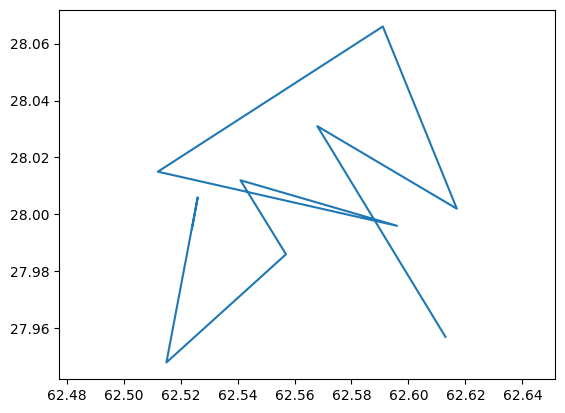

position in list =  174  index in df =  814


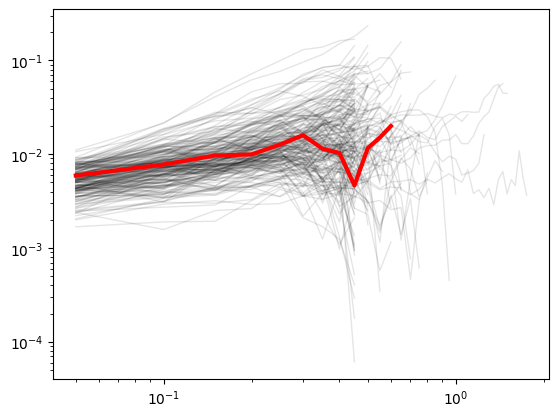

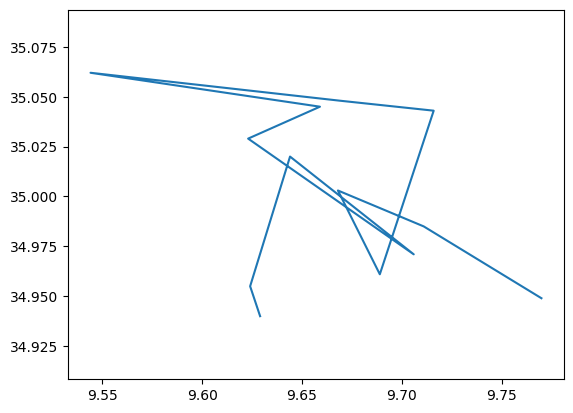

position in list =  175  index in df =  818


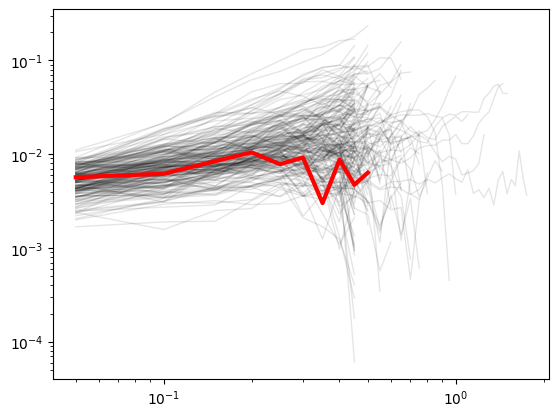

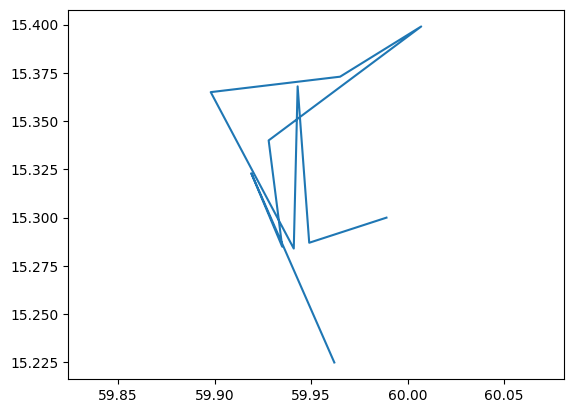

position in list =  176  index in df =  821


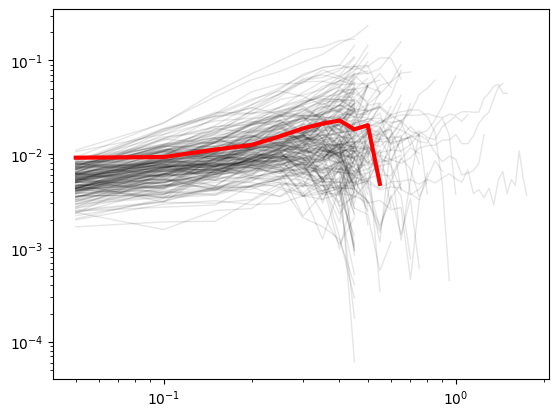

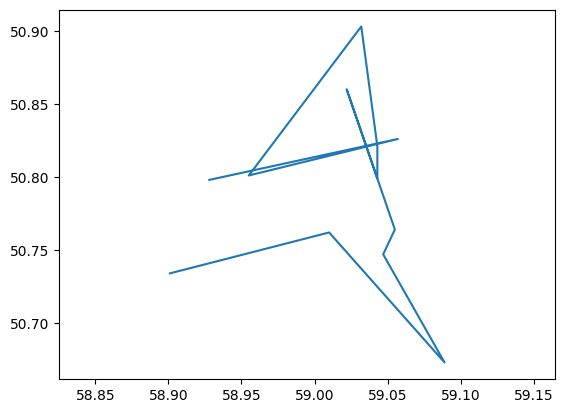

position in list =  177  index in df =  822


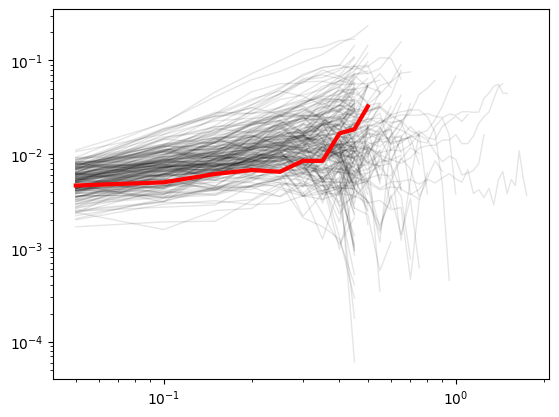

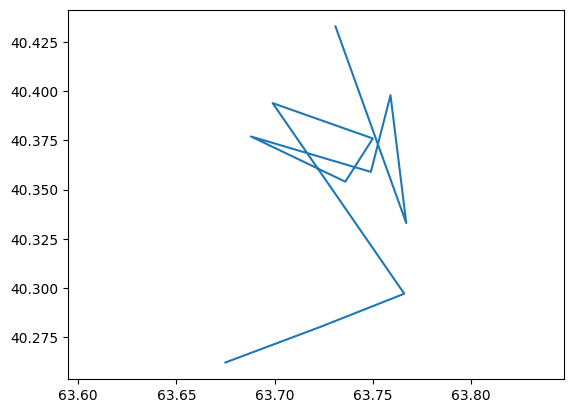

position in list =  178  index in df =  824


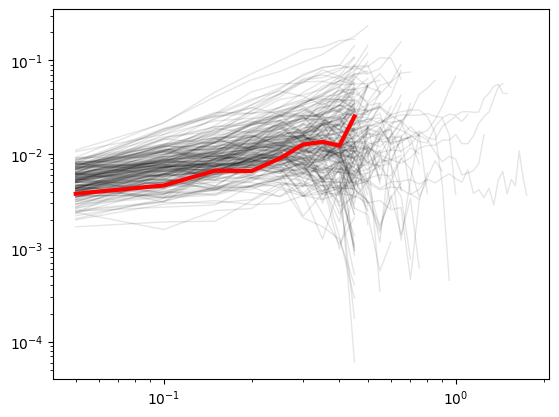

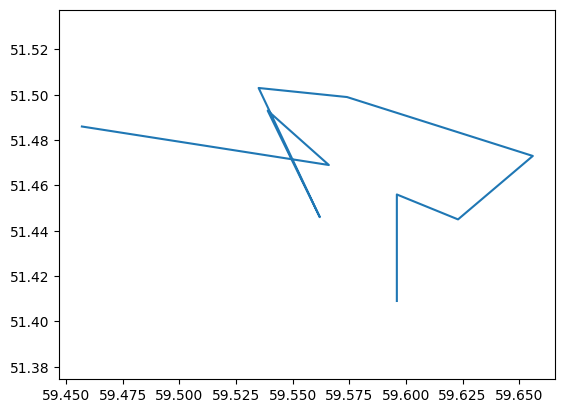

position in list =  179  index in df =  828


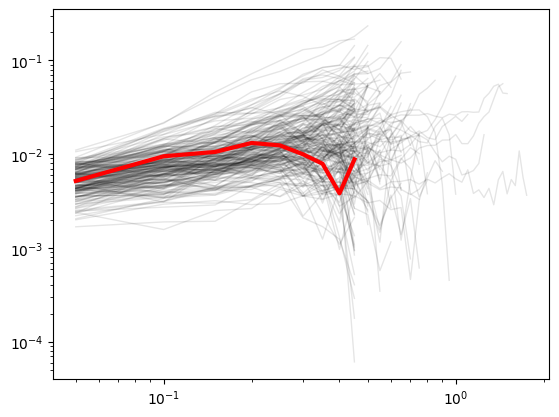

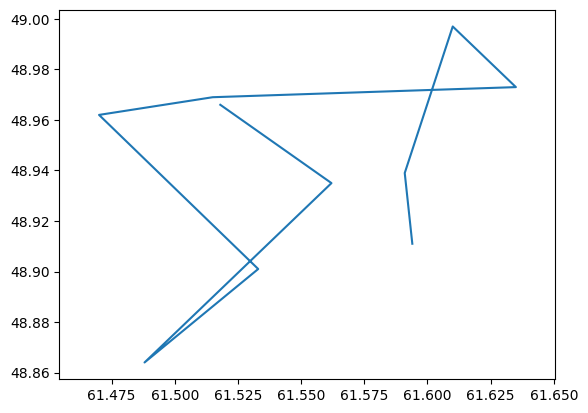

position in list =  180  index in df =  831


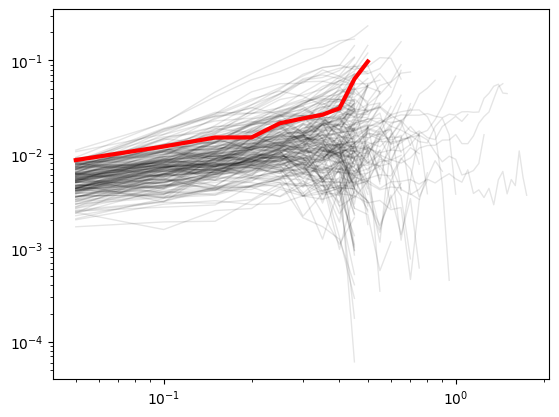

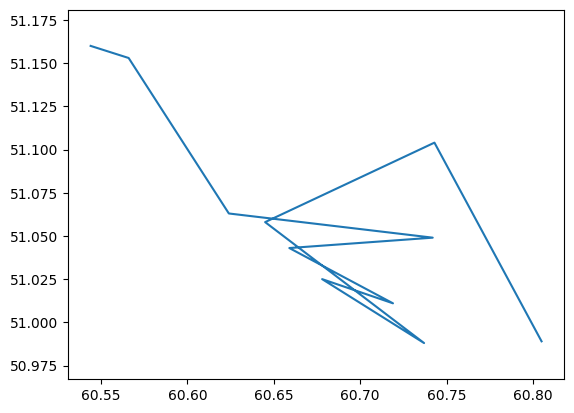

position in list =  181  index in df =  832


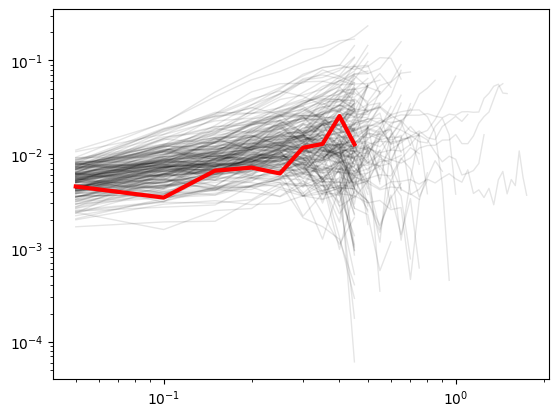

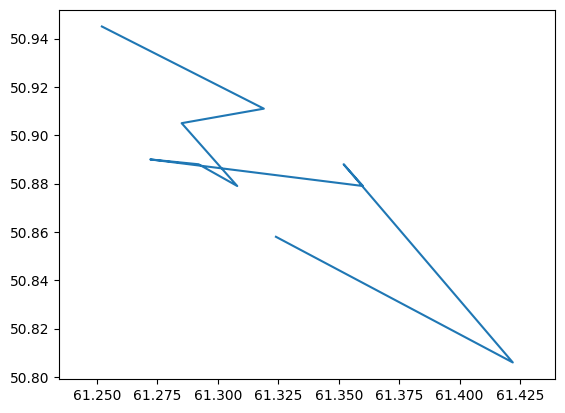

position in list =  182  index in df =  833


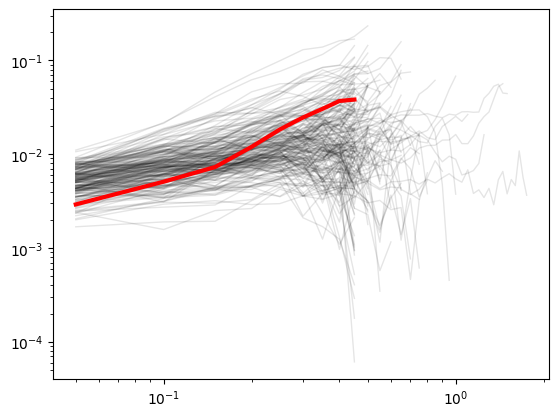

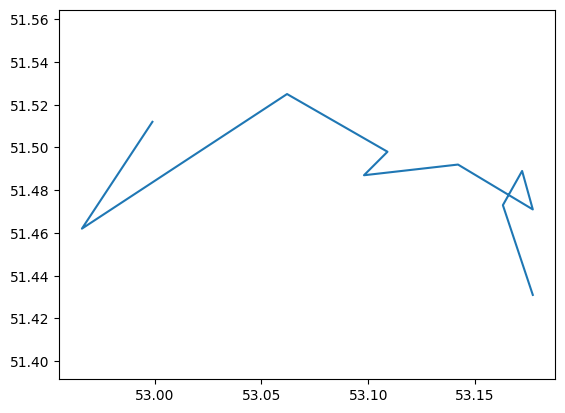

position in list =  183  index in df =  834


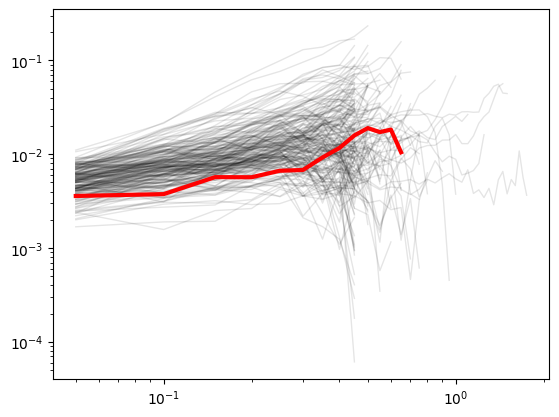

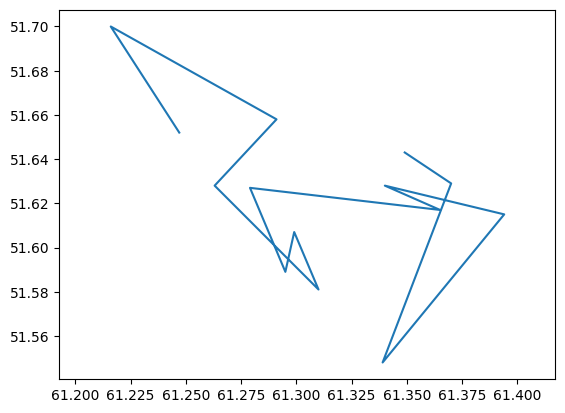

position in list =  184  index in df =  835


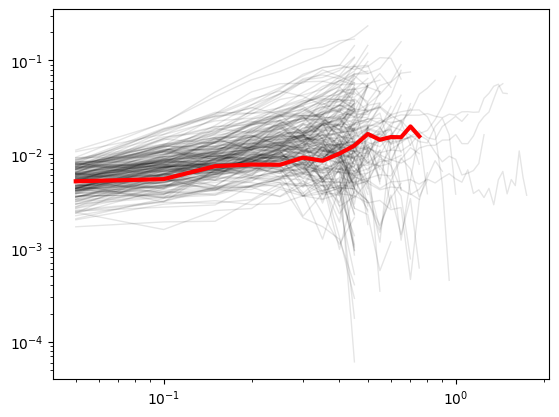

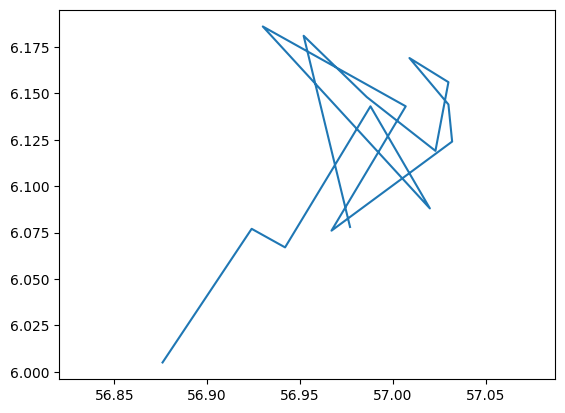

position in list =  185  index in df =  836


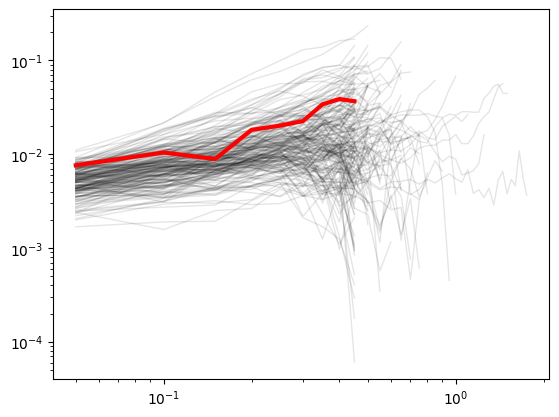

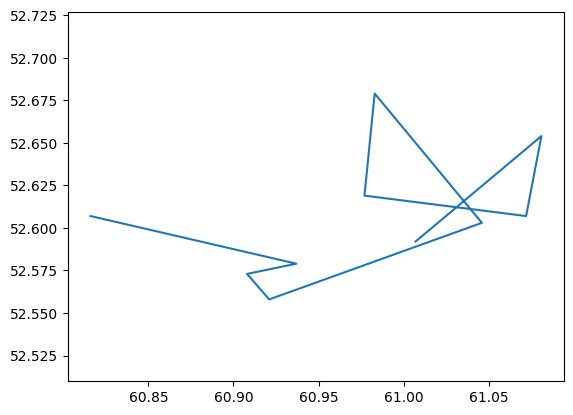

position in list =  186  index in df =  837


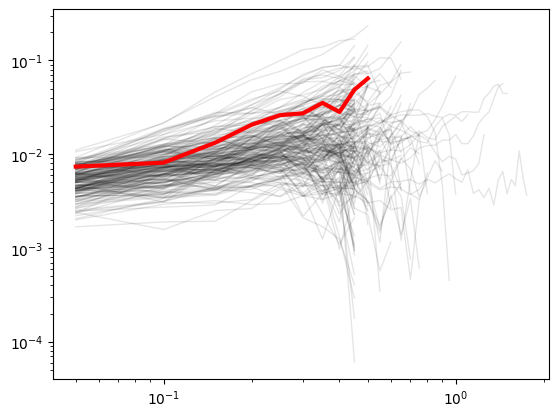

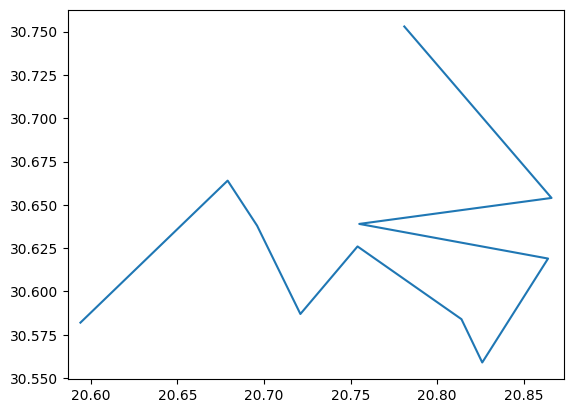

position in list =  187  index in df =  838


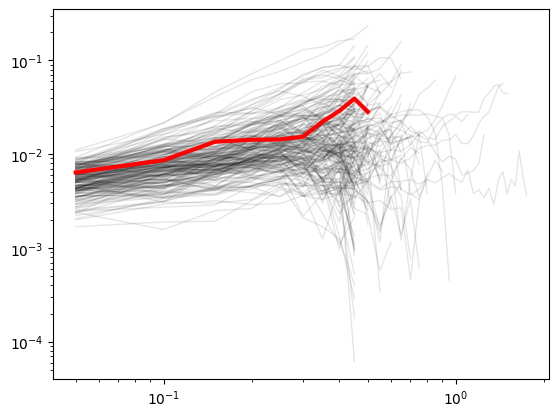

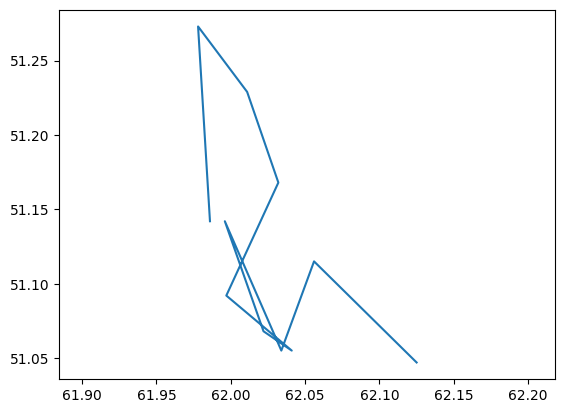

position in list =  188  index in df =  846


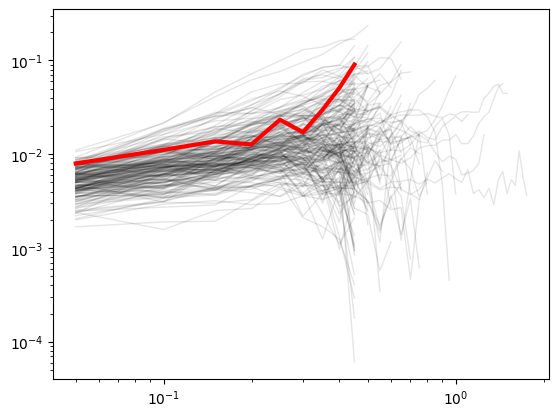

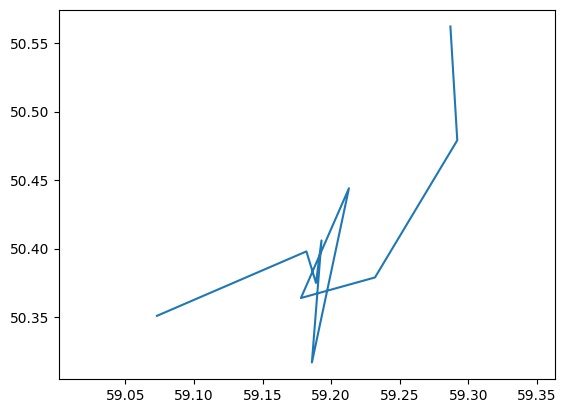

position in list =  189  index in df =  847


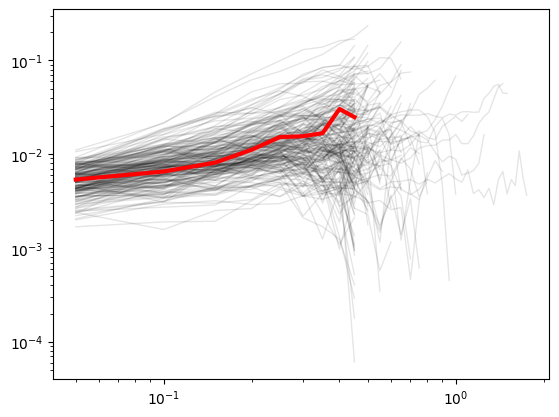

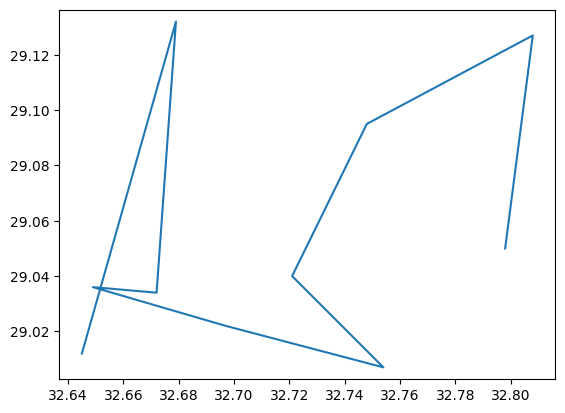

position in list =  190  index in df =  849


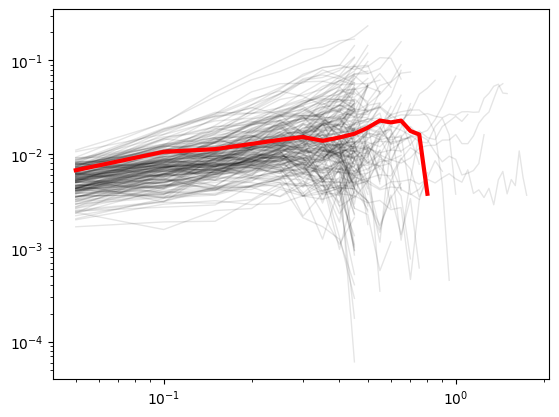

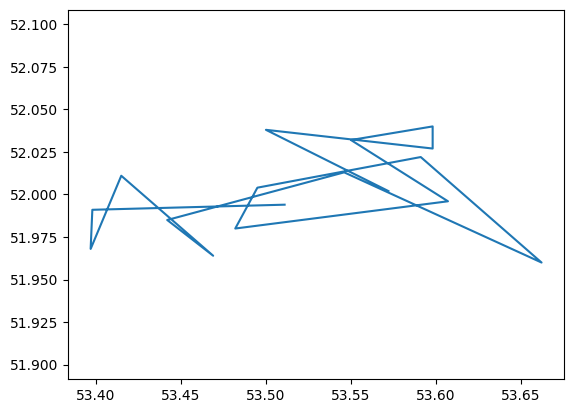

position in list =  191  index in df =  850


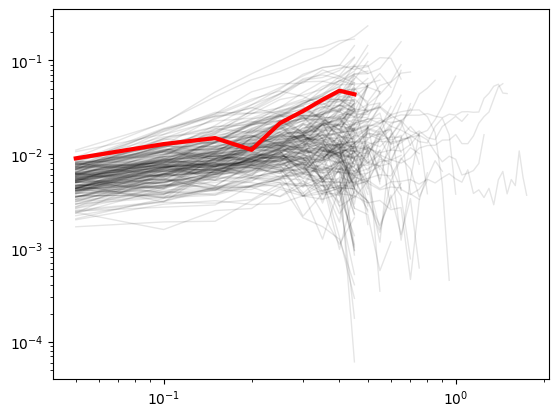

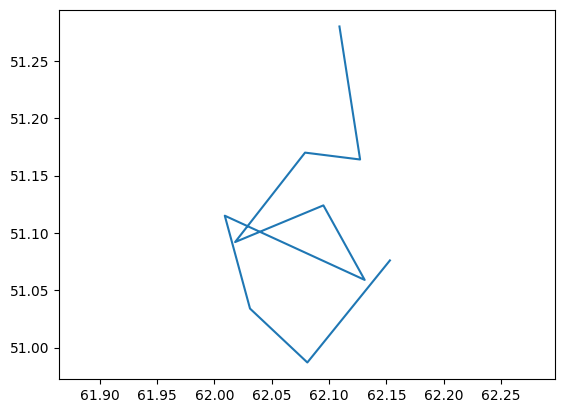

position in list =  192  index in df =  854


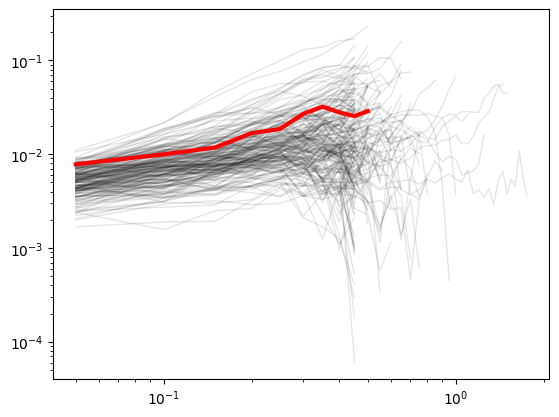

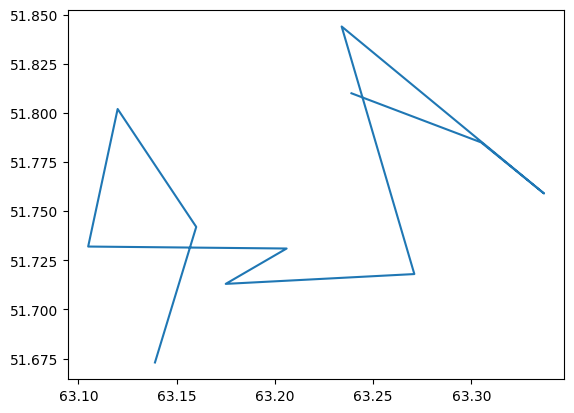

position in list =  193  index in df =  855


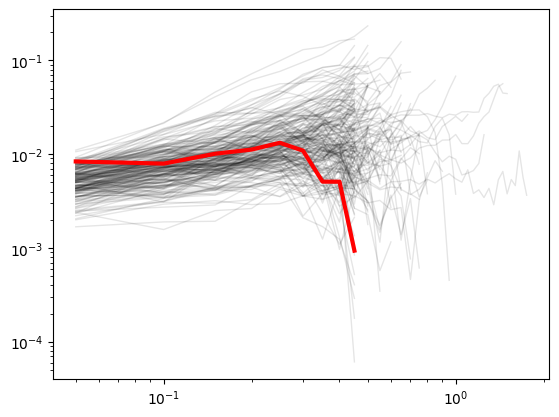

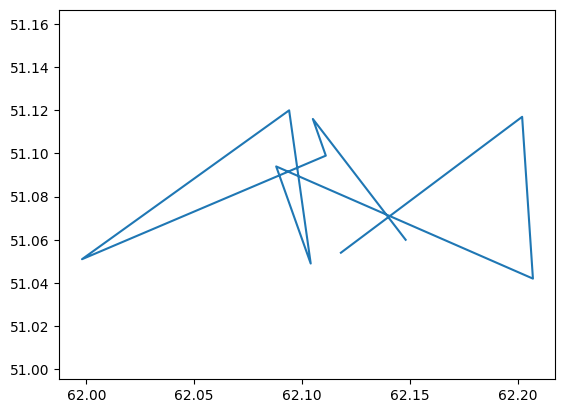

position in list =  194  index in df =  856


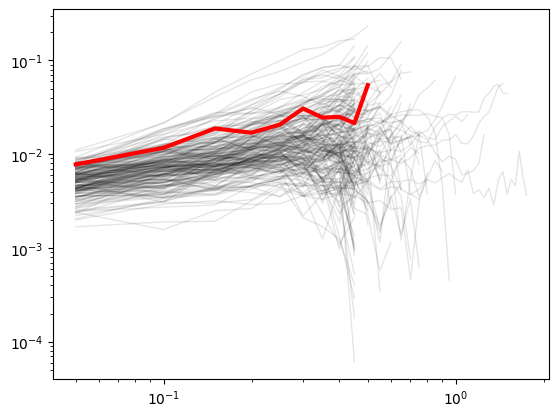

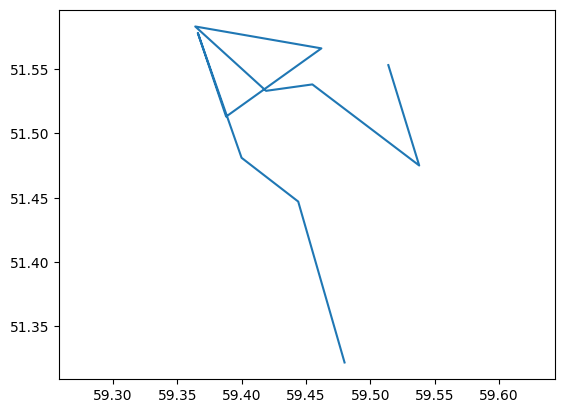

position in list =  195  index in df =  858


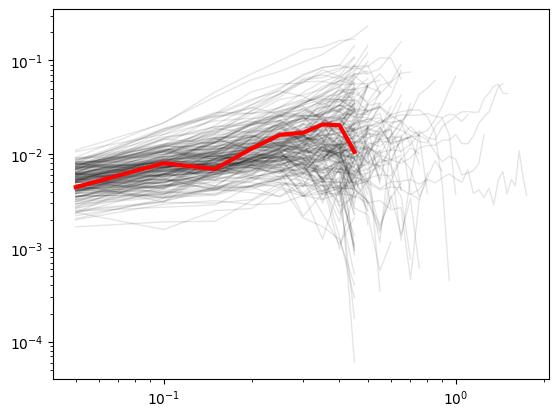

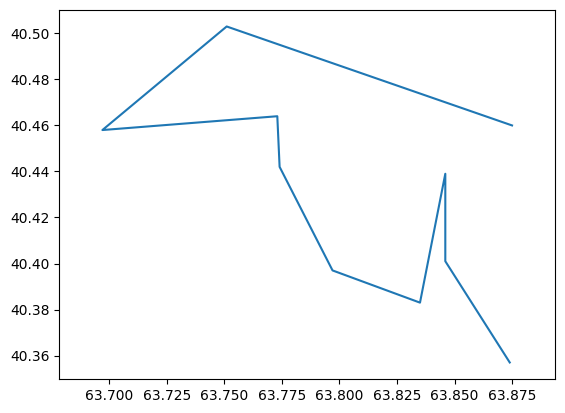

position in list =  196  index in df =  859


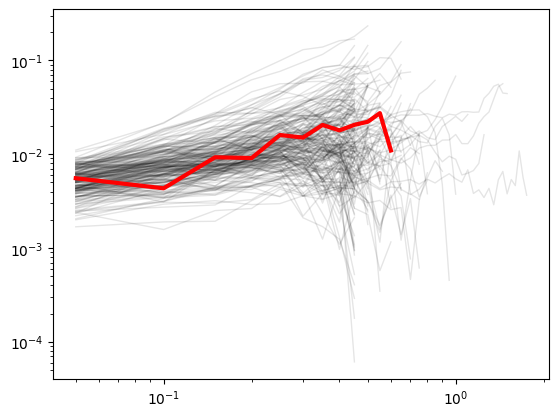

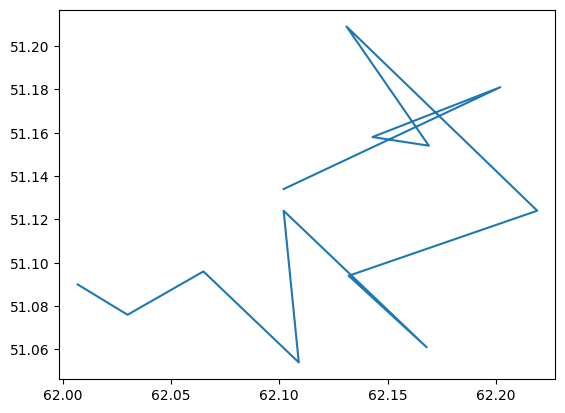

position in list =  197  index in df =  861


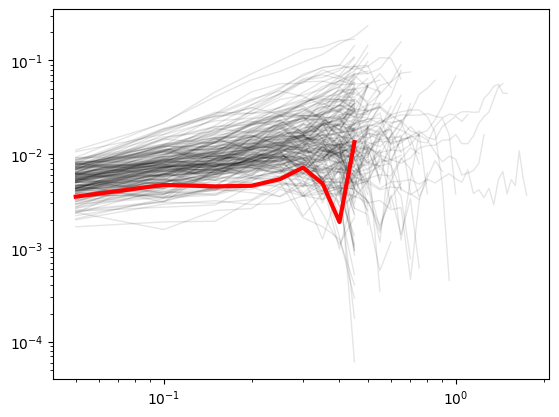

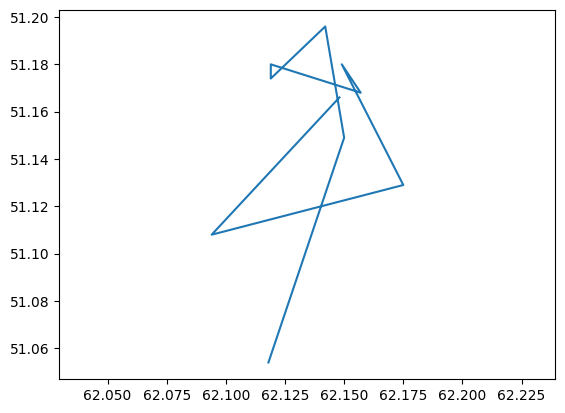

position in list =  198  index in df =  864


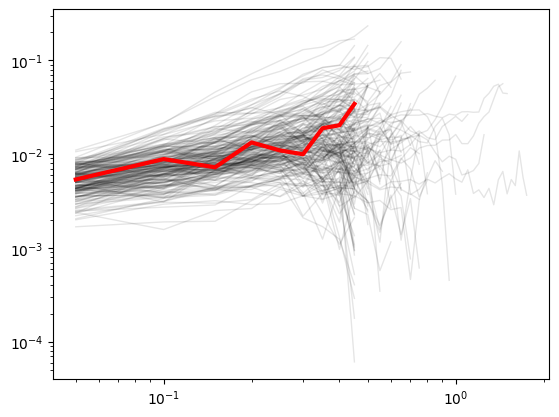

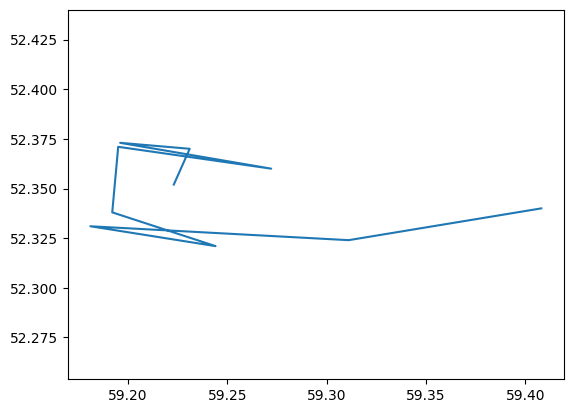

position in list =  199  index in df =  869


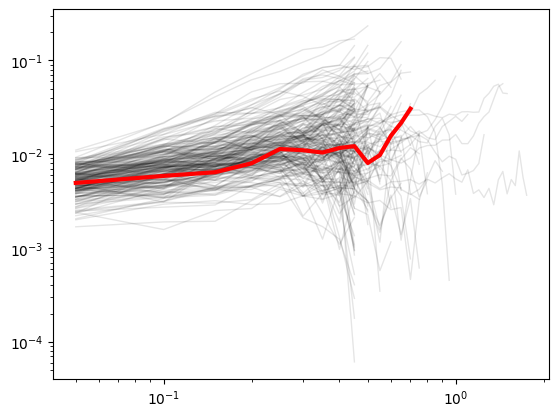

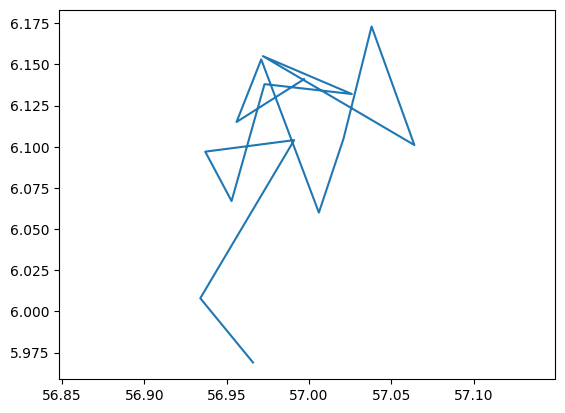

position in list =  200  index in df =  874


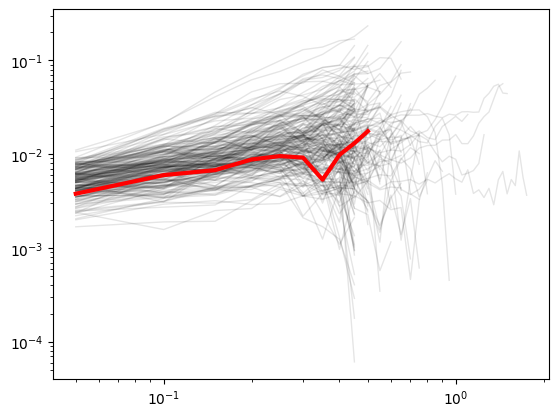

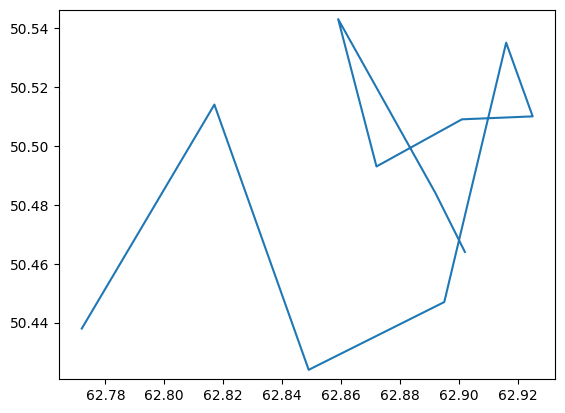

position in list =  201  index in df =  878


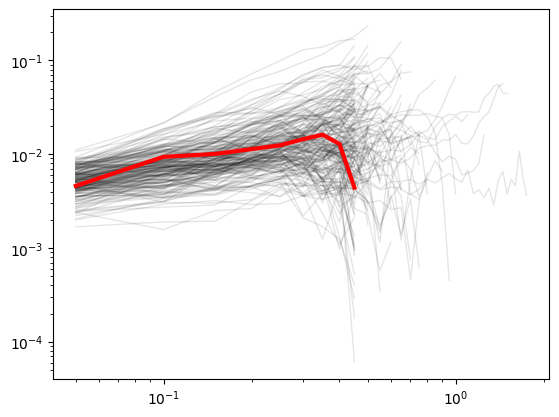

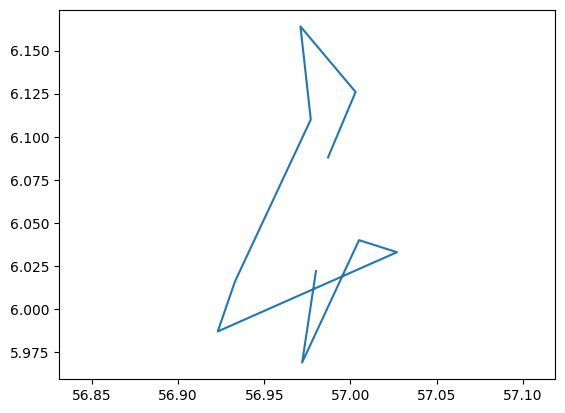

In [6]:
alpha = list(df135['alpha'].values)
dlist = list(df135['D'].values)
X = list(df135['x'].values)
Y = list(df135['y'].values)
plt.hist(alpha,bins=20)
plt.show()
plt.hist(dlist,bins=20)
plt.show()

MSD0 = list(df135['MSD'].values)
index0 = df135.index
for i in range(len(index0)):
    #print(df135.iloc[i])
    print("position in list = ",i," index in df = ",df135.index[i])
    for msd in MSD0:
        timelag = np.linspace(dt,len(msd)*dt,len(msd))
        plt.plot(timelag,msd,c='k',alpha=0.1,linewidth=1)
    msd = MSD0[i]
    timelag = np.linspace(dt,len(msd)*dt,len(msd))
    plt.plot(timelag,msd,c='red',linewidth=3)
    plt.xscale('log')
    plt.yscale('log')
    plt.show()
    x = X[i]
    y = Y[i]
    plt.plot(x,y)
    plt.axis('equal')
    plt.show()



In [6]:
remove = [4,8,9,11,17,23,39,50,74,81,92,102,104,105,106,139,169,198]
df135 = df135.drop(df135.index[remove])
display(df135.describe())

,alpha,D,c,R2,N
count,184.000000,184.000000,184.000000,184.000000,184.000000
mean,0.562522,-2.171371,0.210588,0.778398,11.896739
std,0.261844,0.381403,0.121532,0.146169,3.271869
min,0.140312,-2.949572,0.017160,0.513616,10.000000
25%,0.357586,-2.445423,0.124124,0.644605,10.000000
50%,0.499164,-2.241726,0.193048,0.792167,11.000000
75%,0.713290,-1.980342,0.275261,0.902244,12.000000
max,1.440625,-0.785501,0.676604,0.996943,31.000000


Compute the TE-MSD and ensemble variance...


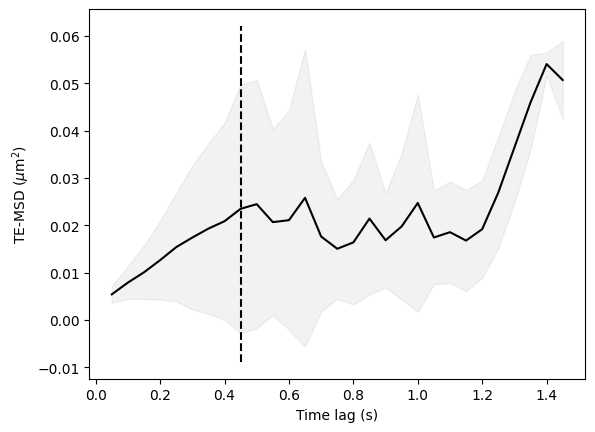

You have set a cutoff at  0.45  s...
Done. The TE-MSD and associated variance have been generated.


In [7]:
MSDtot = list(df135['MSD'].values)
temsdtot,vartot,timelagtot = TE_MSD(MSDtot,cutoff=0.45)

#############################################
############## PROGRAM MICHALET #############
#############################################
Compute the TE-MSD and ensemble variance...
Number of T-MSDs at time lag  0.05  =  184
Number of T-MSDs at time lag  0.1  =  184
Number of T-MSDs at time lag  0.15  =  184
Number of T-MSDs at time lag  0.2  =  184
Number of T-MSDs at time lag  0.25  =  184
Number of T-MSDs at time lag  0.3  =  184
Number of T-MSDs at time lag  0.35  =  184
Number of T-MSDs at time lag  0.4  =  184
Number of T-MSDs at time lag  0.45  =  184
Number of T-MSDs at time lag  0.5  =  99
Number of T-MSDs at time lag  0.55  =  61
Number of T-MSDs at time lag  0.6  =  45
Number of T-MSDs at time lag  0.65  =  36
Number of T-MSDs at time lag  0.7  =  23
Number of T-MSDs at time lag  0.75  =  17
Number of T-MSDs at time lag  0.8  =  12
Number of T-MSDs at time lag  0.85  =  9
Number of T-MSDs at time lag  0.9  =  8
Number of T-MSDs at time lag  0.95  =  7
Number of T-MSDs at tim

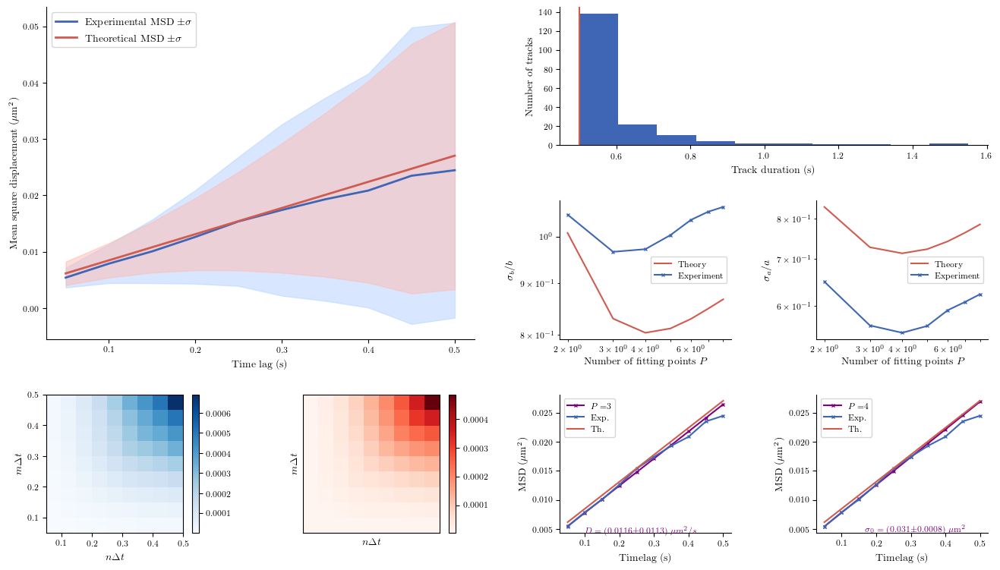

/home/remy13127/Documents/Internship/Functions/functions.py:1039: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


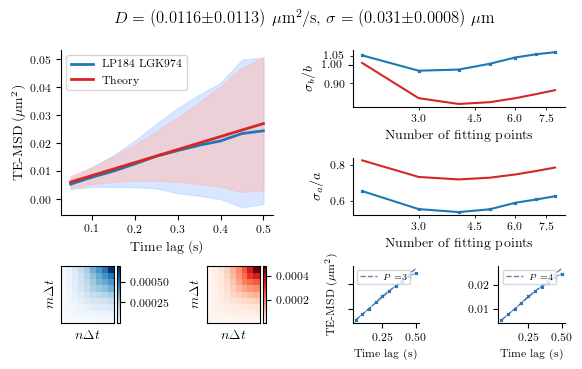

In [8]:
mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
Michalet(MSDtot,cutoff=0.5,experiment_name=r'LP184 LGK974')
plt.savefig('Results/michalet_lp184_lgk974.pdf',
            bbox_inches = 'tight')
plt.show()

In [11]:
display(df135.describe())
print(df135.shape[0])
index = list(df135.index)
label = []
for idx in index:
    label.append('slow_pop135')
df135['Label']=label
display(df135)

,alpha,D,c,R2,N
count,194.000000,194.000000,194.000000,194.000000,194.000000
mean,0.560833,-2.175662,0.209278,0.775283,11.824742
std,0.261545,0.382815,0.121203,0.146041,3.207861
min,0.140312,-2.949572,0.017160,0.513616,10.000000
25%,0.357872,-2.448232,0.122962,0.641024,10.000000
50%,0.496650,-2.244531,0.191486,0.790398,11.000000
75%,0.714257,-1.974291,0.276169,0.899081,12.000000
max,1.440625,-0.785501,0.676604,0.996943,31.000000


194


,alpha,D,c,R2,N,x,y,MSD,Filename,spotIDs,Label
1,0.842989,-1.899716,0.423857,0.801625,10,"[47.123999999999995, 47.153999999999996, 47.22...","[19.299, 19.269000000000002, 19.365, 19.366, 1...","[0.004320222222222457, 0.007701000000000515, 0...",Data/SM1_INI/tracks135.csv,"[150550, 151849, 155770, 157035, 158307, 15964...",slow_pop135
4,0.583570,-2.207949,0.233381,0.954245,10,"[56.761, 56.833, 56.766999999999996, 56.708, 5...","[38.580999999999996, 38.556999999999995, 38.57...","[0.00433411111111086, 0.006820374999999739, 0....",Data/SM1_INI/tracks135.csv,"[180948, 184878, 183566, 186129, 187490, 18873...",slow_pop135
11,0.336108,-2.460187,0.144662,0.646272,11,"[58.46, 58.408, 58.375, 58.356, 58.407, 58.433...","[43.176, 43.208999999999996, 43.227, 43.28, 43...","[0.004631399999999633, 0.007248222222222087, 0...",Data/SM1_INI/tracks135.csv,"[308030, 304348, 306800, 305588, 309301, 31174...",slow_pop135
13,0.270986,-2.609380,0.089573,0.672397,16,"[60.053000000000004, 60.093999999999994, 60.04...","[6.882999999999999, 6.939, 6.99, 6.983, 7.044,...","[0.004663800000000143, 0.004608999999999941, 0...",Data/SM1_INI/tracks135.csv,"[314639, 316972, 313451, 315800, 318213, 32060...",slow_pop135
14,0.371496,-2.479818,0.117661,0.613661,10,"[30.066, 30.064, 30.08, 30.119, 30.002, 30.05,...","[6.737, 6.729, 6.747999999999999, 6.78, 6.784,...","[0.005000666666666731, 0.004282874999999966, 0...",Data/SM1_INI/tracks135.csv,"[320601, 319406, 325549, 321873, 323312, 32310...",slow_pop135
...,...,...,...,...,...,...,...,...,...,...,...
861,0.219144,-2.753316,0.251958,0.782930,10,"[62.148, 62.093999999999994, 62.175, 62.148999...","[51.166000000000004, 51.108000000000004, 51.12...","[0.003525111111111346, 0.0047053750000002215, ...",Data/SM14_INI/tracks135.csv,"[6948513, 6950112, 6951777, 6956460, 6953476, ...",slow_pop135
864,0.473403,-2.242025,0.314301,0.648567,10,"[59.408, 59.31100000000001, 59.181000000000004...","[52.34, 52.324, 52.331, 52.321000000000005, 52...","[0.005376777777777537, 0.008877374999999799, 0...",Data/SM14_INI/tracks135.csv,"[6999939, 7008314, 7006668, 7009929, 7016470, ...",slow_pop135
869,0.458457,-2.350581,0.188765,0.879621,15,"[56.997, 56.956, 56.971000000000004, 57.006, 5...","[6.141, 6.115, 6.153, 6.06, 6.105, 6.172999999...","[0.004940357142857167, 0.005869692307692259, 0...",Data/SM14_INI/tracks135.csv,"[7085250, 7086908, 7088543, 7093441, 7090186, ...",slow_pop135
874,0.572325,-2.273584,0.240572,0.897317,11,"[62.902, 62.891999999999996, 62.85899999999999...","[50.464, 50.483999999999995, 50.543, 50.493, 5...","[0.0037873999999998745, 0.005985222222222454, ...",Data/SM14_INI/tracks135.csv,"[7279093, 7285556, 7282361, 7280763, 7287164, ...",slow_pop135


# PLOT FOR REPORT

/home/remy13127/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


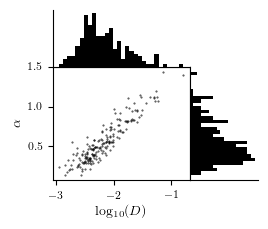

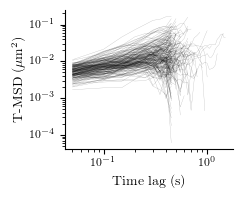

In [13]:
# the random data
logD = list(df135['D'].values)
alpha = list(df135['alpha'].values)
binsize=30

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.55))
grid = plt.GridSpec(3, 3, wspace=0., hspace=0.,right=0.7)
scatter = fig.add_subplot(grid[1:3, 0:2])
hist_logD = fig.add_subplot(grid[0,0:2],yticks=[],xticks=[])
hist_alpha = fig.add_subplot(grid[1:3,2],yticks=[],xticks=[])

scatter.scatter(logD,alpha,s=0.2,c='k',alpha=0.8)
scatter.set_xlabel(r'log$_{10}(D)$')
scatter.set_ylabel(r'$\alpha$')

hist_logD.hist(logD,bins=binsize,color='k')
hist_logD.spines['top'].set_visible(False)
hist_logD.spines['right'].set_visible(False)


hist_alpha.hist(alpha,bins=binsize,color='k',orientation='horizontal')
hist_alpha.spines['top'].set_visible(False)
hist_alpha.spines['right'].set_visible(False)

plt.tight_layout()
plt.savefig('Results/scatter_rs135_lp184lgk974.pdf',bbox_inches = 'tight')
plt.show()

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0., hspace=0.,right=0.7)
ax = fig.add_subplot(grid[0,0])
MSDSeries = list(df135['MSD'].values)
for msd in MSDSeries:
    timelag = np.linspace(dt,len(msd)*dt,len(msd))
    ax.plot(timelag,msd,c='k',alpha=0.3,linewidth=0.2)
ax.set_xscale('log')
ax.set_yscale('log')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Time lag (s)')
ax.set_ylabel(r'T-MSD ($\mu$m$^2$)')
plt.savefig('Results/msd_rs135_lp184lgk974.pdf',bbox_inches = 'tight')
plt.show()

30 30
[0.00706813]


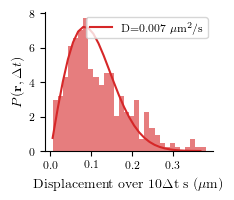

In [16]:
Xtot = list(df135['x'].values)
Ytot = list(df135['y'].values)

def plot_dist(X,Y,n,binsize=30,color='tab:blue'):
    displacements = []
    epsilon=0.
    s = 0
    for x,y in zip(X,Y):
        for i in range(0,len(x)-n):
            disp = np.sqrt((x[n+i] - x[i])**2 + (y[n+i] - y[i])**2)
            displacements.append(disp)

    from scipy.optimize import curve_fit
    def prob(d,D):
        timelag=dt*n
        return(2*d/(4*D*timelag+epsilon)*np.exp(-d**2/(4*D*timelag+epsilon)))

    histo,bins = np.histogram(displacements,bins=binsize,density=True)
    print(len(histo),len(bins[:-1]))
    popt, pcov = curve_fit(prob, bins[:-1], histo)
    print(popt)
    plt.plot(bins[:-1], prob(bins[:-1], *popt), 'r-',label=r'D=%5.3f $\mu$m$^2/$s' % tuple(popt),c=color)
    plt.hist(displacements,bins=binsize,density=True,color=color,alpha=0.6)

    

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0., hspace=0.,right=0.7)
ax = fig.add_subplot(grid[0,0])
n=10
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plot_dist(Xtot,Ytot,n,color='tab:red',binsize=30)
ax.set_xlabel(r'Displacement over '+str(n)+'$\Delta$t s ($\mu$m)')
ax.set_ylabel(r'$P(\mathbf{r},\Delta t)$')
ax.legend()
plt.savefig('Results/lp184lgk974_rs135_displacement'+str(n)+'.pdf',bbox_inches = 'tight')
plt.show()

# Identify the tracks in the dataset associated to the larger $R_S$

In [17]:
files = ["Data/SM1_INI/tracks425.csv","Data/SM2_INI/tracks425.csv","Data/SM3_INI/tracks425.csv","Data/SM4_INI/tracks425.csv","Data/SM5_INI/tracks425.csv","Data/SM6_INI/tracks425.csv","Data/SM8_INI/tracks425.csv","Data/SM9_INI/tracks425.csv","Data/SM11_INI/tracks425.csv","Data/SM12_INI/tracks425.csv","Data/SM13_INI/tracks425.csv","Data/SM14_INI/tracks425.csv"]
df425 = pool_data(files,dt,minframe,maxframe,rsquared_threshold,fit_option=5,display_id=False)

Parameters for the MSD analysis: dt =  0.05
Initial filters: minframe =  10 , maxframe =  40 , R2 threshold =  -1000
Fit option:  5
Reading filenames in  ['Data/SM1_INI/tracks425.csv', 'Data/SM2_INI/tracks425.csv', 'Data/SM3_INI/tracks425.csv', 'Data/SM4_INI/tracks425.csv', 'Data/SM5_INI/tracks425.csv', 'Data/SM6_INI/tracks425.csv', 'Data/SM8_INI/tracks425.csv', 'Data/SM9_INI/tracks425.csv', 'Data/SM11_INI/tracks425.csv', 'Data/SM12_INI/tracks425.csv', 'Data/SM13_INI/tracks425.csv', 'Data/SM14_INI/tracks425.csv'] ...
Analysis for Data/SM1_INI/tracks425.csv ...
546  tracks were kept out of  31353 . Done.
Analysis for Data/SM2_INI/tracks425.csv ...
234  tracks were kept out of  23708 . Done.
Analysis for Data/SM3_INI/tracks425.csv ...
1068  tracks were kept out of  37256 . Done.
Analysis for Data/SM4_INI/tracks425.csv ...
606  tracks were kept out of  25756 . Done.
Analysis for Data/SM5_INI/tracks425.csv ...
479  tracks were kept out of  21851 . Done.
Analysis for Data/SM6_INI/tracks425.

# Identify trajectories already detected at 135 nm and put label

In [18]:
def radius(xlist,ylist):
    rad=[]
    for x,y in zip(xlist,ylist):
        r=[]
        for i in range(len(x)):
            xx = x[i]
            yy = y[i]
            r.append(np.sqrt(xx**2+yy**2))
        rad.append(r)
    return(rad)

X425 = list(df425['x'].values)
Y425 = list(df425['y'].values)
R425 = radius(X425,Y425)

X135 = list(df135['x'].values)
Y135 = list(df135['y'].values)
R135 = radius(X135,Y135)

filenames425 = list(df425['Filename'].values)
filenames135 = list(df135['Filename'].values)

spots135 = list(df135['spotIDs'].values)
spots425 = list(df425['spotIDs'].values)

label135 = list(df135['Label'].values)
label425 = ['nan' for k in range(len(X425))]

def is_proper_subset(set, superset):
     return all(x in superset for x in set) and len(set)<=len(superset)
    
sum0 = 0   
list_length = []
for i in range(len(R135)):
    for j in range(len(R425)):
        if filenames135[i][:10]==filenames425[j][:10]:
            test = np.any(np.intersect1d(spots135[i], spots425[j])) #is_proper_subset(spots135[i],spots425[j])
            if test==True:
                list_length.append(len(R425[j])-len(R135[i]))
                #plt.plot(X135[i],Y135[i],label='135',linewidth=3,color='tab:orange')
                #plt.plot(X425[j],Y425[j],label='425',linewidth=1,color='tab:blue')
                #plt.legend()
                #plt.axis('equal')
                #plt.show()
                label425[j] = '135'
                sum0+=1
print(len(label135),sum0)
dflabel = df425
dflabel['Label']=label425
display(dflabel)

194 136


,alpha,D,c,R2,N,x,y,MSD,Filename,spotIDs,Label
0,0.100000,-2.194397,0.227531,-0.017747,16,"[56.202, 56.224, 56.26, 56.257, 56.223, 56.266...","[40.694, 40.613, 40.580999999999996, 40.585, 4...","[0.017913266666666698, 0.028001714285714806, 0...",Data/SM1_INI/tracks425.csv,"[151007, 152235, 156186, 157427, 158752, 16006...",nan
1,0.276210,-1.610097,0.098778,0.376856,13,"[14.615, 14.91, 14.664000000000001, 14.898, 14...","[40.851, 40.713, 40.884, 40.824, 40.779, 41.00...","[0.04929699999999971, 0.046609272727272305, 0....",Data/SM1_INI/tracks425.csv,"[151008, 152237, 156190, 157430, 158761, 16006...",nan
2,0.583422,-1.366747,0.088300,0.414797,12,"[25.239, 25.03, 24.982, 25.177, 25.246, 25.211...","[3.931, 3.963, 4.029, 4.0889999999999995, 4.15...","[0.02859990909090918, 0.05170769999999995, 0.0...",Data/SM1_INI/tracks425.csv,"[155426, 156704, 157950, 159295, 160626, 16328...",nan
3,0.515098,-1.195935,0.083281,0.064064,11,"[25.666999999999998, 25.660999999999998, 25.65...","[4.765, 4.5889999999999995, 4.401, 4.524, 4.56...","[0.048034600000000205, 0.09729122222222258, 0....",Data/SM1_INI/tracks425.csv,"[151546, 155435, 156710, 157964, 159305, 16063...",nan
4,0.724081,-0.998765,0.115095,0.861864,15,"[57.49100000000001, 57.361000000000004, 57.443...","[41.443000000000005, 41.665, 41.802, 41.556999...","[0.05000271428571466, 0.07695492307692305, 0.0...",Data/SM1_INI/tracks425.csv,"[151027, 152267, 156216, 157449, 158770, 16008...",nan
...,...,...,...,...,...,...,...,...,...,...,...
4889,0.100000,-2.935356,0.027486,-1.332745,30,"[25.767, 25.739, 25.768, 25.776, 25.744, 25.82...","[58.496, 58.498999999999995, 58.506, 58.486000...","[0.003822172413793157, 0.004096464285714305, 0...",Data/SM14_INI/tracks425.csv,"[7442573, 7446649, 7447346, 7450529, 7452122, ...",nan
4890,0.100000,-2.160319,0.103432,-0.367661,17,"[50.068999999999996, 49.977, 50.01399999999999...","[64.348, 64.279, 64.454, 64.377, 64.391, 64.39...","[0.028934062499999913, 0.016830733333333393, 0...",Data/SM14_INI/tracks425.csv,"[7446887, 7447475, 7450662, 7452243, 7453870, ...",nan
4891,0.100000,-2.486835,0.122351,-0.766585,13,"[30.534000000000002, 30.699, 30.48, 30.5319999...","[31.375, 31.430999999999997, 31.44199999999999...","[0.012643583333333402, 0.01211336363636399, 0....",Data/SM14_INI/tracks425.csv,"[7453073, 7456248, 7459460, 7461061, 7454629, ...",nan
4892,0.184411,-2.076941,0.036391,0.240161,10,"[53.193000000000005, 53.163000000000004, 53.29...","[51.402, 51.379, 51.44, 51.431999999999995, 51...","[0.022540222222221892, 0.01991699999999976, 0....",Data/SM14_INI/tracks425.csv,"[7472816, 7475951, 7474356, 7477492, 7479063, ...",nan


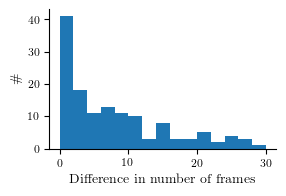

In [19]:
mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0.5, hspace=0.1)
ax = fig.add_subplot(grid[0,0])
ax.hist(list_length,bins=15)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Difference in number of frames')
ax.set_ylabel('$\#$')
plt.savefig('Results/histogram_135_to_425_lp184lgk974.pdf',bbox_inches = 'tight')
plt.show()

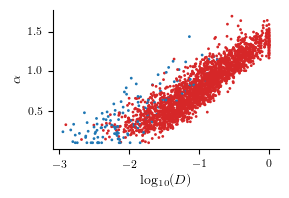

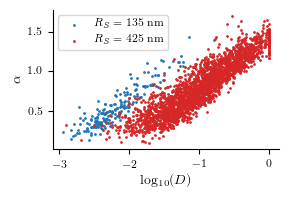

In [20]:
r2 = 0.5
labels1 = list(dflabel['Label'][(dflabel['Label']!='nan') | (dflabel['R2']>r2)].values)
rgb = ['tab:red' if x=='nan' else 'tab:blue' for x in labels1]
#rgb = ['#f9ab9d' if x=='nan' else 'tab:blue' if x=='slow_pop' else 'tab:orange' for x in labels1]
labelplot = ['No match' if x=='nan' else 'Slow population' if x=='slow_pop' else 'Fast population' for x in labels1]
D1 = list(dflabel['D'][(dflabel['Label']!='nan') | (dflabel['R2']>r2)].values)
alpha1 = list(dflabel['alpha'][(dflabel['Label']!='nan') | (dflabel['R2']>r2)].values)

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0.5, hspace=0.1)
ax = fig.add_subplot(grid[0,0])

ax.scatter(D1,alpha1,color=rgb,s=1,alpha=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel(r'log$_{10}(D)$')
ax.set_ylabel(r'$\alpha$')
plt.savefig('Results/scatter_425_id.pdf',bbox_inches = 'tight')
plt.show()

label135 = list(df135['Label'].values)
D425 = list(dflabel['D'][(dflabel['Label']=='nan') & (dflabel['R2']>r2)].values)
alpha425 = list(dflabel['alpha'][(dflabel['Label']=='nan') & (dflabel['R2']>r2)].values)
D135 = list(df135['D'].values)
alpha135 = list(df135['alpha'].values)

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0.5, hspace=0.1)
ax = fig.add_subplot(grid[0,0])
ax.scatter(D135,alpha135,color='tab:blue',s=1,alpha=1,label=r'$R_S = 135$ nm')
ax.scatter(D425,alpha425,color='tab:red',s=1,alpha=1,label=r'$R_S = 425$ nm')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel(r'log$_{10}(D)$')
ax.set_ylabel(r'$\alpha$')
ax.legend()
plt.savefig('Results/scatter_425and135_id.pdf',bbox_inches = 'tight')
plt.show()

# Save in `data_done` the tracks that have been classified and remove them from the dataset `data_stripped` in order to classify the other tracks now

In [21]:
data_done = dflabel[(dflabel['Label'] != 'nan')].copy()
index = dflabel[(dflabel['Label'] != 'nan')].index
temp = dflabel.copy()
data_stripped = temp.drop(index)

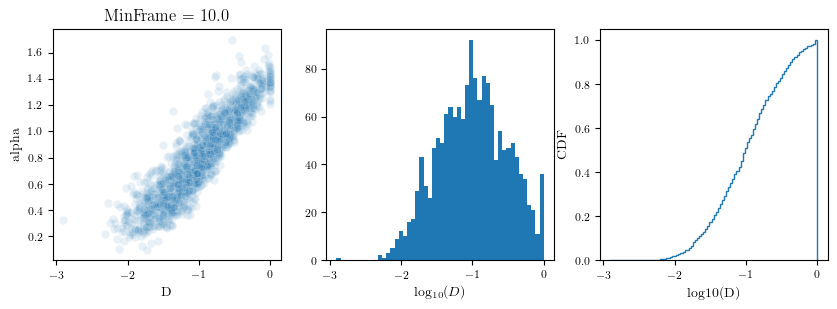

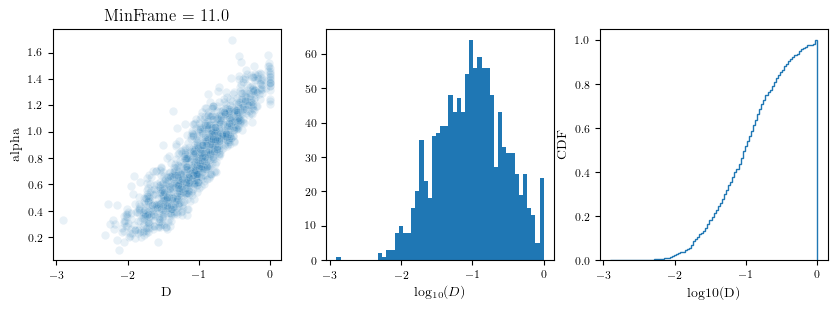

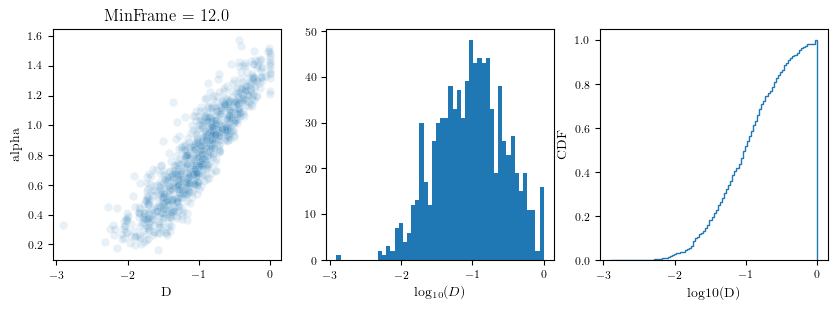

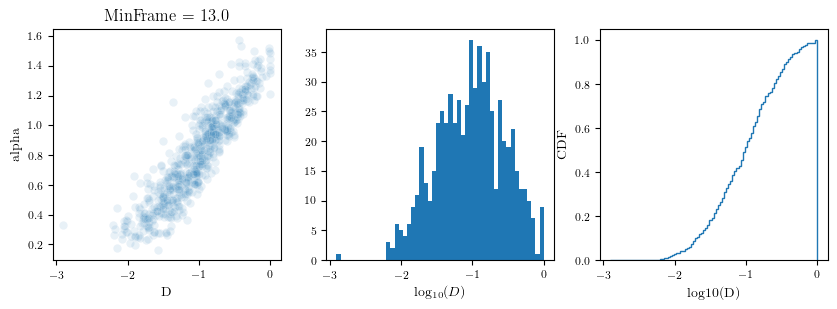

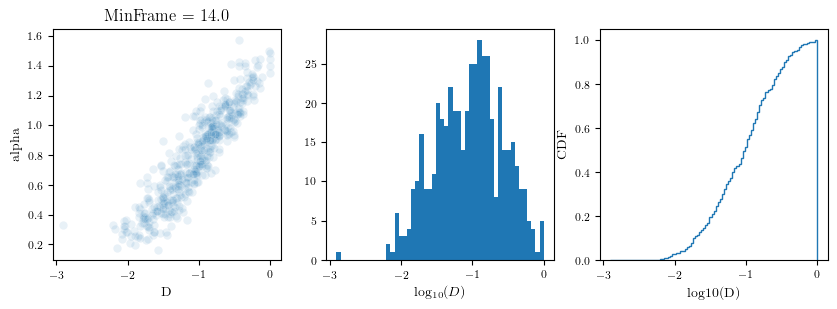

...

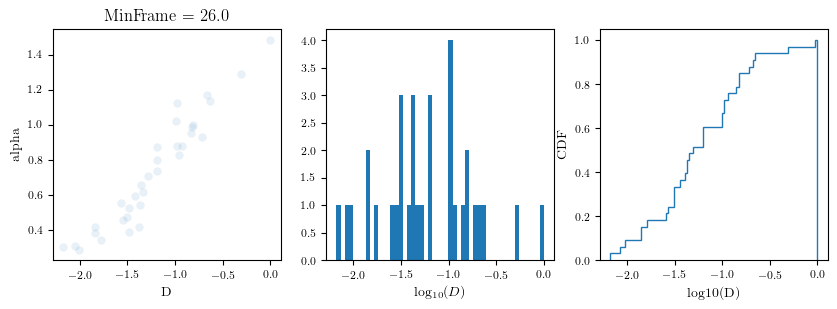

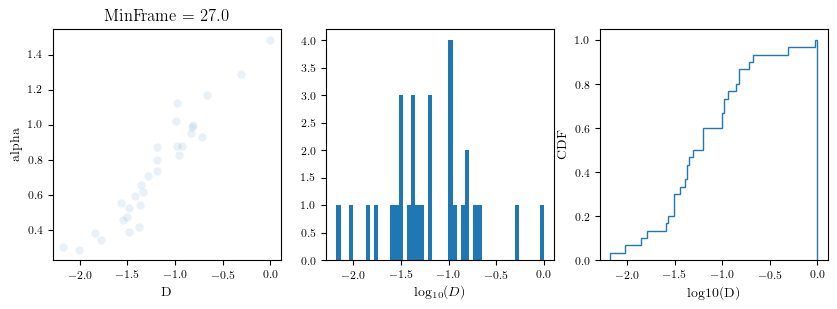

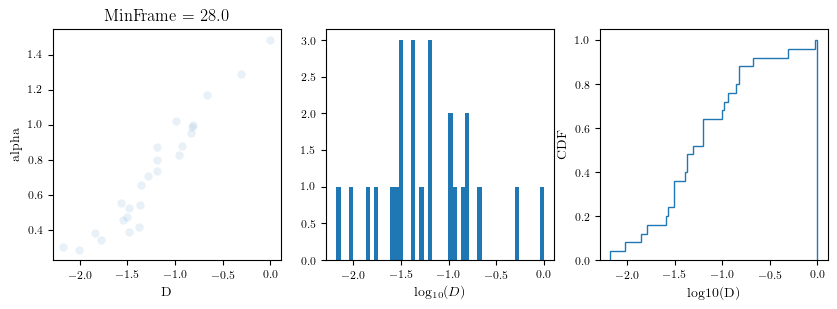

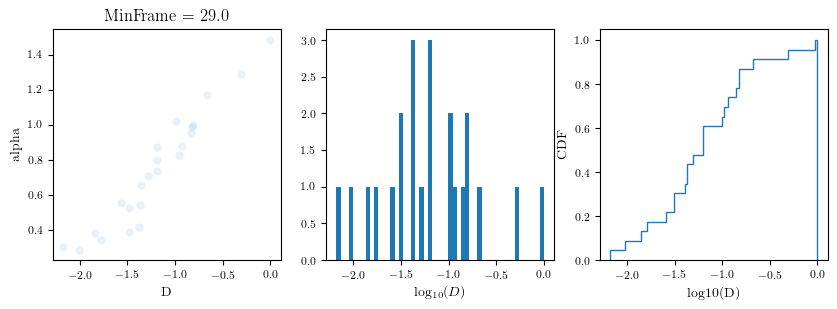

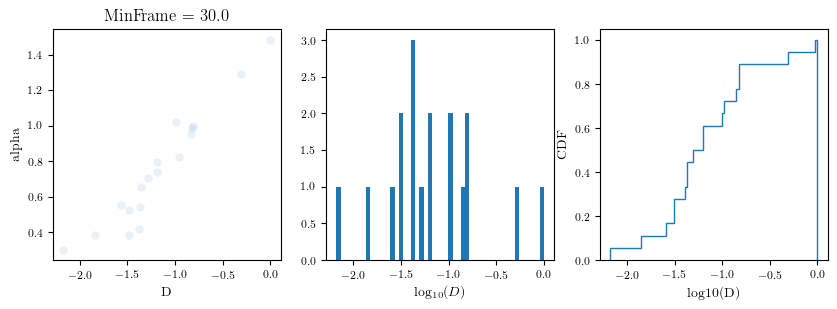

In [22]:
N = np.linspace(minframe,30,20)
for n in N:
    temp1 = data_stripped[(data_stripped['N']>n) & (data_stripped['R2']>0.5)]
    fig, ax = plt.subplots(1,3,figsize=(10,3))
    
    sns.scatterplot(x='D',y='alpha',data=temp1,ax=ax[0],alpha=0.1)
    ax[0].set_title('MinFrame = '+str(round(n)))
    
    ax[1].hist(temp1['D'],bins=50)
    ax[1].set_xlabel(r'log$_{10}(D)$')
    
    ax[2].hist(temp1['D'],bins=100,density=True, histtype='step',cumulative=True)
    ax[2].set_ylabel('CDF')
    ax[2].set_xlabel('log10(D)')

    plt.show()

In [23]:
data_stripped = data_stripped[(data_stripped['N']>=15) & (data_stripped['R2']>0.5)]
display(data_stripped)

,alpha,D,c,R2,N,x,y,MSD,Filename,spotIDs,Label
4,0.724081,-0.998765,0.115095,0.861864,15,"[57.49100000000001, 57.361000000000004, 57.443...","[41.443000000000005, 41.665, 41.802, 41.556999...","[0.05000271428571466, 0.07695492307692305, 0.0...",Data/SM1_INI/tracks425.csv,"[151027, 152267, 156216, 157449, 158770, 16008...",nan
11,0.951802,-0.823630,0.409642,0.671439,16,"[55.632, 55.585, 55.523, 55.528999999999996, 5...","[43.788999999999994, 43.701, 43.66399999999999...","[0.031180533333333618, 0.07674900000000023, 0....",Data/SM1_INI/tracks425.csv,"[151086, 152316, 156271, 157499, 158821, 16012...",nan
19,0.820461,-0.855957,0.204835,0.767652,19,"[30.854, 30.72, 30.79, 30.671, 30.718000000000...","[8.068999999999999, 8.387, 8.447000000000001, ...","[0.04906116666666654, 0.08086617647058807, 0.1...",Data/SM1_INI/tracks425.csv,"[150327, 151636, 155531, 156808, 158061, 15940...",nan
28,0.912545,-0.800791,0.239469,0.925646,15,"[66.715, 66.44, 66.15100000000001, 66.169, 66....","[6.797999999999999, 6.75, 6.822, 7.081, 7.0379...","[0.042284142857142264, 0.0783268461538453, 0.1...",Data/SM1_INI/tracks425.csv,"[158027, 159361, 160690, 163357, 162017, 16464...",nan
32,0.299562,-1.705747,0.202805,0.631523,19,"[64.346, 64.15100000000001, 64.17399999999999,...","[8.046, 8.117, 8.06, 8.105, 8.136000000000001,...","[0.028812999999999908, 0.04394458823529406, 0....",Data/SM1_INI/tracks425.csv,"[159403, 160729, 163383, 162044, 164667, 16595...",nan
...,...,...,...,...,...,...,...,...,...,...,...
4821,0.369358,-1.728516,0.092251,0.577111,20,"[49.985, 50.031000000000006, 49.94399999999999...","[64.34100000000001, 64.17, 64.327, 64.42399999...","[0.023466947368421046, 0.0339765555555551, 0.0...",Data/SM14_INI/tracks425.csv,"[6945462, 6947129, 6948792, 6950438, 6952059, ...",nan
4827,0.326156,-2.054011,0.078114,0.884266,22,"[53.321999999999996, 53.412, 53.25100000000000...","[51.498999999999995, 51.56100000000001, 51.479...","[0.01388604761904752, 0.014692250000000115, 0....",Data/SM14_INI/tracks425.csv,"[6963451, 6968489, 6970184, 6966849, 6965136, ...",nan
4843,1.033576,-0.777457,0.015781,0.933731,15,"[49.768, 49.857, 50.18600000000001, 50.218, 50...","[64.44, 64.407, 64.42399999999999, 64.345, 64....","[0.029531714285715275, 0.06414784615384668, 0....",Data/SM14_INI/tracks425.csv,"[7036793, 7041679, 7038460, 7040065, 7045058, ...",nan
4850,0.436507,-1.499571,0.138463,0.694311,23,"[53.278999999999996, 53.17100000000001, 52.843...","[51.464, 51.603, 51.675, 51.58, 51.38, 51.508,...","[0.032550863636363996, 0.04971361904761935, 0....",Data/SM14_INI/tracks425.csv,"[7066464, 7068151, 7063211, 7069837, 7064805, ...",nan


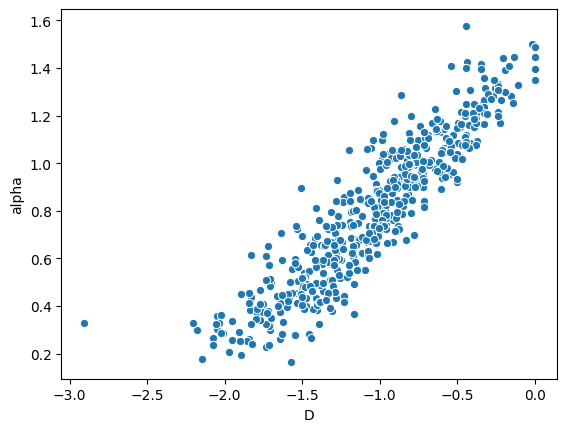

498


In [24]:
mpl.rcParams.update(mpl.rcParamsDefault)
sns.scatterplot(x='D',y='alpha',data=data_stripped)
plt.show()

MSD0 = list(data_stripped['MSD'].values)
print(len(MSD0))

#############################################
############## PROGRAM MICHALET #############
#############################################
Compute the TE-MSD and ensemble variance...
Number of T-MSDs at time lag  0.05  =  498
Number of T-MSDs at time lag  0.1  =  498
Number of T-MSDs at time lag  0.15  =  498
Number of T-MSDs at time lag  0.2  =  498
Number of T-MSDs at time lag  0.25  =  498
Number of T-MSDs at time lag  0.3  =  498
Number of T-MSDs at time lag  0.35  =  498
Number of T-MSDs at time lag  0.4  =  498
Number of T-MSDs at time lag  0.45  =  498
Number of T-MSDs at time lag  0.5  =  498
Number of T-MSDs at time lag  0.55  =  498
Number of T-MSDs at time lag  0.6  =  498
Number of T-MSDs at time lag  0.65  =  498
Number of T-MSDs at time lag  0.7  =  498
Number of T-MSDs at time lag  0.75  =  350
Number of T-MSDs at time lag  0.8  =  275
Number of T-MSDs at time lag  0.85  =  214
Number of T-MSDs at time lag  0.9  =  168
Number of T-MSDs at time lag  0.95  =  128
Number of 

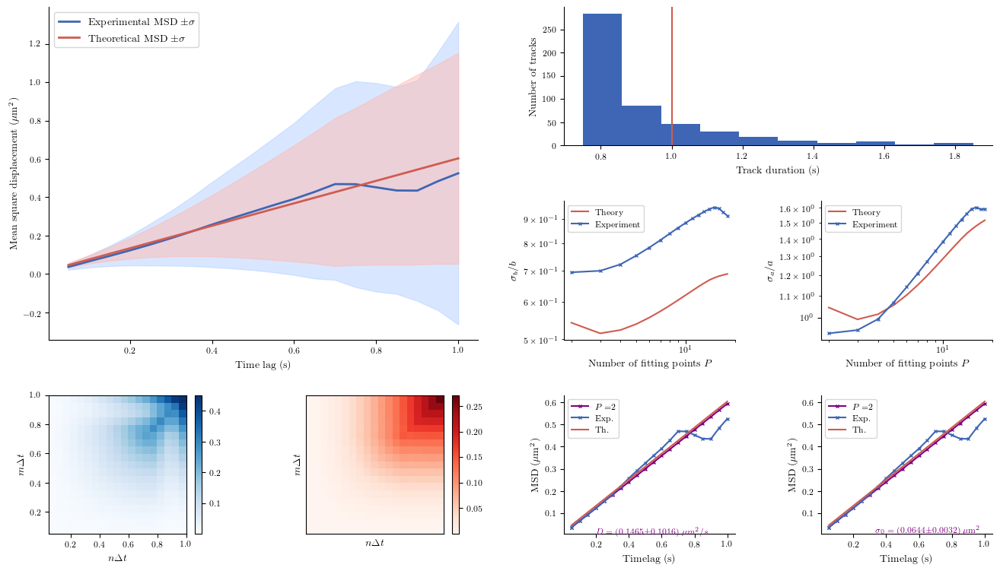

/home/remy13127/Documents/Internship/Functions/functions.py:1039: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


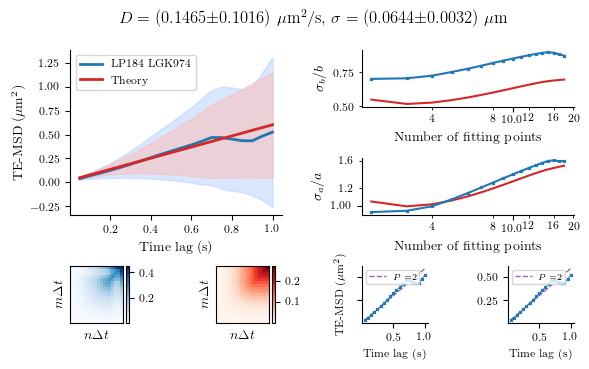

In [35]:
Michalet(MSD0,cutoff=1,experiment_name=r'LP184 LGK974')
plt.savefig('Results/michalet_lp184lgk974_rs425.pdf',bbox_inches = 'tight')
plt.show()

/home/remy13127/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


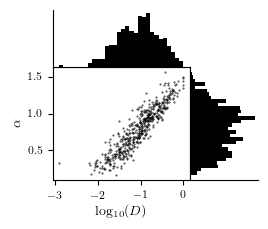

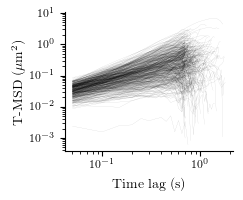

Compute the TE-MSD and ensemble variance...


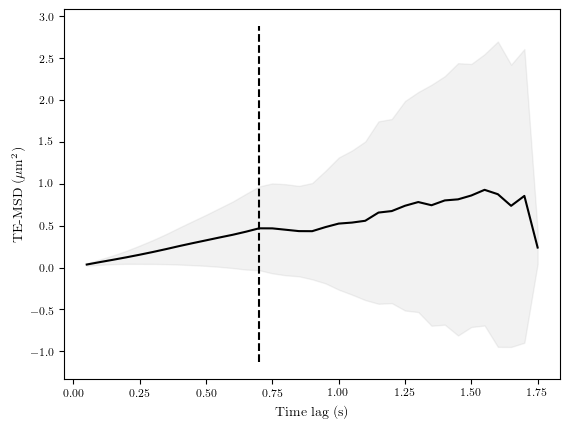

You have set a cutoff at  0.7  s...
Done. The TE-MSD and associated variance have been generated.


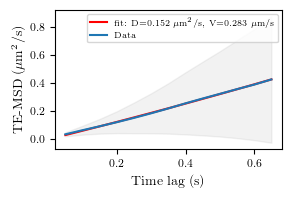

Compute the TE-MSD and ensemble variance...


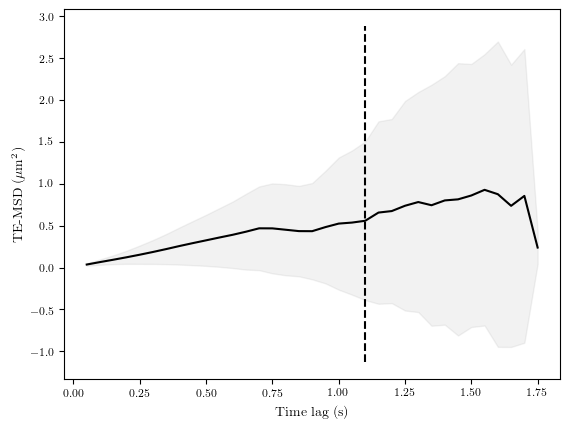

You have set a cutoff at  1.1  s...
Done. The TE-MSD and associated variance have been generated.
[0.03610655868259958, 0.06540300392773533, 0.09340028606097826, 0.12261236466165773, 0.15343158834482284, 0.18620705538980642, 0.22092692208508286, 0.2573273422487261, 0.291720417840301, 0.32500760015042446, 0.35857705366341336, 0.39103666743067367, 0.4278423884420608, 0.4684583283518372, 0.46778442345114774, 0.4514802553500373, 0.43508561055859724, 0.4343218478220901, 0.4830583392878268, 0.5248871578550244, 0.5369311317364721, 0.5585171126951299]


In [28]:
# the random data
logD = list(data_stripped['D'].values)
alpha = list(data_stripped['alpha'].values)
binsize=30

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.55))
grid = plt.GridSpec(3, 3, wspace=0., hspace=0.,right=0.7)
scatter = fig.add_subplot(grid[1:3, 0:2])
hist_logD = fig.add_subplot(grid[0,0:2],yticks=[],xticks=[])
hist_alpha = fig.add_subplot(grid[1:3,2],yticks=[],xticks=[])

scatter.scatter(logD,alpha,s=0.2,c='k',alpha=0.8)
scatter.set_xlabel(r'log$_{10}(D)$')
scatter.set_ylabel(r'$\alpha$')

hist_logD.hist(logD,bins=binsize,color='k')
hist_logD.spines['top'].set_visible(False)
hist_logD.spines['right'].set_visible(False)


hist_alpha.hist(alpha,bins=binsize,color='k',orientation='horizontal')
hist_alpha.spines['top'].set_visible(False)
hist_alpha.spines['right'].set_visible(False)

plt.tight_layout()
plt.savefig('Results/scatter_rs425_lp184lgk974.pdf',bbox_inches = 'tight')
plt.show()

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0., hspace=0.,right=0.7)
ax = fig.add_subplot(grid[0,0])
MSDSeries = list(data_stripped['MSD'].values)
for msd in MSDSeries:
    timelag = np.linspace(dt,len(msd)*dt,len(msd))
    ax.plot(timelag,msd,c='k',alpha=0.3,linewidth=0.1)
ax.set_xscale('log')
ax.set_yscale('log')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Time lag (s)')
ax.set_ylabel(r'T-MSD ($\mu$m$^2$)')
plt.savefig('Results/msd_rs425_lp184lgk974.pdf',bbox_inches = 'tight')
plt.show()

MSDtot = list(data_stripped['MSD'].values)
temsdtot,vartot,timelagtot = TE_MSD(MSDtot,cutoff=0.70,plot=True)

from scipy.optimize import curve_fit
def drift_model(timelag, D, V):
    return(4*D*timelag+(V**2)*(timelag**2))

popt, pcov = curve_fit(drift_model, timelagtot, temsdtot)

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0.8, hspace=0.8)
ax = fig.add_subplot(grid[0,0])
ax.plot(timelagtot, drift_model(timelagtot, *popt), 'r-',label=r'fit: D=%5.3f $\mu$m$^2/$s, V=%5.3f $\mu$m/s' % tuple(popt))
ax.plot(timelagtot,temsdtot,label='Data')
ax.fill_between(timelagtot,[msd+np.sqrt(var) for msd,var in zip(temsdtot,vartot)], [msd-np.sqrt(var) for msd,var in zip(temsdtot,vartot)],color='gray',alpha=0.1)
#ax.set_xlim(0.05,30)
ax.set_xlabel('Time lag (s)')
ax.set_ylabel(r'TE-MSD ($\mu$m$^2/$s)')
plt.legend(fontsize=6)
#fig.savefig('Drift/Plots/drift_movie_ensemble_msd_fit.pdf', format='pdf', bbox_inches='tight')
plt.show()
#Michalet(MSDfast,cutoff=1) #CAREFUL THIS IS SLOW DUE TO THE VERY LONG TRACKS

MSDtot = list(data_stripped['MSD'].values)
temsd,var,timelag = TE_MSD(MSDtot,cutoff=1.1,plot=True)
print(temsd)

Compute the TE-MSD and ensemble variance...
You have set a cutoff at  2  s...
Done. The TE-MSD and associated variance have been generated.
Compute the TE-MSD and ensemble variance...
You have set a cutoff at  2  s...
Done. The TE-MSD and associated variance have been generated.
Compute the TE-MSD and ensemble variance...
You have set a cutoff at  2  s...
Done. The TE-MSD and associated variance have been generated.
Compute the TE-MSD and ensemble variance...
You have set a cutoff at  2  s...
Done. The TE-MSD and associated variance have been generated.
Compute the TE-MSD and ensemble variance...
You have set a cutoff at  2  s...
Done. The TE-MSD and associated variance have been generated.
Compute the TE-MSD and ensemble variance...
You have set a cutoff at  2  s...
Done. The TE-MSD and associated variance have been generated.


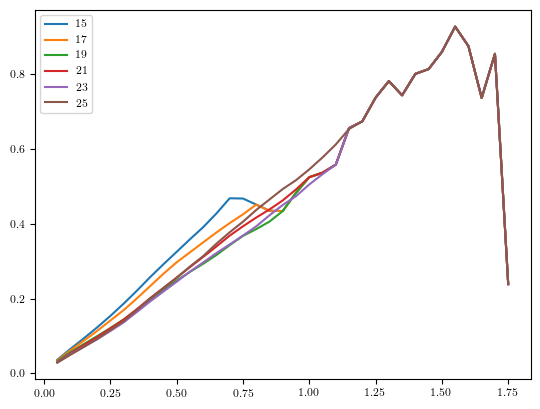

In [37]:
Narray = [15,17,19,21,23,25]
for N in Narray:
    MSDtot = list(data_stripped['MSD'][(data_stripped['N']>=N)].values)
    temsd,var,timelag = TE_MSD(MSDtot,cutoff=2,plot=False)
    plt.plot(timelag,temsd,label=str(N))
plt.legend()
plt.show()

#############################################
############## PROGRAM MICHALET #############
#############################################
Compute the TE-MSD and ensemble variance...
Number of T-MSDs at time lag  0.05  =  498
Number of T-MSDs at time lag  0.1  =  498
Number of T-MSDs at time lag  0.15  =  498
Number of T-MSDs at time lag  0.2  =  498
Number of T-MSDs at time lag  0.25  =  498
Number of T-MSDs at time lag  0.3  =  498
Number of T-MSDs at time lag  0.35  =  498
Number of T-MSDs at time lag  0.4  =  498
Number of T-MSDs at time lag  0.45  =  498
Number of T-MSDs at time lag  0.5  =  498
Number of T-MSDs at time lag  0.55  =  498
Number of T-MSDs at time lag  0.6  =  498
Number of T-MSDs at time lag  0.65  =  498
Number of T-MSDs at time lag  0.7  =  498
Number of T-MSDs at time lag  0.75  =  350
Number of T-MSDs at time lag  0.8  =  275
Number of T-MSDs at time lag  0.85  =  214
Number of T-MSDs at time lag  0.9  =  168
Number of T-MSDs at time lag  0.95  =  128
Number of 

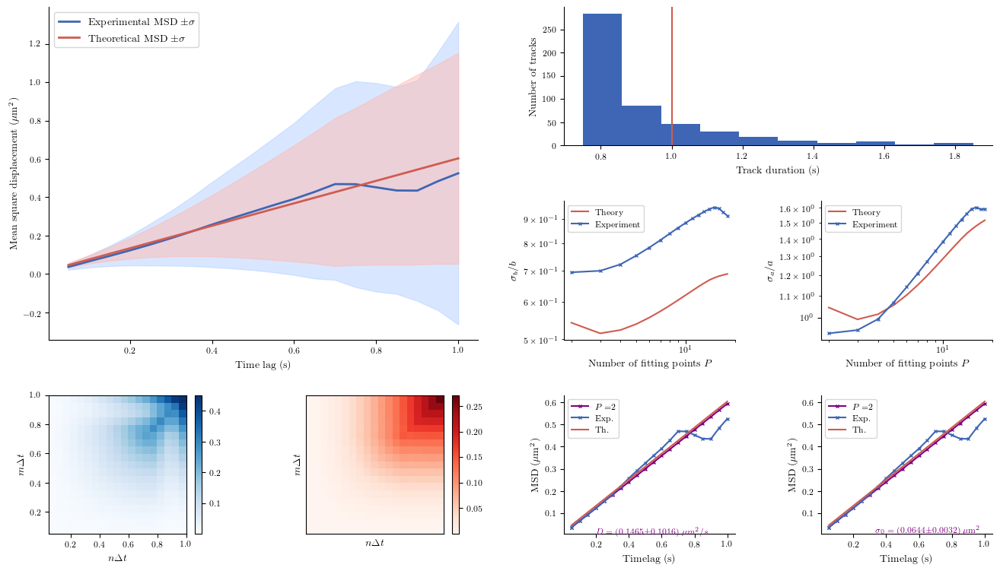

/home/remy13127/Documents/Internship/Functions/functions.py:1039: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


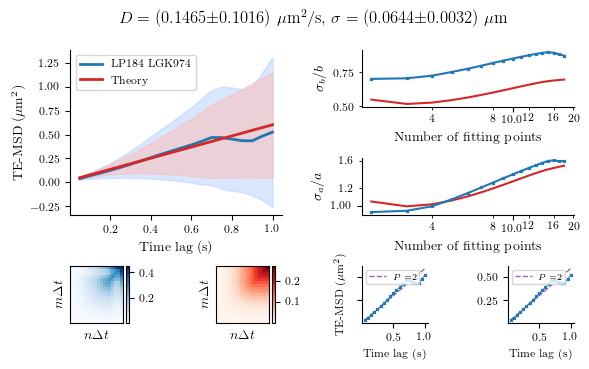

In [43]:
MSD0 = list(data_stripped['MSD'][(data_stripped['N']>=15)].values)
Michalet(MSD0,cutoff=1,experiment_name=r'LP184 LGK974')
#plt.savefig('Results/michalet_lp184lgk974_rs425.pdf',bbox_inches = 'tight')
plt.show()

30 30
[0.12007706]


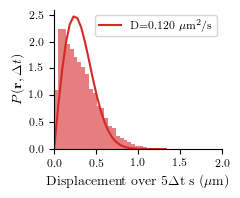

In [58]:
Xtot = list(data_stripped['x'].values)
Ytot = list(data_stripped['y'].values)


def plot_dist(X,Y,n,binsize=30,color='tab:blue'):
    displacements = []
    epsilon=0.
    s = 0
    for x,y in zip(X,Y):
        for i in range(0,len(x)-n):
            disp = np.sqrt((x[n+i] - x[i])**2 + (y[n+i] - y[i])**2)
            displacements.append(disp)

    from scipy.optimize import curve_fit
    def prob(d,D):
        timelag=dt*n
        return(2*d/(4*D*timelag+epsilon)*np.exp(-d**2/(4*D*timelag+epsilon)))

    histo,bins = np.histogram(displacements,bins=binsize,density=True)
    print(len(histo),len(bins[:-1]))
    popt, pcov = curve_fit(prob, bins[:-1], histo)
    print(popt)
    plt.plot(bins[:-1], prob(bins[:-1], *popt), 'r-',label=r'D=%5.3f $\mu$m$^2/$s' % tuple(popt),c=color)
    plt.hist(displacements,bins=binsize,density=True,color=color,alpha=0.6)

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0., hspace=0.,right=0.7)
ax = fig.add_subplot(grid[0,0])
n=5
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plot_dist(Xtot,Ytot,n,color='tab:red',binsize=30)
ax.set_xlabel(r'Displacement over '+str(n)+'$\Delta$t s ($\mu$m)')
ax.set_ylabel(r'$P(\mathbf{r},\Delta t)$')
ax.set_xlim(0,2)
ax.legend()
plt.savefig('Results/lp184lgk974_rs425_displacement'+str(n)+'.pdf',bbox_inches = 'tight')
plt.show()

In [ ]:
Xtot = list(data_stripped['x'].values)
Ytot = list(data_stripped['y'].values)

def plot_dist(X,Y,n,binsize=30,color='tab:blue'):
    displacements = []
    epsilon=0.
    s = 0
    for x,y in zip(X,Y):
        for i in range(0,len(x)-n):
            disp = np.sqrt((x[n+i] - x[i])**2 + (y[n+i] - y[i])**2)
            displacements.append(disp)

    from scipy.optimize import curve_fit
    def prob(d,D):
        timelag=dt*n
        return(2*d/(4*D*timelag+epsilon)*np.exp(-d**2/(4*D*timelag+epsilon)))

    histo,bins = np.histogram(displacements,bins=binsize,density=True)
    print(len(histo),len(bins[:-1]))
    popt, pcov = curve_fit(prob, bins[:-1], histo)
    print(popt)
    plt.plot(bins[:-1], prob(bins[:-1], *popt), 'r-',label=r'D=%5.3f $\mu$m$^2/$s' % tuple(popt),c=color)
    plt.hist(displacements,bins=binsize,density=True,color=color,alpha=0.6)

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0., hspace=0.,right=0.7)
ax = fig.add_subplot(grid[0,0])
n=5
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plot_dist(Xtot,Ytot,n,color='tab:red')
ax.set_xlabel(r'Displacement over '+str(n)+'$\Delta$t s ($\mu$m)')
ax.set_ylabel(r'$P(\mathbf{r},\Delta t)$')
ax.legend()
plt.show()

In [ ]:
alpha = list(data_stripped['alpha'].values)
dlist = list(data_stripped['D'].values)
X = list(data_stripped['x'].values)
Y = list(data_stripped['y'].values)
plt.hist(alpha,bins=50)
plt.show()
plt.hist(dlist,bins=50)
plt.show()

MSD0 = list(data_stripped['MSD'].values)
index0 = data_stripped.index
for i in range(len(index0)):
    #print(df135.iloc[i])
    print("position in list = ",i," index in df = ",data_stripped.index[i])
    for msd in MSD0:
        timelag = np.linspace(dt,len(msd)*dt,len(msd))
        plt.plot(timelag,msd,c='k',alpha=0.1,linewidth=1)
    msd = MSD0[i]
    timelag = np.linspace(dt,len(msd)*dt,len(msd))
    plt.plot(timelag,msd,c='red',linewidth=3)
    plt.xscale('log')
    plt.yscale('log')
    plt.show()
    x = X[i]
    y = Y[i]
    plt.plot(x,y)
    plt.axis('equal')
    plt.show()


In [ ]:
remove = [9,25,32,76,102,105,109,121,124,256,276,288,301,304,305,321,342,344,347,368,386,449,454,471,472,493,511,530,565,568,596,606,611,620,628,647,692]
data_stripped = data_stripped.drop(data_stripped.index[remove])
display(data_stripped.describe())

In [ ]:
index_fast = list(data_stripped[(data_stripped['alpha']>=0.6)].index)
index_slow = list(data_stripped[(data_stripped['alpha']<0.6)].index)
print(index_fast,index_slow)

MSDfast = [data_stripped['MSD'].loc[i] for i in index_fast]
temsdfast,varfast,timelagfast = TE_MSD(MSDfast,cutoff=0.3)

MSDslow = [data_stripped['MSD'].loc[i] for i in index_slow]
temsdslow,varslow,timelagslow = TE_MSD(MSDslow,cutoff=0.45)

for msd in MSDfast:
    timelag = np.linspace(dt,len(msd)*dt,len(msd))
    plt.plot(timelag,msd,c='tab:orange',alpha=0.5)
for msd in MSDslow:
    timelag = np.linspace(dt,len(msd)*dt,len(msd))
    plt.plot(timelag,msd,c='tab:blue',alpha=0.2)
plt.xscale('log')
plt.yscale('log')
plt.show()

In [ ]:
alphaslow = [data_stripped['alpha'].loc[i] for i in index_slow]
Dslow = [data_stripped['D'].loc[i] for i in index_slow]
alphafast = [data_stripped['alpha'].loc[i] for i in index_fast]
Dfast = [data_stripped['D'].loc[i] for i in index_fast]
plt.scatter(Dslow,alphaslow,c='red')
plt.scatter(Dfast,alphafast,c='b')
plt.show()

Michalet(MSDslow,cutoff=0.7)
plt.show()

Michalet(MSDfast,cutoff=0.95)
plt.show()

In [ ]:
temsd,var,timelag = TE_MSD(MSDfast,cutoff=0.6)

from scipy.optimize import curve_fit

def drift_model(timelag, D, V):
    return(4*D*timelag+(V**2)*(timelag**2))

popt, pcov = curve_fit(drift_model, timelag, temsd)

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0.8, hspace=0.8)
ax = fig.add_subplot(grid[0,0])
ax.plot(timelag, drift_model(timelag, *popt), 'r-',label=r'fit: D=%5.3f $\mu$m$^2/$s, V=%5.3f $\mu$m/s' % tuple(popt))
ax.plot(timelag,temsd,label='Data')
ax.fill_between(timelag,[msd+np.sqrt(var) for msd,var in zip(temsd,var)], [msd-np.sqrt(var) for msd,var in zip(temsd,var)],color='gray',alpha=0.1)
#ax.set_xlim(0.05,30)
ax.set_xlabel('Time lag (s)')
ax.set_ylabel(r'TE-MSD ($\mu$m$^2/$s)')
plt.legend(fontsize=6)
#fig.savefig('Drift/Plots/drift_movie_ensemble_msd_fit.pdf', format='pdf', bbox_inches='tight')
plt.show()
#Michalet(MSDfast,cutoff=1) #CAREFUL THIS IS SLOW DUE TO THE VERY LONG TRACKS


# OLD STUFF

In [ ]:
data_stripped = data_stripped[(data_stripped['N']>=15) & (data_stripped['R2']>0.5)]

from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import *

temp = data_stripped[['c','alpha','D']].values
scaler = PowerTransformer()
scaler.fit(temp)
temp_scaled = scaler.transform(temp)

gmm = GaussianMixture(n_components=1,max_iter=500,covariance_type='full',tol=1.0E-10,reg_covar=1.0E-10,init_params='random',n_init=500)
gmm.fit(temp_scaled)
proba_lists = gmm.predict_proba(temp_scaled)

colored_arrays = np.matrix(proba_lists)
colored_tuples = [tuple(i.tolist()[0]) for i in colored_arrays]
colorlist = [np.argmax(x) for x in colored_tuples]
data_stripped['GM_Label']=colorlist

In [ ]:
mpl.rcParams.update(mpl.rcParamsDefault)
sns.scatterplot(x='D',y='alpha',hue='GM_Label',data=data_stripped)
plt.show()

sns.scatterplot(x='c',y='alpha',hue='GM_Label',data=data_stripped)
plt.show()

In [ ]:
X = list(data_stripped['x'][(data_stripped['GM_Label']==3)|(data_stripped['GM_Label']==0)].values)
Y = list(data_stripped['y'][(data_stripped['GM_Label']==3)|(data_stripped['GM_Label']==0)].values)

n = 10
displacements = []
epsilon=0.
binsize=50
s = 0
for x,y in zip(X,Y):
    for i in range(0,len(x)-n):
        disp = np.sqrt((x[n+i] - x[i])**2 + (y[n+i] - y[i])**2)
        displacements.append(disp)
 
from scipy.optimize import curve_fit
def prob(d,D):
    timelag=dt*n
    return(2*d/(4*D*timelag+epsilon)*np.exp(-d**2/(4*D*timelag+epsilon)))

histo,bins = np.histogram(displacements,bins=binsize,density=True)
print(len(histo),len(bins[:-1]))
popt, pcov = curve_fit(prob, bins[:-1], histo)
print(popt)
plt.plot(bins[:-1], prob(bins[:-1], *popt), 'r-',label='fit: a=%5.3f' % tuple(popt))
plt.hist(displacements,bins=binsize,density=True)
plt.show()

In [ ]:
MSD0 = list(data_stripped['MSD'][(data_stripped['GM_Label']==0)])
MSD1 = list(data_stripped['MSD'][(data_stripped['GM_Label']==1)])
MSD2 = list(data_stripped['MSD'][(data_stripped['GM_Label']==2)])
MSD3 = list(data_stripped['MSD'][(data_stripped['GM_Label']==3)])

temsd0,var0,timelag0 = TE_MSD(MSD0,cutoff=0.75)
temsd1,var1,timelag1 = TE_MSD(MSD1,cutoff=0.75)
temsd2,var2,timelag2 = TE_MSD(MSD2,cutoff=0.6)
temsd3,var3,timelag3 = TE_MSD(MSD3,cutoff=0.75)


plt.plot(timelag0,temsd0)
plt.plot(timelag1,temsd1)
plt.plot(timelag2,temsd2)
plt.plot(timelag3,temsd3)
#plt.xscale('log')
#plt.yscale('log')
plt.show()

In [ ]:
X1,Y1 = list(data_stripped['x'][(data_stripped['GM_Label']==1)].values),list(data_stripped['y'][(data_stripped['GM_Label']==1)].values)
for x,y in zip(X1,Y1):
    plt.plot(x,y,c='k',linewidth=0.1)
X2,Y2 = list(data_stripped['x'][(data_stripped['GM_Label']==2)].values),list(data_stripped['y'][(data_stripped['GM_Label']==2)].values)
for x,y in zip(X2,Y2):
    plt.plot(x,y,c='red',linewidth=0.1)
X3,Y3 = list(data_stripped['x'][(data_stripped['GM_Label']==0)].values),list(data_stripped['y'][(data_stripped['GM_Label']==0)].values)
for x,y in zip(X3,Y3):
    plt.plot(x,y,c='blue',linewidth=0.1)
    
X4,Y4 = list(data_stripped['x'][(data_stripped['GM_Label']==3)].values),list(data_stripped['y'][(data_stripped['GM_Label']==3)].values)
for x,y in zip(X4,Y4):
    plt.plot(x,y,c='orange',linewidth=0.1)
    
X5,Y5 = list(data_stripped['x'][(data_stripped['GM_Label']==4)].values),list(data_stripped['y'][(data_stripped['GM_Label']==4)].values)
for x,y in zip(X5,Y5):
    plt.plot(x,y,c='green',linewidth=0.1)
    
plt.axis('equal')
plt.savefig('test.pdf',dpi=1200)
plt.show()

In [ ]:
#Try to determine automatically the index for the confined group CAREFUL NEED TO SET BY HAND THE LABEL FOR FAST POPULATION
index = [0,1,2,3]
D_per_group = []
for indx in index:
    Dmean = data_stripped['D'][(data_stripped['GM_Label']==indx)].mean()
    D_per_group.append(Dmean)

index_confined = D_per_group.index(min(D_per_group))
labels_GM = list(data_stripped['GM_Label'].values)
#labels = ['fast_pop' if x==0 else 'transport' if x==3 else 'slow_pop' if x==2 else 'nan' for x in labels_GM]
labels = ['transport' if x==3 else 'rs_425' for x in labels_GM]
data_stripped['Label']=labels

In [ ]:
#display(data_stripped)

In [ ]:
frames = [data_done, data_stripped[(data_stripped['Label'] != 'nan')]]
result = pd.concat(frames)
#display(result)

In [ ]:
mpl.rcParams.update(mpl.rcParamsDefault)
sns.scatterplot(x='D',y='alpha',hue='Label',data=result)
plt.show()

sns.scatterplot(x='c',y='alpha',hue='Label',data=result)
plt.show()

sns.scatterplot(x='D',y='c',hue='Label',data=result)
plt.show()

In [ ]:
MSDtransport = list(result['MSD'][(result['Label']=='transport')].values)
temsd,var,timelag = TE_MSD(MSDtransport,cutoff=1)

from scipy.optimize import curve_fit

def drift_model(timelag, D, V):
    return(4*D*timelag+(V**2)*(timelag**2))

popt, pcov = curve_fit(drift_model, timelag, temsd)

mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('tex')
width = 469.75502
fig= plt.figure(figsize=set_size(width, fraction=0.45))
grid = plt.GridSpec(1, 1, wspace=0.8, hspace=0.8)
ax = fig.add_subplot(grid[0,0])
ax.plot(timelag, drift_model(timelag, *popt), 'r-',label=r'fit: D=%5.3f $\mu$m$^2/$s, V=%5.3f $\mu$m/s' % tuple(popt))
ax.plot(timelag,temsd,label='Data')
ax.fill_between(timelag,[msd+np.sqrt(var) for msd,var in zip(temsd,var)], [msd-np.sqrt(var) for msd,var in zip(temsd,var)],color='gray',alpha=0.1)
#ax.set_xlim(0.05,30)
ax.set_xlabel('Time lag (s)')
ax.set_ylabel(r'TE-MSD ($\mu$m$^2/$s)')
plt.legend(fontsize=6)
#fig.savefig('Drift/Plots/drift_movie_ensemble_msd_fit.pdf', format='pdf', bbox_inches='tight')
plt.show()
#Michalet(MSDfast,cutoff=1) #CAREFUL THIS IS SLOW DUE TO THE VERY LONG TRACKS


In [ ]:
MSDfast = list(result['MSD'][(result['Label']=='fast_pop')].values)
temsd,var,timelag = TE_MSD(MSDfast,cutoff=0.5)
Michalet(MSDfast,cutoff=1)

In [ ]:
MSDfast = list(result['MSD'][(result['Label']=='slow_pop')].values)
temsd,var,timelag = TE_MSD(MSDfast,cutoff=1)
Michalet(MSDfast,cutoff=1)